## Project - 3D Image Reconstruction.

In [1]:
import cv2
import numpy as np
import cupy as cp
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from pathlib import Path
import json
import h5py
from datetime import datetime
from tqdm import tqdm
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from concurrent.futures import ThreadPoolExecutor
import logging
from typing import Dict, List, Tuple, Optional


# Start of Part 1, 2, 3 --------------------------------------------------------------------------------------------------------------------

# Setup logging
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# ------------------------------------------------------------------------------------------------------------------------------------------

# ; setup runs first in main and this def is present outside all classes. 
def setup_gpu_processing() -> Dict:
    """
    Enhanced GPU setup and verification for the preprocessing pipeline.
    Returns a configuration dictionary with GPU capabilities and settings.
    """
    gpu_config = { 'torch_cuda': False, 'opencv_cuda': False, 'cuda_sift': False, 'device': 'cpu', 'gpu_info': None, 'memory_info': None }
    
    # Check PyTorch CUDA
    if torch.cuda.is_available():
        gpu_config['torch_cuda'] = True
        gpu_config['device'] = 'cuda'
        gpu_config['gpu_info'] = torch.cuda.get_device_name(0)
        
        # Setup CUDA optimizations
        torch.backends.cudnn.benchmark = True
        torch.set_default_tensor_type('torch.cuda.FloatTensor')
        
        # Get memory info
        total_memory = torch.cuda.get_device_properties(0).total_memory / 1024**2
        allocated_memory = torch.cuda.memory_allocated(0) / 1024**2
        gpu_config['memory_info'] = {
            'total': f"{total_memory:.2f}MB",
            'allocated': f"{allocated_memory:.2f}MB"
        }
        
        # Test PyTorch CUDA computation
        try:
            test_tensor = torch.rand(100, 100).cuda()
            test_result = torch.mm(test_tensor, test_tensor)
            del test_tensor, test_result
            torch.cuda.empty_cache()
            logger.info("PyTorch CUDA computation test: SUCCESS")
        except Exception as e:
            logger.error(f"PyTorch CUDA computation test failed: {e}")
    
    # Check OpenCV CUDA
    try:
        if cv2.cuda.getCudaEnabledDeviceCount() > 0:
            gpu_config['opencv_cuda'] = True
            
            # Test OpenCV CUDA
            test_img = np.random.randint(0, 255, (100, 100), dtype=np.uint8)
            gpu_mat = cv2.cuda_GpuMat()
            gpu_mat.upload(test_img)
            result = cv2.cuda.subtract(gpu_mat, gpu_mat)
            result.download()
            logger.info("OpenCV CUDA computation test: SUCCESS")
            
            # Test CUDA SIFT
            try:
                sift = cv2.cuda.SIFT_create()
                gpu_config['cuda_sift'] = True
                logger.info("CUDA SIFT available")
            except Exception:
                logger.warning("CUDA SIFT not available, will use CPU SIFT")
                
    except Exception as e:
        logger.warning(f"OpenCV CUDA not available: {e}")
    
    # Log configuration
    logger.info("\nGPU Configuration Summary:")
    logger.info(f"PyTorch CUDA available: {gpu_config['torch_cuda']}")
    logger.info(f"OpenCV CUDA available: {gpu_config['opencv_cuda']}")
    logger.info(f"CUDA SIFT available: {gpu_config['cuda_sift']}")
    if gpu_config['gpu_info']:
        logger.info(f"GPU: {gpu_config['gpu_info']}")
        logger.info(f"Total GPU Memory: {gpu_config['memory_info']['total']}")
        logger.info(f"Currently Allocated: {gpu_config['memory_info']['allocated']}")
    
    return gpu_config



# ------------------------------------------------------------------------------------------------------------------------------------------

class ImageDataset(Dataset):
    
    """PyTorch Dataset for batch processing of images""" # .. optional pose information
    def __init__(self, image_paths: List[Path], camera_poses: Optional[Dict] = None):
        
        # ensure paths are Path objects
        self.image_paths = [Path(p) if not isinstance(p, Path) else p for p in image_paths]
        self.camera_poses = camera_poses or {}  # Store poses if provided

        self.reference_size = self._get_reference_size()
        logger.info(f"Reference size set to: {self.reference_size}")

        # validate paths
        for path in self.image_paths:
            if not path.exists():
                raise FileNotFoundError(f"Image path does not exist: {path}")

        # Precompute pose-based relationships if poses are available
        if camera_poses:
            self.pose_distances = self._compute_pose_distances()
            self.view_overlaps = self._compute_view_overlaps()
        else:
            self.pose_distances = {}
            self.view_overlaps = {}

    
    def __len__(self) -> int:
        return len(self.image_paths)


    def _get_reference_size(self) -> Tuple[int, int]:
        """Get most common image size as reference"""
        sizes = []
        for path in self.image_paths:
            img = cv2.imread(str(path))
            sizes.append((img.shape[1], img.shape[0]))  # (width, height)
        
        from collections import Counter
        common_size = Counter(sizes).most_common(1)[0][0]      # Get most common size
        return common_size

    def __getitem__(self, idx: int) -> torch.Tensor:
        img_path = self.image_paths[idx]              # get path.
        img = cv2.imread(str(img_path))               # load and check image.
        if img is None:
            raise ValueError(f"Failed to load image at path: {img_path}")

        # Only resize if size differs from reference
        h, w = img.shape[:2]
        ref_w, ref_h = self.reference_size
        if (w, h) != self.reference_size:
            logger.debug(f"Adjusting image {img_path.name} from {w}x{h} to {ref_w}x{ref_h}")
            img = cv2.resize(img, self.reference_size, interpolation=cv2.INTER_AREA)

        # to float32 and normalize to [0,1]
        img = img.astype(np.float32) / 255.0
        return torch.from_numpy(img).permute(2, 0, 1)

    
    def get_pose_info(self, idx1: int, idx2: int) -> Dict:
        """Get pose relationship information for image pair"""
        img1, img2 = self.image_paths[idx1].name, self.image_paths[idx2].name
        return {
            'distance': self.pose_distances.get((img1, img2), float('inf')),
            'overlap': self.view_overlaps.get((img1, img2), 0.0)
        }
        
    def _compute_pose_distances(self) -> Dict[Tuple[str, str], float]:
        """Precompute distances between camera positions"""
        distances = {}
        for img1, pose1 in self.camera_poses.items():
            for img2, pose2 in self.camera_poses.items():
                if img1 != img2:
                    pos1 = np.array(pose1['position'])
                    pos2 = np.array(pose2['position'])
                    distances[(img1, img2)] = np.linalg.norm(pos1 - pos2)
        return distances

    def _compute_view_overlaps(self) -> Dict[Tuple[str, str], float]:
        """Precompute view frustum overlaps - basic implementation"""
        overlaps = {}
        for img1, pose1 in self.camera_poses.items():
            for img2, pose2 in self.camera_poses.items():
                if img1 != img2:
                    overlaps[(img1, img2)] = self._compute_single_overlap(pose1, pose2)
        return overlaps
    
    def _compute_single_overlap(self, pose1: Dict, pose2: Dict) -> float:
        """Compute overlap between two views - basic implementation"""
        pos1, pos2 = np.array(pose1['position']), np.array(pose2['position'])
        dir1 = self._quaternion_to_direction(pose1['quaternion'])
        dir2 = self._quaternion_to_direction(pose2['quaternion'])
        
        # Basic overlap score based on viewing directions
        angle = np.arccos(np.clip(np.dot(dir1, dir2), -1.0, 1.0))
        return max(0.0, 1.0 - angle / np.pi)
    
    @staticmethod
    def _quaternion_to_direction(q: np.ndarray) -> np.ndarray:
        """Convert quaternion to view direction vector"""
        w, x, y, z = q
        direction = np.array([
            2 * (x*z + w*y),
            2 * (y*z - w*x),
            1 - 2 * (x*x + y*y)
        ])
        return direction / np.linalg.norm(direction)
        
# -----------------------------------------------------------------------------------------------------------------------------------------

In [2]:
""" GPU tackling part 1: As much as we can !!
Color space conversions are computationally intensive, Denoising is a heavy operation that benefits from GPU acceleration
Keeping operations on GPU avoids CPU-GPU transfer overhead.
"""

import cv2
import numpy as np
import torch
import cupy as cp
import logging
from typing import Dict, List, Tuple, Optional
from tqdm import tqdm
from contextlib import nullcontext


logger = logging.getLogger(__name__)

class GPUAcceleratedPreprocessor:
    """
    Handles image preprocessing with PyTorch GPU acceleration where possible.
    Falls back to CPU operations for OpenCV-specific functionality.
    
    Features:
    - GPU-accelerated color space conversions using PyTorch
    - CPU-based CLAHE enhancement
    - CPU-based bilateral denoising
    - Efficient batch processing with PyTorch
    """
    def __init__(self, device: str = 'cuda', batch_size: int = 4):
        
        self.cuda_available = torch.cuda.is_available()             # Verify CUDA availability
        
        if not self.cuda_available and device == 'cuda':
            logger.warning("CUDA not available. Falling back to CPU processing.")
            device = 'cpu'
        
        if self.cuda_available:
            torch.backends.cudnn.benchmark = True          # Properly initialize CUDA state
 
        self.device = torch.device(device)
        self.batch_size = batch_size
        
        # Initialize color conversion matrices on device
        self.rgb_to_xyz = torch.tensor([
            [0.412453, 0.357580, 0.180423],
            [0.212671, 0.715160, 0.072169],
            [0.019334, 0.119193, 0.950227]
        ], device=self.device)
        
        self.xyz_to_rgb = torch.tensor([
            [ 3.2404542, -1.5371385, -0.4985314],
            [-0.9692660,  1.8760108,  0.0415560],
            [ 0.0556434, -0.2040259,  1.0572252]
        ], device=self.device)
        
        # Initialize enhancement parameters
        self.clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
        self.bilateral_params = {
            'd': 5,
            'sigmaColor': 75,
            'sigmaSpace': 75
        }
        
        self._log_initialization()
    
    def _log_initialization(self):
        """Log initialization status and GPU information"""
        logger.info(f"Initializing Preprocessor:")
        logger.info(f"  Device: {self.device}")
        logger.info(f"  CUDA available: {self.cuda_available}")
        if self.cuda_available:
            logger.info(f"  GPU: {torch.cuda.get_device_name(0)}")
            memory = torch.cuda.get_device_properties(0).total_memory / (1024**3)
            logger.info(f"  Total GPU memory: {memory:.2f}GB")
    # ------------------------------------------------------------------------------------------------------------------------------

    
    # ------------------------------------------------------------------------------------------------------------------------------
    def preprocess_batch(self, batch: torch.Tensor) -> torch.Tensor:
        """
        Apply full preprocessing pipeline to a batch of images.
        GPU operations used for tensor operations, CPU for OpenCV operations.
        
        Args:
            batch: Tensor of shape [B, C, H, W] in BGR format, range [0, 1]
        Returns:
            Preprocessed tensor of same shape and range
        """
        try:
            if not isinstance(batch, torch.Tensor):
                batch = torch.from_numpy(batch)
            
            batch = batch.to(self.device)
            
            with torch.cuda.amp.autocast() if self.cuda_available else nullcontext():

                # Convert to LAB (GPU operation)
                batch_lab = self._bgr_to_lab(batch)
                
                # Process L channel on CPU
                l_channel = batch_lab[:, 0:1, :, :].cpu().numpy()
                enhanced_l = self._enhance_l_channel(l_channel)
                enhanced_l = torch.from_numpy(enhanced_l).to(self.device)
                
                # Reconstruct LAB image
                batch_lab = torch.cat([enhanced_l, batch_lab[:, 1:, :, :]], dim=1)
                
                # Convert back to BGR (GPU operation)
                batch = self._lab_to_bgr(batch_lab)
                
                # Denoise on CPU
                if self.bilateral_params['d'] > 0:
                    batch = self._apply_denoising(batch)

                processed_batch = batch  # Your preprocessing steps

            return processed_batch.cpu() if self.cuda_available else processed_batch

        except RuntimeError as e:
            if "out of memory" in str(e):
                torch.cuda.empty_cache()
                logger.error(f"GPU memory error: {str(e)}")
                if self.batch_size > 1:
                    self.batch_size //= 2
                    logger.warning(f"Reducing batch size to {self.batch_size}")
                    return self.preprocess_batch(batch)
            raise

    def _enhance_l_channel(self, l_channel: np.ndarray) -> np.ndarray:
        """
        Enhance L channel using CLAHE on CPU
        """
        enhanced = np.zeros_like(l_channel)
        # Process each image in the batch
        for i in range(l_channel.shape[0]):
            # Scale to uint8 range
            img = (l_channel[i, 0] * 255.0 / 100.0).astype(np.uint8)
            # Apply CLAHE
            enhanced_img = self.clahe.apply(img)
            # Scale back to original range
            enhanced[i, 0] = enhanced_img.astype(np.float32) * 100.0 / 255.0
        return enhanced
    
    def _apply_denoising(self, batch: torch.Tensor) -> torch.Tensor:
        """
        Apply bilateral filtering for denoising on CPU
        """
        # Move to CPU and convert to uint8
        batch_np = (batch.cpu().numpy().transpose(0, 2, 3, 1) * 255).astype(np.uint8)
        denoised = np.zeros_like(batch_np)
        
        # Process each image
        for i in range(batch_np.shape[0]):
            denoised[i] = cv2.bilateralFilter(
                batch_np[i],
                d=self.bilateral_params['d'],
                sigmaColor=self.bilateral_params['sigmaColor'],
                sigmaSpace=self.bilateral_params['sigmaSpace']
            )
        
        # Convert back to tensor
        denoised = torch.from_numpy(
            (denoised.astype(np.float32) / 255.0).transpose(0, 3, 1, 2)
        ).to(self.device)
        
        return denoised
    # ------------------------------------------------------------------------------------------------------------------------------


    
    # ------------------------------------------------------------------------------------------------------------------------------
    def _bgr_to_lab(self, batch: torch.Tensor) -> torch.Tensor:
        """Convert BGR images to LAB color space using PyTorch operations"""
        # Convert BGR to RGB
        rgb = batch[:, [2, 1, 0], :, :]
        
        # RGB to XYZ conversion
        mask = rgb > 0.04045
        rgb_scaled = torch.zeros_like(rgb)
        rgb_scaled[mask] = ((rgb[mask] + 0.055) / 1.055) ** 2.4
        rgb_scaled[~mask] = rgb[~mask] / 12.92
        
        # Apply RGB to XYZ matrix
        xyz = torch.matmul(self.rgb_to_xyz.to(rgb_scaled.dtype), 
                          rgb_scaled.reshape(rgb_scaled.shape[0], 3, -1))
        xyz = xyz.reshape(rgb_scaled.shape)
        
        # XYZ to LAB conversion
        xyz_ref = torch.tensor([0.95047, 1.0, 1.08883], 
                              device=self.device, 
                              dtype=xyz.dtype).view(1, 3, 1, 1)
        xyz_norm = xyz / xyz_ref
        
        mask = xyz_norm > 0.008856
        xyz_scaled = torch.zeros_like(xyz_norm)
        xyz_scaled[mask] = xyz_norm[mask] ** (1/3)
        xyz_scaled[~mask] = 7.787 * xyz_norm[~mask] + 16/116
        
        L = (116 * xyz_scaled[:, 1:2, :, :]) - 16
        a = 500 * (xyz_scaled[:, 0:1, :, :] - xyz_scaled[:, 1:2, :, :])
        b = 200 * (xyz_scaled[:, 1:2, :, :] - xyz_scaled[:, 2:3, :, :])
        
        return torch.cat([L, a, b], dim=1)
    
    def _lab_to_bgr(self, batch: torch.Tensor) -> torch.Tensor:
        """Convert LAB images back to BGR using PyTorch operations"""
        L, a, b = batch[:, 0:1, :, :], batch[:, 1:2, :, :], batch[:, 2:3, :, :]
        
        # LAB to XYZ
        y = (L + 16) / 116
        x = a / 500 + y
        z = y - b / 200
        
        xyz = torch.cat([x, y, z], dim=1)
        
        # Apply thresholding and scaling
        mask = xyz > 0.206893
        xyz_scaled = torch.zeros_like(xyz)
        xyz_scaled[mask] = xyz[mask] ** 3
        xyz_scaled[~mask] = (xyz[~mask] - 16/116) / 7.787
        
        # Apply reference white point
        xyz_ref = torch.tensor([0.95047, 1.0, 1.08883], 
                              device=self.device,
                              dtype=xyz.dtype).view(1, 3, 1, 1)
        xyz_scaled *= xyz_ref
        
        # XYZ to RGB conversion
        rgb = torch.matmul(self.xyz_to_rgb.to(xyz_scaled.dtype), 
                          xyz_scaled.reshape(xyz_scaled.shape[0], 3, -1))
        rgb = rgb.reshape(xyz_scaled.shape)
        
        # Apply gamma correction
        mask = rgb > 0.0031308
        rgb_scaled = torch.zeros_like(rgb)
        rgb_scaled[mask] = 1.055 * torch.pow(rgb[mask], 1/2.4) - 0.055
        rgb_scaled[~mask] = 12.92 * rgb[~mask]
        
        # Convert to BGR and clamp values
        return rgb_scaled[:, [2, 1, 0], :, :].clamp(0, 1)
    # ------------------------------------------------------------------------------------------------------------------------------


### Standard dataclasses !!

In [3]:
from pathlib import Path
import logging
import time
from tqdm.notebook import tqdm  
from dataclasses import dataclass, field

from typing import Dict, List, Optional, Tuple, Union
import numpy as np
import open3d as o3d
import cv2

@dataclass
class SceneType:
    """Scene type configuration"""
    CONFINED = 'confined'     # office, pipes
    STRUCTURED = 'structured' # facade, courtyard
    OPEN = 'open'            # meadow


@dataclass
class MatchingConfig:
    """Configuration settings for feature matching and correspondence tracking."""
    # Selective matching parameters
    max_distance_threshold: float = 30.0  # Maximum distance between cameras (in scene units)
    min_overlap_threshold: float = 0.3    # Minimum view frustum overlap ratio
    similarity_threshold: float = 0.4      # Minimum feature similarity score
    max_neighbors: int = 5                 # Maximum number of neighbors per image
    
    # FLANN matching parameters
    flann_index_params: Dict = field(default_factory=lambda: {'algorithm': 1, 'trees': 5})
    flann_search_params: Dict = field(default_factory=lambda: {'checks': 50})
    
    # Filtering parameters
    ratio_test_threshold: float = 0.80     # Lowe's ratio test threshold
    ransac_threshold: float = 5.0          # RANSAC reprojection error threshold
    min_inlier_ratio: float = 0.3         # Minimum ratio of inliers to consider a match valid
    min_matches: int = 20                  # Minimum number of matches to keep an image pair
    
    # Correspondence tracking
    max_track_length: int = 20            # Maximum length of feature tracks
    min_track_length: int = 2             # Minimum length of feature tracks to keep

    # New scene-adaptive parameters
    scene_type: str = SceneType.STRUCTURED
    sequential_weight: float = 0.7

    # New occlusion-aware parameters
    visibility_threshold_2d: float = 0.4  # Slightly lower than current 0.5
    visibility_threshold_3d: float = 0.4  # More permissive for 3D visibility

    
    distance_thresholds: Dict[str, float] = field(default_factory=lambda: {
        SceneType.CONFINED: 2500, SceneType.STRUCTURED: 5000, SceneType.OPEN: 1000
    })
    
    angle_thresholds: Dict[str, float] = field(default_factory=lambda: {
        SceneType.CONFINED: 140, SceneType.STRUCTURED: 100, SceneType.OPEN: 120
    })

    def get_distance_threshold(self) -> float:
        return self.distance_thresholds[self.scene_type]
        
    def get_angle_threshold(self) -> float:
        return self.angle_thresholds[self.scene_type]

    def __post_init__(self):
        """Validate configuration parameters."""
        if not 0 < self.min_overlap_threshold < 1:
            raise ValueError("View overlap threshold must be between 0 and 1")
        if not 0 < self.ratio_test_threshold < 1:
            raise ValueError("Ratio test threshold must be between 0 and 1")
        if self.min_matches < 8:
            raise ValueError("Minimum matches must be at least 8 for fundamental matrix estimation")



@dataclass
class VisualizationConfig:
    """Configuration for visualization parameters"""
    # Figure settings
    figsize: Tuple[int, int] = (12, 8)
    dpi: int = 100

    # Optional parameters with defaults
    show_interactive: bool = True
    save_visualizations: bool = True
    colormap: str = 'viridis'
    line_alpha: float = 0.5
    camera_size: float = 0.1
    camera_color: str = 'blue'
    frustum_alpha: float = 0.3
    path_color: str = 'red'

    max_matches_display: int = 1500
    
    style: str = 'seaborn-v0_8-paper'
    # Match visualization
    ## removing; max_matches_display: int = 100  # Limit matches shown for clarity
    inlier_color: str = 'g'  
    outlier_color: str = 'r'  


    # 11/16. Finally after 1 successful pipeline run. 
    force_all_plots: bool = False
    feature_threshold: float = 100
    match_threshold: float = 30
    track_threshold: float = 10
    show_feature_density: bool = True
    show_matches: bool = True
    show_tracks: bool = True


# ---------------------------------------------------------------------------------------------------------------------------------------------------

"""
GPUConfig: Manages GPU-related settings. Since CUDA support for OpenCV and Open3D is not required, use_gpu is set to False by default.
PreprocessingSettings: Encapsulates all settings related to image preprocessing.
FeatureDetectionSettings: Contains parameters specific to feature detection, promoting modularity.
"""

@dataclass
class GPUConfig:
    """Configuration settings related to GPU usage."""
    use_gpu: bool = False  # Disabled since OpenCV CUDA support is not required
    device_id: int = 0
    device: str = field(init=False)  # Will be set based on use_gpu

    def __post_init__(self):
        self.device = 'cuda' if self.use_gpu else 'cpu'

@dataclass
class PreprocessingSettings:
    """Configuration settings for image preprocessing."""
    batch_size: int = 4
    num_workers: int = 1
    
    # Image enhancement settings
    enhance_contrast: bool = True
    denoise: bool = True
    clahe_clip_limit: float = 2.0
    clahe_tile_size: Tuple[int, int] = (8, 8)
    
    # Validation limits
    max_batch_size: int = 16
    max_workers: int = 8

    def __post_init__(self):
        # Validate settings
        if self.batch_size > self.max_batch_size:
            raise ValueError(f"Batch size cannot exceed {self.max_batch_size}")
        if self.num_workers > self.max_workers:
            raise ValueError(f"Number of workers cannot exceed {self.max_workers}")

@dataclass
class FeatureDetectionSettings:
    """Configuration settings for feature detection."""
    min_features: int = 1000
    max_features: int = 50000
    feature_density_threshold: float = 0.008 # tweaking this bcs Coverage: 15.39% of grid. Its low.
    contrastThreshold: float = 0.03

    # SIFT parameters
    nfeatures: int = 0  # 0 means no limit
    edgeThreshold: float = 12
    sigma: float = 1.6


@dataclass
class ProcessingConfig:
    """Centralized configuration for the preprocessing pipeline."""

    # Path configurations
    base_path: Path
    save_dir: Path
    
    # Optional configurations with defaults / # Processing scope
    num_scenes: int = 3
    scene_complexity: Optional[str] = None  # 'simple', 'moderate', 'complex'
    selected_scenes: Optional[List[str]] = None
    
    # Component configurations
    gpu_config: GPUConfig = field(default_factory=GPUConfig)
    preprocessing: PreprocessingSettings = field(default_factory=PreprocessingSettings)
    feature_detection: FeatureDetectionSettings = field(default_factory=FeatureDetectionSettings)

    matching_config: MatchingConfig = field(default_factory=MatchingConfig)
    visualization_config: VisualizationConfig = field(default_factory=VisualizationConfig)

    # Pipeline settings
    enable_multiprocessing: bool = True
    save_visualizations: bool = True
    
    def __post_init__(self):
        # Convert string paths to Path objects if needed
        if isinstance(self.base_path, str): self.base_path = Path(self.base_path)
        if isinstance(self.save_dir, str): self.save_dir = Path(self.save_dir)

    def validate(self):
        """Validate configuration settings."""

        # Path validation
        if not self.base_path.exists(): raise ValueError(f"Base path does not exist: {self.base_path}")
        # Create save directory if it doesn't exist
        self.save_dir.mkdir(parents=True, exist_ok=True)

        # Validate scene complexity if specified
        if self.scene_complexity and self.scene_complexity not in ['simple', 'moderate', 'complex']:
            raise ValueError(f"Invalid scene complexity: {self.scene_complexity}")

        # Validate number of scenes
        if self.num_scenes < 1:
            raise ValueError("Number of scenes must be at least 1")

        # Ensure selected_scenes is a list if provided
        if self.selected_scenes is not None and not isinstance(self.selected_scenes, list):
            raise ValueError("selected_scenes must be a list or None")

        # Batch processing validation
        if self.preprocessing.batch_size < 1: raise ValueError("Batch size must be at least 1")
        if self.preprocessing.num_workers < 0: raise ValueError("Number of workers cannot be negative")



    @classmethod
    def from_dict(cls, config_dict: dict) -> 'ProcessingConfig':
        """Create ProcessingConfig from dictionary."""
        
        # Create nested configurations
        gpu_config = GPUConfig(**config_dict.pop('gpu_config', {}))
        preprocessing = PreprocessingSettings(**config_dict.pop('preprocessing', {}))
        feature_detection = FeatureDetectionSettings(**config_dict.pop('feature_detection', {}))
        
        # Create main config
        return cls( **config_dict, gpu_config=gpu_config, preprocessing=preprocessing, feature_detection=feature_detection )
        
# ------------------------------------------------------------------------------------------------------------------------------------------
# ------------------------------------------------------------------------------------------------------------------------------------------



"""  cameras.txt format:
CAMERA_ID MODEL WIDTH HEIGHT fx fy cx cy

points3D.txt format:
POINT3D_ID X Y Z R G B ERROR TRACK[]
- TRACK[] contains (IMAGE_ID, POINT2D_IDX) pairs
- RGB values for each 3D point
- ERROR is reprojection error """


@dataclass
class CameraIntrinsics:
    camera_id: int
    model: str
    width: int
    height: int
    fx: float  # focal length x
    fy: float  # focal length y
    cx: float  # principal point x
    cy: float  # principal point y

    @property
    def matrix(self) -> np.ndarray:
        """Get 3x3 camera intrinsic matrix"""
        return np.array([ [self.fx, 0, self.cx], [0, self.fy, self.cy], [0, 0, 1] ])

    @property ## few enhancements to make them more robust.. ! 
    def resolution(self) -> Tuple[int, int]:
        """Get camera resolution"""
        return (self.width, self.height)
    
    def __post_init__(self):
        """Validate camera parameters after initialization"""
        if self.width <= 0 or self.height <= 0:
            raise ValueError("Invalid camera resolution")
        if self.fx <= 0 or self.fy <= 0:
            raise ValueError("Invalid focal length")
        if not (0 <= self.cx <= self.width and 0 <= self.cy <= self.height):
            raise ValueError("Invalid principal point")


@dataclass
class Point3D:
    point_id: int
    position: np.ndarray  # [X, Y, Z]
    color: np.ndarray     # [R, G, B]
    error: float          # reprojection error
    track: List[Tuple[int, int]]  # [(IMAGE_ID, POINT2D_IDX),...]

    def __post_init__(self):
        """Validate point data after initialization"""
        if not isinstance(self.position, np.ndarray) or self.position.shape != (3,):
            raise ValueError("Position must be a 3D numpy array")
        if not isinstance(self.color, np.ndarray) or self.color.shape != (3,):
            raise ValueError("Color must be a 3D numpy array")
        if self.error < 0:
            raise ValueError("Error must be non-negative")
        if not self.track:
            raise ValueError("Track cannot be empty")


@dataclass
class ImageFeatures:
    """Standard structure for image features"""
    keypoints: List[cv2.KeyPoint]  # cv2.KeyPoint objects
    descriptors: np.ndarray
    image_stats: Optional[Dict] = None

    
@dataclass
class Point2D:
    """2D point in image with optional 3D correspondence"""
    x: float
    y: float
    point3d_id: int

# ------------------------------------------------------------------------------------------------------------------------------------------

import open3d as o3d

@dataclass
class OcclusionData:
    """Container for occlusion-related data"""
    mask: Optional[np.ndarray]  # Binary occlusion mask
    mask_path: Path             # Path to mask file
    confidence: float = 1.0     # Confidence in occlusion detection

    def load_mask(self) -> np.ndarray:
        """Load mask with caching"""
        if self.mask is None:
            self.mask = cv2.imread(str(self.mask_path), cv2.IMREAD_GRAYSCALE)
            if self.mask is None:
                raise IOError(f"Failed to load mask from {self.mask_path}")
        return self.mask

    def get_visibility(self, point_2d: Tuple[float, float]) -> float:
        """Get visibility confidence for a 2D point"""
        if self.mask is None:
            self.load_mask()
            
        x, y = int(round(point_2d[0])), int(round(point_2d[1]))
        if 0 <= x < self.mask.shape[1] and 0 <= y < self.mask.shape[0]:
            return float(self.mask[y, x] > 0) * self.confidence
        return 0.0

    def update_confidence(self, new_confidence: float):
        """Update mask confidence based on additional information"""
        self.confidence = min(1.0, max(0.0, new_confidence))




@dataclass
class SceneOcclusion:
    """Scene-level occlusion data handling both splats and mesh"""
    splats_path: Path
    mesh_path: Path
    loaded_splats: Optional[o3d.geometry.PointCloud] = None
    loaded_mesh: Optional[o3d.geometry.TriangleMesh] = None
    
    # Configuration parameters
    max_ray_distance: float = 100.0
    splat_radius: float = 0.05
    visibility_threshold: float = 0.1
    
    def load_splats(self) -> o3d.geometry.PointCloud:
        """Lazy loading of splats with validation"""
        if self.loaded_splats is None:
            try:
                pcd = o3d.io.read_point_cloud(str(self.splats_path))
                if not pcd.has_points():
                    raise ValueError("Loaded splats contain no points")
                if not pcd.has_normals():
                    pcd.estimate_normals()
                self.loaded_splats = pcd
            except Exception as e:
                raise IOError(f"Failed to load splats from {self.splats_path}: {str(e)}")
        return self.loaded_splats

    def load_mesh(self) -> o3d.geometry.TriangleMesh:
        """Lazy loading of surface mesh with validation"""
        if self.loaded_mesh is None:
            try:
                mesh = o3d.io.read_triangle_mesh(str(self.mesh_path))
                if not mesh.has_vertices():
                    raise ValueError("Loaded mesh contains no vertices")
                if not mesh.has_vertex_normals():
                    mesh.compute_vertex_normals()
                self.loaded_mesh = mesh
            except Exception as e:
                raise IOError(f"Failed to load mesh from {self.mesh_path}: {str(e)}")
        return self.loaded_mesh

    def _check_splat_visibility(self, point: np.ndarray, camera_pos: np.ndarray) -> float:
        """Check visibility using splat-based occlusion detection"""
        splats = self.load_splats()
        
        # Compute view ray
        ray_direction = camera_pos - point
        ray_length = np.linalg.norm(ray_direction)
        ray_direction = ray_direction / ray_length
        
        # Find nearby splats
        kdtree = o3d.geometry.KDTreeFlann(splats)
        [_, idx, _] = kdtree.search_radius_vector_3d(point, self.splat_radius * 2)
        
        if not idx:
            return 1.0  # No nearby splats
            
        visibility_score = 1.0
        for i in idx:
            splat_point = np.asarray(splats.points)[i]
            splat_normal = np.asarray(splats.normals)[i]
            
            # Check if splat intersects view ray
            point_to_splat = splat_point - point
            distance = np.linalg.norm(point_to_splat)
            
            if distance > ray_length:
                continue  # Splat is beyond camera
                
            # Compute intersection with splat plane
            d_n = np.dot(ray_direction, splat_normal)
            if abs(d_n) < 1e-6:
                continue  # Ray is parallel to splat
                
            t = np.dot(point_to_splat, splat_normal) / d_n
            if t < 0 or t > ray_length:
                continue  # Intersection outside segment
                
            # Check if intersection is within splat radius
            intersection = point + ray_direction * t
            if np.linalg.norm(intersection - splat_point) <= self.splat_radius:
                visibility_score *= (1.0 - np.exp(-distance / self.splat_radius))
                
        return visibility_score

    def _check_mesh_visibility(self, point: np.ndarray, camera_pos: np.ndarray) -> float:
        """Check visibility using mesh-based occlusion detection"""
        mesh = self.load_mesh()
        
        # Create ray for intersection test
        ray_direction = camera_pos - point
        ray_length = np.linalg.norm(ray_direction)
        ray_direction = ray_direction / ray_length
        
        # Convert to Open3D ray format
        ray = o3d.core.Tensor([[point[0], point[1], point[2], 
                               ray_direction[0], ray_direction[1], ray_direction[2]]])
        
        # Perform ray intersection test
        scene = o3d.t.geometry.RaycastingScene()
        mesh_id = scene.add_triangles(o3d.t.geometry.TriangleMesh.from_legacy(mesh))
        
        # Get intersection results
        intersection = scene.cast_rays(ray)
        hit_distance = float(intersection['t_hit'].numpy()[0])
        
        if hit_distance < 0 or hit_distance > ray_length:
            return 1.0  # No occlusion
            
        # Compute visibility score based on distance
        visibility_score = 1.0 - np.exp(-hit_distance / self.visibility_threshold)
        return max(0.0, min(1.0, visibility_score))

    def compute_visibility_confidence(self, point: np.ndarray, camera_pos: np.ndarray) -> float:
        """Compute comprehensive visibility confidence using both splats and mesh"""
        try:
            # Quick check using splats first
            splat_conf = self._check_splat_visibility(point, camera_pos)
            
            # If splats suggest significant occlusion, return early
            if splat_conf < self.visibility_threshold:
                return splat_conf
            
            # If splats suggest visibility, verify with mesh
            mesh_conf = self._check_mesh_visibility(point, camera_pos)
            
            # Combine confidences (conservative approach)
            return min(splat_conf, mesh_conf)
            
        except Exception as e:
            logging.warning(f"Error in visibility computation: {str(e)}")
            return 0.0  # Conservative approach on failure
    
    def visualize_occlusion(self, point: np.ndarray, camera_pos: np.ndarray) -> None:
        """Visualize occlusion check for debugging"""
        vis = o3d.visualization.Visualizer()
        vis.create_window()
        
        # Add geometries
        if self.loaded_splats:
            vis.add_geometry(self.loaded_splats)
        if self.loaded_mesh:
            vis.add_geometry(self.loaded_mesh)
            
        # Add point and camera
        point_sphere = o3d.geometry.TriangleMesh.create_sphere(radius=0.1)
        point_sphere.translate(point)
        point_sphere.paint_uniform_color([1, 0, 0])  # Red
        
        camera_sphere = o3d.geometry.TriangleMesh.create_sphere(radius=0.1)
        camera_sphere.translate(camera_pos)
        camera_sphere.paint_uniform_color([0, 1, 0])  # Green
        
        vis.add_geometry(point_sphere)
        vis.add_geometry(camera_sphere)
        
        # Add ray between point and camera
        ray_points = np.vstack([point, camera_pos])
        ray_lines = np.array([[0, 1]])
        ray_lineset = o3d.geometry.LineSet()
        ray_lineset.points = o3d.utility.Vector3dVector(ray_points)
        ray_lineset.lines = o3d.utility.Vector2iVector(ray_lines)
        vis.add_geometry(ray_lineset)
        
        vis.run()
        vis.destroy_window()


# ------------------------------------------------------------------------------------------------------------------------------------------
# ------------------------------------------------------------------------------------------------------------------------------------------
    
@dataclass
class SceneData:
    """Standard structure for scene data"""
    features: Dict[str, ImageFeatures] = field(default_factory=dict)  # image_name -> features
    matches: Dict[Tuple[str, str], Dict] = field(default_factory=dict)  # (img1, img2) -> match_data
    correspondences: Dict = field(default_factory=dict)
    metadata: Dict = field(default_factory=dict)
    matching_stats: Dict = field(default_factory=dict)
    scene_stats: Optional[Dict] = None
    
    # new: reading cameras, reading points3D soon. 
    camera_intrinsics: Dict[int, CameraIntrinsics] = field(default_factory=dict)   # camera intrinsic matrix and stuff. 
    points3D: Dict[int, Point3D] = field(default_factory=dict)  # points3D storage
    
    points2D: Dict[str, List[Point2D]] = field(default_factory=dict)  #: image_name -> [Point2D]

    # Occlusion-specific fields
    occlusion_data: Dict[str, OcclusionData] = field(default_factory=dict)
    scene_occlusion: Optional[SceneOcclusion] = None

    
    @property
    def num_cameras(self) -> int:        
        """Get number of cameras"""
        return len(self.camera_intrinsics)

    @property
    def num_points(self) -> int:        
        """Get number of 3D points"""
        return len(self.points3D)
    
    @property
    def scene_name(self) -> str:        
        """Get scene name from metadata"""
        return self.metadata.get('scene_name', '')

    @property
    def name(self) -> str:
        """Get scene name from metadata"""
        return self.metadata.get('scene_name', '')

    def get_camera(self, camera_id: int) -> Optional[CameraIntrinsics]:        
        """Get camera intrinsics by ID"""
        return self.camera_intrinsics.get(camera_id)
    
    def get_point3d(self, point_id: int) -> Optional[Point3D]:        
        """Get 3D point by ID"""
        return self.points3D.get(point_id)

    @classmethod
    def create_empty(cls, scene_name: str, scene_meta: dict, scene_type: str = 'unknown') -> 'SceneData':
        """Create empty SceneData with enhanced metadata handling and logging"""
        logger = logging.getLogger('SceneData')
        logger.debug("=== Creating Empty SceneData ===")
        logger.debug(f"Incoming scene_meta keys: {scene_meta.keys()}")
        logger.debug(f"Camera poses present: {'camera_poses' in scene_meta}")
        
        camera_poses = scene_meta.get('camera_poses', {})
        if camera_poses:
            logger.debug(f"Number of poses: {len(camera_poses)}")
            logger.debug(f"Sample pose keys: {list(camera_poses.keys())[:2]}")
        
        # Create metadata with explicit scene_name
        metadata = {
            **scene_meta,
            'scene_type': scene_type,
            'scene_name': scene_name,
            'has_poses': bool(camera_poses),
            'camera_poses': camera_poses
        }

        scene_data = cls(
            metadata=metadata,
            features={},
            matches={},
            correspondences={},
            matching_stats={},
            scene_stats=None,
            camera_intrinsics=scene_meta.get('camera_intrinsics', {}),
            points3D=scene_meta.get('points3d', {}),
            points2D=scene_meta.get('points2d', {}),
            occlusion_data=scene_meta.get('occlusion_data', {}),
            scene_occlusion=scene_meta.get('scene_occlusion')
        )
        
        # Verify metadata after creation
        logger.debug("=== After Metadata Creation ===")
        logger.debug(f"Final metadata keys: {metadata.keys()}")
        logger.debug(f"Scene name set: {metadata['scene_name']}")
        logger.debug(f"Camera poses preserved: {'camera_poses' in metadata}")
        logger.debug(f"Has poses flag: {metadata['has_poses']}")

        logger.debug(f"Created SceneData for {scene_name}:")
        logger.debug(f"- Camera intrinsics: {len(scene_data.camera_intrinsics)}")
        logger.debug(f"- 3D points: {len(scene_data.points3D)}")
        logger.debug(f"- Images with 2D points: {len(scene_data.points2D)}")

        logger.debug(f"- Images with occlusion masks: {len(scene_data.occlusion_data)}")
        logger.debug(f"- Scene occlusion available: {scene_data.scene_occlusion is not None}")

        return scene_data

    @classmethod
    def check_point_visibility(self, point3d: Point3D, image_name: str) -> float:
        """Check visibility of a 3D point in a specific image"""
        if not self.scene_occlusion or image_name not in self.metadata.get('camera_poses', {}):
            return 1.0
            
        # Get camera pose
        camera_pose = self.metadata['camera_poses'][image_name]
        camera_pos = np.array(camera_pose['position'])
        
        # Get 3D point position
        point_pos = point3d.position
        
        # Check visibility using scene occlusion
        visibility_3d = self.scene_occlusion.compute_visibility_confidence(
            point_pos, camera_pos)
            
        # If we have 2D mask data, combine with projection check
        if image_name in self.occlusion_data:
            # Project 3D point to image
            camera_id = self.metadata.get('image_to_camera_map', {}).get(image_name)
            if camera_id is not None and camera_id in self.camera_intrinsics:
                camera = self.camera_intrinsics[camera_id]
                point_2d = self._project_point(point_pos, camera_pose, camera)
                mask_visibility = self.occlusion_data[image_name].get_visibility(point_2d)
                
                # Combine 3D and 2D visibility scores
                return min(visibility_3d, mask_visibility)
                
        return visibility_3d

    @classmethod
    def _project_point(self, point3d: np.ndarray, camera_pose: Dict, camera: CameraIntrinsics) -> Tuple[float, float]:
        """Project 3D point to image coordinates"""
        # Convert quaternion to rotation matrix
        qw, qx, qy, qz = camera_pose['quaternion']
        R = np.array([
            [1 - 2*qy*qy - 2*qz*qz, 2*qx*qy - 2*qz*qw, 2*qx*qz + 2*qy*qw],
            [2*qx*qy + 2*qz*qw, 1 - 2*qx*qx - 2*qz*qz, 2*qy*qz - 2*qx*qw],
            [2*qx*qz - 2*qy*qw, 2*qy*qz + 2*qx*qw, 1 - 2*qx*qx - 2*qy*qy]
        ])
        
        # Get camera center
        C = np.array(camera_pose['position'])
        
        # Transform point to camera coordinates
        p_cam = R @ (point3d - C)
        
        # Project to image plane
        x = camera.fx * p_cam[0] / p_cam[2] + camera.cx
        y = camera.fy * p_cam[1] / p_cam[2] + camera.cy
        
        return (x, y)



## cls argument in a @classmethod refers to the class itself, allowing the method to create new instances of the class
## similar to self in instance methods but operates at the class level.. 
## err; faced issue. dict unpacking (**scene_meta) isn't deeply copying nested dictionaries like camera_poses.. 

# -> this is gonna be standalone utility function. outwside class. its fine.
def create_empty_scene_data(scene_meta: Dict, scene_type: str) -> SceneData:
    """Create properly structured empty scene data"""
    return SceneData( metadata={ **scene_meta, 'scene_type': scene_type, 'has_poses': bool(scene_meta.get('camera_poses')) }  )


Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


In [4]:
# ------------------------------------------------------------------------------------------------------------------------------------------
class FeatureExtractor:
    """
    Feature detection and analysis class optimized for CPU operation with PyTorch support
    for auxiliary computations.
    """
    def __init__(self, gpu_config: dict):
        self.gpu_config = gpu_config
        self.device = gpu_config['device']
        
        # SIFT on CPU since CUDA SIFT is unavailabl..  SIFT with parameters
        self.sift = cv2.SIFT_create( nfeatures=gpu_config.get('nfeatures', 0),
            nOctaveLayers=3,
            contrastThreshold=gpu_config.get('contrastThreshold', 0.04),
            edgeThreshold=gpu_config.get('edgeThreshold', 10),
            sigma=gpu_config.get('sigma', 1.6) )

        self.settings = gpu_config
        
        # Initialize auxiliary computation device
        self.torch_device = torch.device(self.device)
        
        # Log initialization
        self.logger = logging.getLogger(self.__class__.__name__)
        logger.info(f"Initializing FeatureExtractor:")
        logger.info(f"  Using CPU SIFT detection")
        logger.info(f"  Auxiliary computations on: {self.device}")



    def extract_features(self, img: np.ndarray) -> Dict:
        """Extract features with  error handling /  features, compute descriptors, and quality metrics.
        Enhanced to include descriptor computation and storage. 
        Args:
            img: BGR image as numpy array (H, W, C)
        Returns:
            Dictionary containing keypoints, descriptors, and metrics """
        
        try:
            if img is None: raise ValueError("Input image is None")

            # Convert to grayscale if needed
            gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) if len(img.shape) == 3 else img
            # Detect keypoints AND compute descriptors
            keypoints, descriptors = self.sift.detectAndCompute(gray, None)
            
            if not keypoints:
                self.logger.warning(f"No keypoints detected in image")
                return { 'keypoints': [], 'descriptors': np.array([]),
                    'descriptor_info': { 'type': 'SIFT', 'size': 0, 'num_features': 0 } }

            return {
                'keypoints': keypoints, 'descriptors': descriptors, 
                'descriptor_info': { 'type': 'SIFT', 'size': descriptors.shape[1], 'num_features': len(keypoints) } }

        except Exception as e:
            
            self.logger.error(f"Feature extraction failed: {str(e)}")
            return {
                'keypoints': [], 'descriptors': np.array([]), 'descriptor_info': { 'type': 'SIFT', 'size': 0, 'num_features': 0 } }


        
        
    def _compute_metrics(self, gray: np.ndarray, keypoints: List) -> Dict:
        """
        Compute various image quality and feature metrics.
        Uses GPU acceleration for batch operations where beneficial.
        """
        # Convert to torch tensor for GPU operations if available
        if self.gpu_config['torch_cuda']:
            gray_tensor = torch.from_numpy(gray).to(self.torch_device)
        
        # Compute sharpness (Laplacian variance)
        laplacian = cv2.Laplacian(gray, cv2.CV_64F)
        sharpness = laplacian.var()
        
        # Compute entropy (GPU if available)
        if self.gpu_config['torch_cuda']:
            hist = torch.histc(gray_tensor.float(), bins=256, min=0, max=255)
            hist = hist / hist.sum()
            hist = hist[hist > 0]  # Remove zeros
            entropy = -(hist * torch.log2(hist)).sum().cpu().item()
        else:
            hist = cv2.calcHist([gray], [0], None, [256], [0, 256])
            hist = hist.ravel() / hist.sum()
            non_zero = hist > 0
            entropy = -np.sum(hist[non_zero] * np.log2(hist[non_zero]))
        
        # Feature distribution analysis
        coverage = 0.0
        if len(keypoints) > 0:
            kp_locations = np.array([kp.pt for kp in keypoints])
            coverage = self._analyze_spatial_distribution(kp_locations, gray.shape)
        
        # Compute additional metrics
        if self.gpu_config['torch_cuda']:
            mean_brightness = gray_tensor.float().mean().cpu().item()
            std_brightness = gray_tensor.float().std().cpu().item()
        else:
            mean_brightness = float(gray.mean())
            std_brightness = float(gray.std())

        # New: Compute descriptor-related metrics
        descriptor_metrics = {
            'descriptor_density': len(keypoints) / (gray.shape[0] * gray.shape[1]),
            'descriptor_distribution_score': float(coverage),  # Reuse coverage computation
            'average_response': np.mean([kp.response for kp in keypoints]) if keypoints else 0.0
        }

        return {
            'num_features': len(keypoints),
            'sharpness': float(sharpness),
            'entropy': float(entropy),
            'spatial_coverage': float(coverage),
            'mean_brightness': mean_brightness,
            'std_brightness': std_brightness,
            'feature_strength': np.mean([kp.response for kp in keypoints]) if keypoints else 0.0,
            'descriptor_metrics': descriptor_metrics
        }
    


    def _analyze_spatial_distribution(self, locations: np.ndarray, shape: Tuple[int, int], grid_size: int = 16) -> float:
        """
        Analyze spatial distribution of features using grid-based coverage analysis.
        Optimized for CPU operation since it's not computation-intensive.
        """
        if len(locations) == 0:
            return 0.0
            
        h_cells = shape[0] // grid_size
        w_cells = shape[1] // grid_size
        grid = np.zeros((h_cells, w_cells))
        
        # Normalize locations to grid coordinates
        grid_x = (locations[:, 0] * w_cells / shape[1]).astype(int)
        grid_y = (locations[:, 1] * h_cells / shape[0]).astype(int)
        
        # Clip to valid grid coordinates
        grid_x = np.clip(grid_x, 0, w_cells - 1)
        grid_y = np.clip(grid_y, 0, h_cells - 1)
        
        # Count features in each grid cell
        for x, y in zip(grid_x, grid_y):
            grid[y, x] += 1
        
        # Additional metrics for distribution analysis
        coverage_ratio = np.count_nonzero(grid) / (h_cells * w_cells)
        distribution_uniformity = 1.0 - (grid.std() / (grid.mean() + 1e-6))
        
        return 0.7 * coverage_ratio + 0.3 * distribution_uniformity

    
    def analyze_feature_quality(self, keypoints: List) -> Dict:
        """
        Analyze the quality of detected features
        """
        if not keypoints:
            return {
                'strength_mean': 0.0,
                'strength_std': 0.0,
                'scale_mean': 0.0,
                'scale_std': 0.0
            }
        
        responses = np.array([kp.response for kp in keypoints])
        scales = np.array([kp.size for kp in keypoints])
        
        return {
            'strength_mean': float(responses.mean()),
            'strength_std': float(responses.std()),
            'scale_mean': float(scales.mean()),
            'scale_std': float(scales.std())
        }

# ------------------------------------------------------------------------------------------------------------------------------------------
# End of Part 1 ----------------------------------------------------------------------------------------------------------------------------

In [5]:

## Scene Manger Class.

import cv2
import numpy as np
import torch
import cupy as cp
import logging
from typing import Dict, List, Tuple, Optional, Callable 
from pathlib import Path
from concurrent.futures import ThreadPoolExecutor


class SceneManager:

    """Manages scene discovery and metadata"""
    def __init__(self, base_path: Path):
        self.base_path = Path(base_path)
        self.scenes = self._discover_scenes()

        # this has pose.
        self.scene_metadata = {}
        # attributes for camera and point data
        self._camera_cache: Dict[str, Dict[int, CameraIntrinsics]] = {}  # scene_name -> {camera_id -> intrinsics}
        self._points3d_cache: Dict[str, Dict[int, Point3D]] = {}         # scene_name -> {point_id -> point3D}

        # initializing logger.
        self.logger = logging.getLogger(self.__class__.__name__)
        self.logger.setLevel(logging.INFO)
        
        # memory efficient image loading
        self.image_loader = self._setup_image_loader()

        # Track scene complexity statistics
        self.complexity_stats = { 'simple': 0, 'moderate': 0, 'complex': 0 }
        # Load metadata after setup
        self._load_scene_metadata()

        logger.info(f"Initialized SceneManager with {len(self.scenes)} scenes")
        logger.info(f"Scene complexity distribution: {self.complexity_stats}")


    def _setup_image_loader(self) -> Callable:
        """Setup efficient image loading based on available resources"""
        try:
            import concurrent.futures
            return lambda paths: self._parallel_load_images(paths)
        except ImportError:
            logger.warning("Concurrent futures not available, using serial image loading")
            return lambda paths: [cv2.imread(str(p)) for p in paths]
    
    def _parallel_load_images(self, paths: List[Path], max_workers: int = 4) -> List[np.ndarray]:
        """Load images in parallel for efficiency"""
        with concurrent.futures.ThreadPoolExecutor(max_workers=max_workers) as executor:
            return list(executor.map(lambda p: cv2.imread(str(p)), paths))

    """Get path to scene's calibration directory
           base_path/
        └── mv_undistorted/
            └── multi_view_training_dslr_undistorted/
                └── scene_name/
                    └── dslr_calibration_undistorted/ 
    """
    def _get_calibration_path(self, scene_name: str) -> Path:
        return (self.base_path / 'mv_undistorted' / 
                'multi_view_training_dslr_undistorted' / 
                scene_name / 'dslr_calibration_undistorted')

    ## Access Pattern methods: to be real, these do the lazy loading thing. where, if not found, then go try load again- concept. p cool.
    def get_camera_intrinsics(self, scene_name: str) -> Dict[int, CameraIntrinsics]:
        """Get camera intrinsics for a scene, loading if needed"""
        if scene_name not in self._camera_cache:
            calibration_path = self._get_calibration_path(scene_name)
            self._camera_cache[scene_name] = self._load_camera_intrinsics(calibration_path)
        return self._camera_cache[scene_name]

    def get_scene_points3d(self, scene_name: str) -> Dict[int, Point3D]:
        """Get 3D points for a scene, loading if needed"""
        if scene_name not in self._points3d_cache:
            calibration_path = self._get_calibration_path(scene_name)
            self._points3d_cache[scene_name] = self._load_points3d(calibration_path)
        return self._points3d_cache[scene_name]

    """Convert quaternion to view direction vector.
    Args: q: Quaternion array [w, x, y, z]
    Returns: np.ndarray: 3D view direction vector """    
    @staticmethod  
    def _quaternion_to_direction(q: np.ndarray) -> np.ndarray:
        w, x, y, z = q
        direction = np.array([
            2 * (x*z + w*y),
            2 * (y*z - w*x),
            1 - 2 * (x*x + y*y)
        ])
        return direction / np.linalg.norm(direction)

    #----------------------------------------------------------------------------------------------------------------------------
    #----------------------------------------------------------------------------------------------------------------------------
        
    def _discover_scenes(self) -> List[str]:
        """Discover all available scenes in the dataset with enhanced error handling"""
        undistorted_path = self.base_path / 'mv_undistorted' / 'multi_view_training_dslr_undistorted'
        
        if not undistorted_path.exists():
            raise ValueError(f"Dataset path not found: {undistorted_path}")
        
        # Find all scene directories
        scenes = [d.name for d in undistorted_path.iterdir() 
                 if d.is_dir() and self._is_valid_scene(d)]
        
        if not scenes:
            raise ValueError(f"No valid scenes found in {undistorted_path}")
        
        logger.info(f"Discovered {len(scenes)} scenes: {', '.join(scenes)}")
        return sorted(scenes)  # Sort for consistency
    
    def _is_valid_scene(self, scene_path: Path) -> bool:
        """Check if a scene directory contains required files and structure"""
        required_dirs = [
            scene_path / 'images' / 'dslr_images_undistorted',
            scene_path / 'dslr_calibration_undistorted'
        ]
        return all(d.exists() for d in required_dirs)


    def _estimate_scene_complexity(self, num_images: int) -> str:
        """Estimate scene complexity based on number of images"""
        if num_images < 30:
            return 'simple'
        elif num_images < 50:
            return 'moderate'
        else:
            return 'complex'
    
    def get_scene_batch(self, complexity: str = None, num_scenes: int = 3) -> List[str]:
        """Get a batch of scenes based on complexity"""
        if complexity:
            eligible_scenes = [ scene for scene, meta in self.scene_metadata.items() if meta['complexity'] == complexity ]
        else:
            # Get a balanced mix
            scenes_by_complexity = { 'simple': [], 'moderate': [], 'complex': [] }
            for scene, meta in self.scene_metadata.items():
                scenes_by_complexity[meta['complexity']].append(scene)
            
            eligible_scenes = ( scenes_by_complexity['simple'][:1] + scenes_by_complexity['moderate'][:1] + scenes_by_complexity['complex'][:1] )
        
        return eligible_scenes[:num_scenes]


    def _calculate_correspondence_ratio(self, points2d: Dict, points3d: Dict) -> float:
        """Calculate the ratio of 2D points that have 3D correspondences"""
        if not points2d or not points3d:
            return 0.0
            
        total_3d_refs = sum( sum(1 for point in points if point.point3d_id != -1) for points in points2d.values() )
        
        if total_3d_refs == 0: return 0.0
            
        return total_3d_refs / len(points3d)
        
    #----------------------------------------------------------------------------------------------------------------------------
    #----------------------------------------------------------------------------------------------------------------------------

    
    def _load_scene_metadata(self):
        """Load metadata for each scene"""
        for scene in self.scenes:
            self.scene_metadata[scene] = self._get_scene_info(scene)
    
    def _get_scene_info(self, scene_name: str) -> Dict:
        """Get detailed information about a specific scene"""
        scene_path = self.base_path / 'mv_undistorted' / 'multi_view_training_dslr_undistorted' / scene_name
        image_path = scene_path / 'images' / 'dslr_images_undistorted'
        calibration_path = scene_path / 'dslr_calibration_undistorted'

        occlusion_path = self.base_path / 'mv_occlusion' / 'multi_view_training_dslr_occlusion' / scene_name

        # Get list of images
        images = list(image_path.glob('*.JPG'))
        
        # Load calibration data if available
        calibration = None

        camera_poses = {}
        camera_intrinsics = {}
        points3d = {}
        image_to_camera_map = {}
        
        if calibration_path.exists():
            try:
                calibration = self._load_calibration(calibration_path)      # Load basic calibration

                #Load camera poses from images.txt
                camera_poses = self._load_camera_poses(calibration_path)
                
                # Load camera intrinsics - using existing method
                camera_intrinsics = self._load_camera_intrinsics(calibration_path)
                self.logger.info(f"Loaded {len(camera_intrinsics)} camera intrinsics")
                
                # Load 3D points - using existing method
                points3d = self._load_points3d(calibration_path)
                self.logger.info(f"Loaded {len(points3d)} 3D points")

                # Load image-to-camera mapping..  image-to-camera mapping from images.txt
                image_to_camera_map = self._load_image_camera_mapping(calibration_path)

                # Load 2D points
                points2d = self._load_points2D(calibration_path)
                self.logger.info(f"- {len(points2d)} images with 2D points")

                # Load occlusion data
                occlusion_masks = self._load_occlusion_masks(scene_name)
                scene_occlusion = self._load_scene_occlusion(scene_name)

                # Calculate correspondence ratio after loading points
                point_correspondence_ratio = self._calculate_correspondence_ratio(points2d, points3d)

                # Log loading status
                self.logger.info(f"Loaded for scene {scene_name}:")
                self.logger.info(f"- {len(camera_intrinsics)} camera intrinsics")
                self.logger.info(f"- {len(points3d)} 3D points")
                # .. after creating image_to_camera_map:
                self.logger.debug(f"Created image to camera mapping:")
                self.logger.debug(f"Number of mappings: {len(image_to_camera_map)}")
                for img, cam_id in list(image_to_camera_map.items())[:2]:  # Show first two as sample
                    self.logger.debug(f"Image {img} -> Camera {cam_id}")

                self.logger.info(f"- Occlusion masks: {len(occlusion_masks)}")
                self.logger.info(f"- Scene occlusion: {'Available' if scene_occlusion else 'Not available'}")

            except Exception as e:
                logger.warning(f"Failed to load calibration/poses for {scene_name}: {e}")


        return {
            'name': scene_name, 'num_images': len(images), 'image_paths': images,
            'camera_poses': camera_poses, 'has_poses': bool(camera_poses), 'has_calibration': calibration is not None, 'calibration': calibration,
            'complexity': self._estimate_scene_complexity(len(images)), 'image_to_camera_map': image_to_camera_map,

            'camera_intrinsics': camera_intrinsics, 'has_camera_intrinsics': bool(camera_intrinsics), 
            'points3d': points3d, 'has_points3d': bool(points3d), 
            'points2d': points2d, 'has_points2d': bool(points2d),

            'occlusion_data': occlusion_masks, 'scene_occlusion': scene_occlusion,
            'point_correspondence_ratio': point_correspondence_ratio,
            'has_occlusion': bool(occlusion_masks) and scene_occlusion is not None
        }

    
    """ Load camera poses from ETH3D dataset images.txt
    Format:     First line:  IMAGE_ID QW QX QY QZ TX TY TZ CAMERA_ID NAME
                Second line: POINTS2D[] as (X, Y, POINT3D_ID) """

    def _load_camera_poses(self, calibration_path: Path) -> Dict:
        poses = {}
        images_file = calibration_path / 'images.txt'
        # Initialize image_to_camera map FIRST!
        image_to_camera_map = {}  


        self.logger.debug(f"=== Loading Camera Poses from {images_file} ===")

        if images_file.exists():
            with open(images_file, 'r') as f:
                lines = f.readlines()

                # Process lines in pairs (skip header lines starting with #)
                line_idx = 0
                while line_idx < len(lines):
                    line = lines[line_idx].strip()

                    # Skip header lines
                    if line.startswith('#'):
                        line_idx += 1
                        continue

                    # Parse camera pose line (should have exactly 10 elements)
                    data = line.split()
                    if len(data) == 10:  # Changed from >= to ==
                        # Get image name (remove directory part if present) 
                        image_name = Path(data[9]).name                 ## -> camera id used to get image_to_camera map, and integrated into pose.
                        camera_id = int(data[8])
                        image_to_camera_map[image_name] = camera_id

                        # Parse pose data
                        poses[image_name] = { 
                            'camera_id': camera_id, 
                            'quaternion': [float(data[1]), float(data[2]), float(data[3]), float(data[4])],  # QW, QX, QY, QZ
                            'position': [float(data[5]), float(data[6]), float(data[7])]  # TX, TY, TZ 
                            }
                        
                        # Skip next line (POINTS2D data)
                        line_idx += 2
                    else:
                        line_idx += 1
                
                # Debug logging
                self.logger.debug(f"Loaded {len(poses)} poses")
                if poses:
                    sample_key = next(iter(poses))
                    self.logger.debug(f"Sample pose data:")
                    self.logger.debug(f"Image: {sample_key}")
                    self.logger.debug(f"Quaternion: {poses[sample_key]['quaternion']}")
                    self.logger.debug(f"Position: {poses[sample_key]['position']}")
        else:
            self.logger.warning(f"No images.txt found at {images_file}")
        
        return poses

    
    def _load_calibration(self, calibration_path: Path) -> Dict:
        """Load camera calibration data"""
        calib_data = {}
        
        # Load cameras.txt
        camera_file = calibration_path / 'cameras.txt'
        if camera_file.exists():
            with open(camera_file, 'r') as f:
                lines = f.readlines()
                for line in lines:
                    if line.startswith('#'):
                        continue
                    data = line.strip().split()
                    if len(data) > 0:
                        calib_data['camera'] = { 'id': data[0], 'model': data[1], 'width': int(data[2]), 
                                                'height': int(data[3]), 'params': [float(x) for x in data[4:]] }
        
        return calib_data

    
    def _load_image_camera_mapping(self, calibration_path: Path) -> Dict[str, int]:
        """Load mapping between image names and camera IDs from images.txt.
        
        Args:
            calibration_path: Path to calibration directory containing images.txt
            
        Returns:
            Dictionary mapping image names to camera IDs
        """
        image_to_camera_map = {}
        images_file = calibration_path / 'images.txt'
        
        if images_file.exists():
            try:
                with open(images_file, 'r') as f:
                    for line in f:
                        if line.startswith('#') or not line.strip():
                            continue
                        data = line.split()
                        if len(data) >= 10:  # Valid image line
                            image_name = Path(data[9]).name
                            camera_id = int(data[8])
                            image_to_camera_map[image_name] = camera_id
                            
                self.logger.debug(f"Loaded {len(image_to_camera_map)} image-to-camera mappings")
                
            except Exception as e:
                self.logger.warning(f"Failed to load image-to-camera mapping: {str(e)}")
        
        return image_to_camera_map

    
    def _load_points2D(self, calibration_path: Path) -> Dict[str, List[Point2D]]:
        """Load 2D points from images.txt second line data"""
        points2D_data = {}
        current_image = None
        
        try:
            images_file = calibration_path / 'images.txt'
            with open(images_file, 'r') as f:
                for line in f:
                    if line.startswith('#'):
                        continue
                        
                    if current_image is None:
                        # First line: get image name
                        data = line.split()
                        if len(data) >= 10:
                            current_image = Path(data[9]).name
                            points2D_data[current_image] = []
                    else:
                        # Second line: parse 2D points
                        try:
                            points = [float(x) for x in line.split()]
                            # Validate we have complete triplets
                            if len(points) % 3 != 0:
                                self.logger.warning(f"Invalid point data length for image {current_image}")
                                continue
                                
                            # Process points in triplets with validation
                            for i in range(0, len(points), 3):
                                if i + 2 < len(points):  # Ensure we have all 3 values // # Cast to int for 3D point ID
                                    point = Point2D( x=points[i], y=points[i+1], point3d_id=int(points[i+2]) )
                                    points2D_data[current_image].append(point)

                                    # Debug logging for first few points --- TOO VERBOSE !!! 
                                    # if len(points2D_data[current_image]) <= 3: self.logger.debug(f"Sample point loaded: x={point.x:.2f}, y={point.y:.2f}, id={point.point3d_id}")

                        except (ValueError, IndexError) as e:
                            self.logger.error(f"Error parsing points for image {current_image}: {str(e)}")

                        current_image = None

                # Validation logging
                if points2D_data:
                    sample_img = next(iter(points2D_data.keys()))
                    points = points2D_data[sample_img]
                    self.logger.debug(f"Loaded {len(points2D_data)} images with 2D points")
                    self.logger.debug(f"Sample image '{sample_img}': {len(points)} points")

                    # Log distribution of 3D associations
                    mapped_points = sum(1 for p in points if p.point3d_id != -1)
                    self.logger.info(f"Sample points with 3D associations: {mapped_points}/{len(points)}")

                return points2D_data

        except Exception as e:
            self.logger.error(f"Error loading 2D points: {str(e)}")
            return {}

    # ---------------------------------------------------------------------------------------------------------------------------    
    # ---------------------------------------------------------------------------------------------------------------------------    

    def _load_occlusion_masks(self, scene_name: str) -> Dict[str, OcclusionData]:
        """Load occlusion mask data for a scene"""
        occlusion_masks = {}
        mask_path = (self.base_path / 'mv_occlusion' / 'multi_view_training_dslr_occlusion' / 
                    scene_name / 'masks_for_images' / 'dslr_images')

        try:
            if not mask_path.exists():
                self.logger.debug(f"No occlusion masks found at {mask_path}")
                return occlusion_masks

            for img_mask in mask_path.glob('*.png'):
                img_name = img_mask.stem + '.JPG'  # Convert mask name to image name
                occlusion_masks[img_name] = OcclusionData(
                    mask=None,  # Lazy loading
                    mask_path=img_mask,
                    confidence=1.0
                )

            self.logger.debug(f"Loaded {len(occlusion_masks)} occlusion masks")
            return occlusion_masks

        except Exception as e:
            self.logger.error(f"Error loading occlusion masks: {str(e)}")
            return {}

    def _load_scene_occlusion(self, scene_name: str) -> Optional[SceneOcclusion]:
        """Load scene occlusion data (splats and mesh)"""
        occlusion_path = (self.base_path / 'mv_occlusion' / 'multi_view_training_dslr_occlusion' / 
                         scene_name / 'occlusion')

        try:
            splats_path = occlusion_path / 'splats.ply'
            mesh_path = occlusion_path / 'surface_mesh.ply'

            if not (splats_path.exists() and mesh_path.exists()):
                self.logger.debug(f"Missing occlusion files at {occlusion_path}")
                return None

            scene_occlusion = SceneOcclusion(
                splats_path=splats_path,
                mesh_path=mesh_path
            )
            
            self.logger.debug("Successfully loaded scene occlusion data")
            return scene_occlusion

        except Exception as e:
            self.logger.error(f"Error loading scene occlusion: {str(e)}")
            return None

    # ---------------------------------------------------------------------------------------------------------------------------   
    # ---------------------------------------------------------------------------------------------------------------------------    
    
    def _load_camera_intrinsics(self, calibration_path: Path) -> Dict[int, CameraIntrinsics]:
        """
        Load camera intrinsics from cameras.txt in ETH3D format
        Format: CAMERA_ID MODEL WIDTH HEIGHT PARAMS[]
        For PINHOLE model, PARAMS = [fx, fy, cx, cy]
        
        Args:
            calibration_path: Path to calibration directory containing cameras.txt
            
        Returns:
            Dict mapping camera_id to CameraIntrinsics object
        """
        cameras_file = calibration_path / 'cameras.txt'
        camera_intrinsics = {}
        
        self.logger.debug(f"=== Loading Camera Intrinsics from {cameras_file} ===")
        
        if not cameras_file.exists():
            self.logger.warning(f"No cameras.txt found at {cameras_file}")
            return camera_intrinsics
            
        try:
            with open(cameras_file, 'r') as f:
                lines = f.readlines()
                
                # Process each line
                for line in lines:
                    # Skip comments and empty lines
                    if line.startswith('#') or not line.strip():
                        continue
                        
                    # Parse line
                    data = line.strip().split()
                    if len(data) < 8:  # Need at least 8 values for PINHOLE model
                        continue
                        
                    try:
                        camera_id = int(data[0])
                        model = data[1]
                        width = int(data[2])
                        height = int(data[3])
                        
                        # For PINHOLE model, parameters are [fx, fy, cx, cy]
                        if model == "PINHOLE":
                            fx, fy, cx, cy = map(float, data[4:8])
                            
                            camera_intrinsics[camera_id] = CameraIntrinsics( camera_id=camera_id, model=model, width=width, height=height, 
                                                                            fx=fx, fy=fy, cx=cx, cy=cy )
                            
                            # Debug logging for each camera
                            self.logger.debug(f"Loaded camera {camera_id}:")
                            self.logger.debug(f"  Resolution: {width}x{height}")
                            self.logger.debug(f"  Focal Length: ({fx}, {fy})")
                            self.logger.debug(f"  Principal Point: ({cx}, {cy})")
                        else:
                            self.logger.warning(f"Unsupported camera model: {model}")
                            
                    except (ValueError, IndexError) as e:
                        self.logger.error(f"Error parsing camera line: {line.strip()}")
                        self.logger.error(f"Error details: {str(e)}")
                        continue
                
                # Summary logging
                self.logger.info(f"Loaded {len(camera_intrinsics)} cameras")
                if camera_intrinsics:
                    sample_id = next(iter(camera_intrinsics))
                    sample_cam = camera_intrinsics[sample_id]
                    self.logger.debug("Sample camera matrix:")
                    self.logger.debug(f"\n{sample_cam.matrix}")
                    
        except Exception as e:
            self.logger.error(f"Error loading camera intrinsics: {str(e)}")
            return {}
            
        return camera_intrinsics
    
    
    def _load_points3d(self, calibration_path: Path) -> Dict[int, Point3D]:
        """
        Load 3D points from points3D.txt in ETH3D format
        Format: POINT3D_ID, X, Y, Z, R, G, B, ERROR, TRACK[] as (IMAGE_ID, POINT2D_IDX)
        Example line: 30726 -2.09605 -2.94315 18.2294 32 38 50 0.825031 28 7300 38 6201 27 4814
        
        Args:
            calibration_path: Path to calibration directory containing points3D.txt
            
        Returns:
            Dict mapping point_id to Point3D object
        """
        points_file = calibration_path / 'points3D.txt'
        points3d = {}
        
        self.logger.debug(f"=== Loading 3D Points from {points_file} ===")
        
        if not points_file.exists():
            self.logger.warning(f"No points3D.txt found at {points_file}")
            return points3d
            
        try:
            with open(points_file, 'r') as f:
                lines = f.readlines()
                
                # Process each line
                for line in lines:
                    # Skip comments and empty lines
                    if line.startswith('#') or not line.strip():  continue
                    
                    data = line.strip().split()        # Parse line
                    if len(data) < 8:                  # Need at least id, position(3), color(3), error
                        continue
                        
                    try:
                        point_id = int(data[0])
                        # Parse position (X, Y, Z)
                        position = np.array([float(x) for x in data[1:4]])
                        # Parse color (R, G, B)
                        color = np.array([int(x) for x in data[4:7]])
                        # Parse error
                        error = float(data[7])
                        # Parse track information (rest of the line)
                        # Format: [IMAGE_ID POINT2D_IDX IMAGE_ID POINT2D_IDX ...]
                        track_data = data[8:]
                        track = []
                        
                        # Process pairs of values
                        for i in range(0, len(track_data), 2):
                            if i + 1 < len(track_data):  # Ensure we have a complete pair
                                image_id = int(track_data[i])
                                point2d_idx = int(track_data[i + 1])
                                track.append((image_id, point2d_idx))

                        # Create Point3D object
                        points3d[point_id] = Point3D( point_id=point_id, position=position, color=color, error=error, track=track )

                        # Debug logging (for first few points)
                        if len(points3d) <= 3:
                            self.logger.debug(f"Loaded point {point_id}:")
                            self.logger.debug(f"  Position: {position}")
                            self.logger.debug(f"  Color: {color}")
                            self.logger.debug(f"  Error: {error}")
                            self.logger.debug(f"  Track length: {len(track)}")

                    except (ValueError, IndexError) as e:
                        self.logger.error(f"Error parsing point line: {line.strip()}")
                        self.logger.error(f"Error details: {str(e)}")
                        continue

                # Summary logging
                self.logger.debug(f"Loaded {len(points3d)} 3D points")
                if points3d:
                    avg_track_length = np.mean([len(p.track) for p in points3d.values()])
                    self.logger.debug(f"Average track length: {avg_track_length:.2f}")

        except Exception as e:
            self.logger.error(f"Error loading 3D points: {str(e)}")
            return {}

        return points3d





    # ---------------------------------------------------------------------------------------------------------------------------
    # ---------------------------------------------------------------------------------------------------------------------------
        
    """ 
    Context: PoseBased Metrics NEED SceneData. CameraData. Etc. So? We move them for the natural fit. 

    1. compute_pose_based_metrics(): / or newly, compute_pose_metrics():
       - Needs camera intrinsics, Uses pose information, Computes 3D rays
    2. _compute_3d_rays():
       - Directly needs camera matrix, Converts pixels to rays, Core dependency on camera parameters
    3. compute_triangulation_angles():
       - Uses 3D rays, Needs camera poses, Geometric computation with camera context

    # pose-based metrics using:
        Triangulation Angles: Calculate angles between rays from corresponding keypoints in both poses.
        Baseline Ratio: Measure the distance between camera positions to gauge separation.
        View Overlap Score: Quantify overlap between poses for alignment consistency.
    """
    
    
    """ - Compute pose-based metrics for a pair of images within a scene.
    Args:   scene_name: Name of the scene containing the images.
            img1: Name of the first image.
            img2: Name of the second image.
            matches: List of matches between keypoints in the two images.
    Returns: Dict: Dictionary containing pose-based quality metrics. """
    ## redundant camera ID addition in compute_pose_metrics is actually acting as a workaround for data that should already be there.. 
    # just better, 'i am better' ahhh method. it knows context-awareness and responsibility delegation.
    def compute_pose_metrics(self, scene_name: str, img1: str, img2: str, matches: List[cv2.DMatch],
                            kp1: List[cv2.KeyPoint],  kp2: List[cv2.KeyPoint] ) -> Dict:
        try:
            # Validate inputs
            if not matches:
                self.logger.warning("No matches provided for pose metrics computation.")
                return self._get_empty_pose_metrics()

            # Enhancements - Get camera IDs
            img_to_cam = self.scene_metadata[scene_name]['image_to_camera_map']
            camera_id1 = img_to_cam.get(img1)
            camera_id2 = img_to_cam.get(img2)
            
            if not camera_id1 or not camera_id2:
                self.logger.error(f"Missing camera mapping for images {img1} or {img2}")
                return self._get_empty_pose_metrics()

            # Fetch camera matrices
            camera_matrix1 = self.get_camera_matrix_for_image(scene_name, img1)
            camera_matrix2 = self.get_camera_matrix_for_image(scene_name, img2)
            if camera_matrix1 is None or camera_matrix2 is None:
                raise ValueError(f"Missing camera matrices for images '{img1}' or '{img2}' in scene '{scene_name}'.")
    
            # Fetch poses for the images
            pose1 = self.scene_metadata[scene_name]['camera_poses'].get(img1)
            pose2 = self.scene_metadata[scene_name]['camera_poses'].get(img2)
            if not pose1 or not pose2:
                raise ValueError(f"Missing pose data for images '{img1}' or '{img2}' in scene '{scene_name}'.")
    
            if pose1 and pose2:
                pose1['camera_id'] = camera_id1
                pose2['camera_id'] = camera_id2

            # Compute 3D rays for matched keypoints
            rays1 = self._compute_3d_rays(kp1, pose1, [m.queryIdx for m in matches], scene_name)
            rays2 = self._compute_3d_rays(kp2, pose2, [m.trainIdx for m in matches], scene_name)
    
            # Compute triangulation angles
            angles = self._compute_triangulation_angles(rays1, rays2, pose1, pose2)
            # Compute baseline ratio
            baseline_ratio = self._compute_baseline_ratio(pose1, pose2)
            # Compute view overlap score
            view_overlap_score = self._compute_view_overlap(pose1, pose2)
    
            # Compile metrics
            pose_metrics = { 'mean_triangulation_angle': float(np.mean(angles)), 'min_triangulation_angle': float(np.min(angles)),
                'max_triangulation_angle': float(np.max(angles)), 'baseline_ratio': baseline_ratio, 'view_overlap_score': view_overlap_score }
    
            # Log metrics for debugging
            self.logger.debug(f"Pose metrics for images '{img1}' and '{img2}' in scene '{scene_name}': {pose_metrics}")
    
            return pose_metrics
    
        except Exception as e:
            import traceback
            self.logger.error(f"Error computing pose metrics for images '{img1}' and '{img2}' in scene '{scene_name}': {str(e)}")
            self.logger.error(f"Error type: {type(e).__name__}")
            self.logger.error(f"Error message: {str(e)}")
            self.logger.error("Traceback:")
            self.logger.error(traceback.format_exc())            
            # Log relevant state
            self.logger.error(f"Scene metadata keys: {self.scene_metadata[scene_name].keys()}")
            self.logger.error(f"Pose1: {self.scene_metadata[scene_name]['camera_poses'].get(img1)}")
            self.logger.error(f"Pose2: {self.scene_metadata[scene_name]['camera_poses'].get(img2)}")

            return self._get_empty_pose_metrics()

    @staticmethod
    def _get_empty_pose_metrics() -> Dict:
        """Return empty pose-based metrics structure."""
        return { 'mean_triangulation_angle': 0.0, 'min_triangulation_angle': 0.0, 'max_triangulation_angle': 0.0,
            'baseline_ratio': 0.0, 'view_overlap_score': 0.0 }


    ## pose data only contains 'quaternion' and 'position' -- keey in mind.
    def _compute_3d_rays(self, keypoints: List[cv2.KeyPoint], pose: Dict, indices: List[int], scene_name: str) -> np.ndarray:
        """Compute 3D rays for keypoints"""
        rays = []
        # fetch camera intrinsics
        camera_id = pose.get('camera_id')
        if camera_id is None:
            self.logger.warning("Camera ID missing in pose data.")
            raise ValueError("Pose data does not contain 'camera_id'.")

        intrinsics = self.get_camera_intrinsics(scene_name).get(camera_id)
        if not intrinsics:
            self.logger.error(f"Missing intrinsics for scene '{scene_name}' and camera ID '{camera_id}'.")
            raise ValueError(f"Camera intrinsics not found for camera ID {camera_id} in scene {scene_name}.")
        # Log retrieved intrinsics for debugging
        self.logger.debug(f"Retrieved intrinsics for scene '{scene_name}', camera ID '{camera_id}':")
        self.logger.debug(f"  Model: {intrinsics.model}")
        self.logger.debug(f"  Resolution: {intrinsics.width}x{intrinsics.height}")
        self.logger.debug(f"  Focal Length: ({intrinsics.fx}, {intrinsics.fy})")
        self.logger.debug(f"  Principal Point: ({intrinsics.cx}, {intrinsics.cy})")

        for idx in indices:
            kp = keypoints[idx]
            # converting pixel coordinates to normalized ray
            ray = self.pixel_to_ray(kp.pt, intrinsics)
            rays.append(ray)
            
        self.logger.debug(f"Computed {len(rays)} rays for {len(indices)} keypoints.")
        return np.array(rays)

    
    def _compute_triangulation_angles(self, rays1: np.ndarray, rays2: np.ndarray, pose1: Dict, pose2: Dict) -> np.ndarray:
        """Compute triangulation angles between matched rays"""
        try:
            angles = []
            pos1 = np.array(pose1['position'])
            pos2 = np.array(pose2['position'])
            
            for ray1, ray2 in zip(rays1, rays2):
                # Compute angle between rays
                angle = np.arccos(np.clip(np.dot(ray1, ray2), -1.0, 1.0))
                angles.append(angle * 180.0 / np.pi)  # Convert to degrees
                
            return np.array(angles)
            
        except Exception as e:
            self.logger.error(f"Error computing triangulation angles: {str(e)}")
            return np.array([0.0])

        
    @staticmethod
    def _get_empty_pose_metrics() -> Dict:
        """Return empty pose-based metrics structure"""
        return {
            'mean_triangulation_angle': 0.0, 'min_triangulation_angle': 0.0, 'max_triangulation_angle': 0.0, 'baseline_ratio': 0.0, 'view_overlap_score': 0.0 }

    
    """ Compute baseline ratio between two camera poses.
    Args: pose1, pose2: Camera pose dictionaries with positions and quaternions
    Returns: float: Baseline ratio metric """
    def _compute_baseline_ratio(self, pose1: Dict, pose2: Dict) -> float:
        try:
            # Extract positions
            pos1 = np.array(pose1['position'])
            pos2 = np.array(pose2['position'])
            
            # Compute baseline (distance between cameras)
            baseline = np.linalg.norm(pos2 - pos1)
            
            # Get viewing directions
            dir1 = self._quaternion_to_direction(pose1['quaternion'])
            dir2 = self._quaternion_to_direction(pose2['quaternion'])
            
            # Compute average depth (approximate from positions and directions)
            avg_depth = np.mean([ abs(np.dot(pos2 - pos1, dir1)), abs(np.dot(pos1 - pos2, dir2)) ])
            
            # Compute baseline ratio (baseline / avg_depth)
            # Add small epsilon to avoid division by zero
            ratio = baseline / (avg_depth + 1e-6)
            
            return float(ratio)
            
        except Exception as e:
            self.logger.error(f"Error computing baseline ratio: {str(e)}")
            return 0.0

    """ Compute view overlap score between two camera poses.
    Args: pose1, pose2: Camera pose dictionaries
    Returns: float: Overlap score between 0 and 1 """
    def _compute_view_overlap(self, pose1: Dict, pose2: Dict) -> float:
        try:
            # Get camera directions from quaternions
            dir1 = self._quaternion_to_direction(pose1['quaternion'])
            dir2 = self._quaternion_to_direction(pose2['quaternion'])
            
            # Get camera positions
            pos1 = np.array(pose1['position'])
            pos2 = np.array(pose2['position'])
            
            # Compute relative position vector
            pos_diff = pos2 - pos1
            distance = np.linalg.norm(pos_diff)
            pos_diff_normalized = pos_diff / (distance + 1e-6)
            
            # Compute angles
            angle = np.arccos(np.clip(np.dot(dir1, dir2), -1.0, 1.0))
            
            # Compute frustum overlap score
            frustum_score = np.clip(np.dot(dir1, pos_diff_normalized) + 0.5, 0, 1)
            angle_score = np.clip(1.0 - angle/np.pi, 0, 1)
            
            # Combine scores
            overlap_score = 0.6 * angle_score + 0.4 * frustum_score
            
            return float(overlap_score)
            
        except Exception as e:
            self.logger.error(f"Error computing view overlap: {str(e)}")
            return 0.0
    

    # ---------------------------------------------------------------------------------------------------------------------------------------
    # ---------------------------------------------------------------------------------------------------------------------------------------
    
    """ / / Important: Main Methods Needed:
    a. pixel_to_normalized_coords() - Using intrinsic matrix
    b. pixel_to_ray() - Convert to 3D ray direction
    c. Helper methods for coordinate transformations
    
    Flow:
    Pixel Coordinates (u,v)
           ↓
    Normalized Image Coordinates (using intrinsic matrix)
           ↓
    Ray Direction (3D vector)
    """

    def pixel_to_normalized_coordinates(self, pixel: np.ndarray, camera_intrinsics: CameraIntrinsics) -> np.ndarray:
        """ Convert pixel coordinates to normalized image coordinates using camera intrinsics.
        Args:            pixel: np.ndarray of shape (2,) containing [u, v] pixel coordinates
                         camera_intrinsics: CameraIntrinsics object containing the camera parameters
        Returns:         np.ndarray of shape (2,) containing normalized coordinates [x, y] """
        try:

            # Convert tuple to numpy array
            pixel_array = np.array(pixel, dtype=np.float32)

            # removing shape checking:
            # if pixel.shape != (2,):
            #     raise ValueError(f"Expected pixel shape (2,), got {pixel.shape}")

            # Get intrinsic parameters
            fx, fy = camera_intrinsics.fx, camera_intrinsics.fy
            cx, cy = camera_intrinsics.cx, camera_intrinsics.cy 
            # Convert to normalized coordinates
            x = (pixel[0] - cx) / fx
            y = (pixel[1] - cy) / fy

            return np.array([x, y])

        except Exception as e:
            self.logger.error(f"Error in pixel_to_normalized_coordinates: {str(e)}")
            raise

    
    """ Convert pixel coordinates to a 3D ray direction in camera space.
    Args:     pixel: np.ndarray of shape (2,) containing [u, v] pixel coordinates
              camera_intrinsics: CameraIntrinsics object containing the camera parameters
    Returns:  np.ndarray of shape (3,) containing normalized ray direction [x, y, 1] """
    def pixel_to_ray(self, pixel: np.ndarray, camera_intrinsics: CameraIntrinsics) -> np.ndarray:
        try:
            # Convert to normalized coordinates
            normalized = self.pixel_to_normalized_coordinates(pixel, camera_intrinsics)
            # Create ray direction vector (normalized)
            ray = np.array([normalized[0], normalized[1], 1.0], dtype=np.float32)
            # Normalize the ray to unit length
            ray = ray / np.linalg.norm(ray)

            return ray

        except Exception as e:
            self.logger.error(f"Error in pixel_to_ray: {str(e)}")
            raise


    # ---------------------------------------------------------------------------------------------------------------------------    
    # ---------------------------------------------------------------------------------------------------------------------------    

    """
    Get camera intrinsic matrix for a specific image.
    Args: scene_name: Name of the scene / image_name: Name of the image /
    Returns: 3x3 camera intrinsic matrix or None if not found
    """
    def get_camera_matrix_for_image(self, scene_name: str, image_name: str) -> Optional[np.ndarray]:
        try:
            # Get scene metadata
            scene_meta = self.scene_metadata.get(scene_name, {})
            # Get camera ID using image_to_camera_map
            camera_id = scene_meta.get('image_to_camera_map', {}).get(image_name)
            
            if camera_id is None:
                self.logger.warning(f"No camera ID found for image {image_name}")
                return None
                
            # Get camera intrinsics using found camera ID
            camera_intrinsics = self.get_camera_intrinsics(scene_name).get(camera_id)
            if camera_intrinsics is None:
                self.logger.warning(f"No camera intrinsics found for camera ID {camera_id}")
                return None
                
            # Log successful lookup for debugging
            self.logger.debug(f"Found camera matrix for {image_name} (camera ID: {camera_id})")
            self.logger.debug(f"Camera matrix shape: {camera_intrinsics.matrix.shape}")
            
            return camera_intrinsics.matrix
            
        except Exception as e:
            self.logger.error(f"Error getting camera matrix for image {image_name}: {str(e)}")
            return None
            
    def get_camera_matrix_for_image(self, scene_name: str, image_name: str) -> Optional[np.ndarray]:
        """
        Get camera intrinsic matrix for a specific image.
        Handles lookup of camera ID from image and returns corresponding intrinsic matrix.
        
        Args:
            scene_name: Name of the scene
            image_name: Name of the image
            
        Returns:
            3x3 camera intrinsic matrix or None if not found
        """
        try:
            # Get camera ID for this image from metadata
            scene_meta = self.scene_metadata.get(scene_name, {})
            camera_id = scene_meta.get('image_to_camera_map', {}).get(image_name)
            
            if camera_id is None:
                self.logger.warning(f"No camera ID found for image {image_name}")
                return None
                
            # Get camera intrinsics
            camera_intrinsics = self.get_camera_intrinsics(scene_name).get(camera_id)
            if camera_intrinsics is None:
                self.logger.warning(f"No camera intrinsics found for camera ID {camera_id}")
                return None
                
            return camera_intrinsics.matrix
            
        except Exception as e:
            self.logger.error(f"Error getting camera matrix for image {image_name}: {str(e)}")
            return None

    def compute_ray_intersection(self, ray1: np.ndarray, center1: np.ndarray, 
                               ray2: np.ndarray, center2: np.ndarray) -> Optional[np.ndarray]:
        """
        Compute the closest point of intersection between two rays in 3D space.
        Uses least squares solution for overdetermined system.
        
        Args:
            ray1: First ray direction (normalized)
            center1: Origin of first ray
            ray2: Second ray direction (normalized)
            center2: Origin of second ray
            
        Returns:
            3D point of closest intersection or None if rays are parallel
        """
        try:
            # Normalize ray directions
            ray1 = ray1 / np.linalg.norm(ray1)
            ray2 = ray2 / np.linalg.norm(ray2)
            
            # Check if rays are parallel
            if abs(np.dot(ray1, ray2)) > 0.9999:
                self.logger.warning("Rays are nearly parallel")
                return None
                
            # Set up least squares problem
            A = np.vstack([ray1, -ray2]).T
            b = center2 - center1
            
            # Solve for intersection parameters
            try:
                x = np.linalg.lstsq(A, b, rcond=None)[0]
                # Compute midpoint of closest points
                point1 = center1 + x[0] * ray1
                point2 = center2 + x[1] * ray2
                intersection = (point1 + point2) / 2
                return intersection
                
            except np.linalg.LinAlgError as e:
                self.logger.error(f"Linear algebra error in ray intersection: {str(e)}")
                return None
                
        except Exception as e:
            self.logger.error(f"Error computing ray intersection: {str(e)}")
            return None
    
    def validate_camera_configuration(self, scene_name: str) -> Dict[str, bool]:
        """
        Validate camera configuration for a scene.
        Checks intrinsics, poses, and coverage.
        
        Args:
            scene_name: Name of the scene
            
        Returns:
            Dict containing validation results
        """
        validation = {
            'has_intrinsics': False,
            'has_poses': False,
            'has_complete_coverage': False,
            'is_valid': False
        }
        
        try:
            # Check intrinsics
            camera_intrinsics = self.get_camera_intrinsics(scene_name)
            validation['has_intrinsics'] = len(camera_intrinsics) > 0
            
            # Check poses
            scene_meta = self.scene_metadata.get(scene_name, {})
            camera_poses = scene_meta.get('camera_poses', {})
            validation['has_poses'] = bool(camera_poses)
            
            # Check coverage
            if validation['has_intrinsics'] and validation['has_poses']:
                # Simple coverage check - every image should have both intrinsics and pose
                image_paths = scene_meta.get('image_paths', [])
                covered_images = 0
                for image_path in image_paths:
                    image_name = Path(image_path).name
                    if (self.get_camera_matrix_for_image(scene_name, image_name) is not None and
                        image_name in camera_poses):
                        covered_images += 1
                
                validation['has_complete_coverage'] = covered_images == len(image_paths)
            
            # Overall validity
            validation['is_valid'] = (validation['has_intrinsics'] and 
                                    validation['has_poses'] and 
                                    validation['has_complete_coverage'])
            
            return validation
            
        except Exception as e:
            self.logger.error(f"Error validating camera configuration: {str(e)}")
            return validation


In [6]:
import cv2
import numpy as np
import torch
from pathlib import Path
from typing import Dict, List, Tuple, Optional, Union
from dataclasses import dataclass, field
import logging
from datetime import datetime
from tqdm import tqdm
import matplotlib.pyplot as plt
import seaborn as sns

# -----------------------------------------------------------------------------------------------------------------------------------

class MatchQualityMetrics:
    """
    Handles computation of pose-based and match quality metrics.
    Designed to integrate with existing FeatureMatcher and ImageStatsManager.
    """
    def __init__(self):
        self.logger = logging.getLogger(self.__class__.__name__)

    ## -----------------------------------------------------------------------------------------------------------------------------------------------



    # Method Replaced -> Single entry point for computing all match quality metrics.

    # def compute_comprehensive_metrics(self,  matches: List[cv2.DMatch], kp1: List[cv2.KeyPoint],  kp2: List[cv2.KeyPoint], 
    #                                   F: np.ndarray, pose1: Optional[Dict] = None, pose2: Optional[Dict] = None) -> Dict:

    # def compute_comprehensive_metrics -> migration. reason: separated from metric methods which need Scene - Camera data, and they now are in SceneManager
    # compute_comprehensive_metrics -> replaced by, compute_basic_metrics and compute_pose_metrics
    
    def compute_basic_metrics( self, matches: List[cv2.DMatch], kp1: List[cv2.KeyPoint], kp2: List[cv2.KeyPoint], F: np.ndarray ) -> Dict:
        """ Compute basic match quality metrics.
        Args:   matches: List of cv2.DMatch objects representing feature matches.
                kp1, kp2: Lists of keypoints from the two images.
                F: Fundamental matrix for geometric consistency checks.
        Returns:  Dictionary containing basic metrics: match stats, geometric consistency, and spatial distribution.
        """
        if not matches:
            return self._get_empty_basic_metrics()

        # Extract matched points
        pts1 = np.float32([kp1[m.queryIdx].pt for m in matches])
        pts2 = np.float32([kp2[m.trainIdx].pt for m in matches])

        metrics = { "match_stats": self._compute_basic_stats(matches), 
                   "geometric_consistency": self._compute_geometric_metrics(pts1, pts2, F), 
                   "spatial_distribution": self._analyze_spatial_distribution(pts1, pts2), }
        
        return metrics
    
    @staticmethod
    def _get_empty_basic_metrics() -> Dict:
        """Return empty structure for basic metrics."""
        return {
            "match_stats": {"num_matches": 0, "mean_distance": 0.0, "std_distance": 0.0},
            "geometric_consistency": { "mean_epipolar_error": 0.0, "max_epipolar_error": 0.0, "epipolar_std": 0.0, },
            "spatial_distribution": {
                "coverage": 0.0, "uniformity": 0.0,
                "grid_stats": { "occupied_cells_img1": 0, "occupied_cells_img2": 0, "distribution_score": 0.0, }, },
            }


        

    def _compute_epipolar_errors(self, pts1: np.ndarray, pts2: np.ndarray, F: np.ndarray) -> np.ndarray:
        """ Compute epipolar line distances for corresponding points.
        Args:
            pts1: (N,2) array of points in first image
            pts2: (N,2) array of points in second image
            F: (3,3) Fundamental matrix
        Returns:
            np.ndarray: Array of symmetric epipolar distances
        """
        
        # Convert points to homogeneous coordinates
        pts1_hom = np.column_stack([pts1, np.ones(len(pts1))])
        pts2_hom = np.column_stack([pts2, np.ones(len(pts2))])
        # Compute epipolar lines
        lines1 = (F.T @ pts2_hom.T).T  # lines in img1
        lines2 = (F @ pts1_hom.T).T    # lines in img2
        
        # Compute distances to epipolar lines .. # Point-to-line distance: |ax + by + c|/sqrt(a^2 + b^2)
        dist1 = np.abs(np.sum(pts1_hom * lines1, axis=1)) / np.sqrt(lines1[:, 0]**2 + lines1[:, 1]**2)
        dist2 = np.abs(np.sum(pts2_hom * lines2, axis=1)) / np.sqrt(lines2[:, 0]**2 + lines2[:, 1]**2)

        # Return symmetric distances
        return (dist1 + dist2) / 2

    
    """Compute basic match statistics"""
    def _compute_basic_stats(self, matches: List[cv2.DMatch]) -> Dict:
        distances = [m.distance for m in matches]
        return { 'num_matches': len(matches), 'mean_distance': float(np.mean(distances)), 'std_distance': float(np.std(distances)) }

    
    """ ** Compute statistics about match distances.
    Args: matches: List of matches to analyze
    Returns: Dict containing distance statistics """
    def _compute_distance_stats(self, matches: List[cv2.DMatch]) -> Dict:
        if not matches: return {'mean': 0.0, 'std': 0.0, 'min': 0.0, 'max': 0.0}
            
        distances = [m.distance for m in matches]
        return { 'mean': float(np.mean(distances)), 'std': float(np.std(distances)), 'min': float(np.min(distances)), 'max': float(np.max(distances)) }

    
    def _compute_geometric_metrics(self, pts1: np.ndarray, pts2: np.ndarray, F: np.ndarray) -> Dict:
        """Compute geometric consistency metrics"""
        # Compute epipolar errors
        errors = self._compute_epipolar_errors(pts1, pts2, F)
        
        return { 'mean_epipolar_error': float(np.mean(errors)), 'max_epipolar_error': float(np.max(errors)), 'epipolar_std': float(np.std(errors)) }

    
    def _analyze_spatial_distribution(self, pts1: np.ndarray, pts2: np.ndarray, grid_size: int = 8) -> Dict:
        """
        Analyze spatial distribution of matches using grid-based approach.
        Args:
            pts1, pts2: Matched point coordinates
            grid_size: Size of the grid for coverage analysis
        Returns:
            Dict containing distribution metrics
        """
        grid1 = self._compute_grid_coverage(pts1, grid_size)
        grid2 = self._compute_grid_coverage(pts2, grid_size)
        
        # Compute coverage ratios
        coverage1 = np.count_nonzero(grid1) / (grid_size * grid_size)
        coverage2 = np.count_nonzero(grid2) / (grid_size * grid_size)
        
        # Compute uniformity scores
        uniformity1 = 1.0 - np.std(grid1[grid1 > 0]) if np.any(grid1 > 0) else 0.0
        uniformity2 = 1.0 - np.std(grid2[grid2 > 0]) if np.any(grid2 > 0) else 0.0
        
        return { 'coverage': min(coverage1, coverage2), 'uniformity': min(uniformity1, uniformity2),
            'grid_stats': { 'occupied_cells_img1': int(np.count_nonzero(grid1)), 'occupied_cells_img2': int(np.count_nonzero(grid2)),
                'distribution_score': float((coverage1 + coverage2) * (uniformity1 + uniformity2) / 4) } }
    
    def _compute_grid_coverage(self, points: np.ndarray, grid_size: int) -> np.ndarray:
        """
        Compute grid coverage for point distribution analysis.
        
        Args:
            points: Array of point coordinates
            grid_size: Size of the grid
            
        Returns:
            Binary grid showing occupied cells
        """
        grid = np.zeros((grid_size, grid_size))
        
        if len(points) == 0:
            return grid
            
        # Normalize coordinates
        x_max, y_max = np.max(points, axis=0)
        x_norm = points[:, 0] / (x_max + 1e-6)  # Avoid division by zero
        y_norm = points[:, 1] / (y_max + 1e-6)
        
        # Map to grid cells
        x_cells = np.clip((x_norm * grid_size).astype(int), 0, grid_size-1)
        y_cells = np.clip((y_norm * grid_size).astype(int), 0, grid_size-1)
        
        # Mark occupied cells
        grid[y_cells, x_cells] = 1
        
        return grid
    
    def _get_empty_metrics(self) -> Dict:
        """Return empty metrics structure when no matches are available"""
        return {
            'match_stats': {'num_matches': 0, 'mean_distance': 0.0, 'std_distance': 0.0},
            'geometric_consistency': {'mean_epipolar_error': 0.0, 'max_epipolar_error': 0.0, 'epipolar_std': 0.0},
            'distribution': {'coverage': 0.0, 'uniformity': 0.0, 'grid_stats': {'occupied_cells_img1': 0, 'occupied_cells_img2': 0, 'distribution_score': 0.0}},
            'distance_stats': {'mean': 0.0, 'std': 0.0, 'min': 0.0, 'max': 0.0}
        }


    def compute_match_quality(self, matches: List[cv2.DMatch], kp1: List[cv2.KeyPoint], kp2: List[cv2.KeyPoint], F: np.ndarray) -> Dict:
        """
        Compute match quality metrics using geometric constraints.

        Args:
            matches: List of matches
            kp1, kp2: Keypoints from both images
            F: Fundamental matrix

        Returns:
            Dictionary of match quality metrics
        """
        try:
            # Convert keypoints to points
            pts1 = np.float32([kp1[m.queryIdx].pt for m in matches])
            pts2 = np.float32([kp2[m.trainIdx].pt for m in matches])

            # Compute epipolar errors
            errors = self._compute_epipolar_errors(pts1, pts2, F)

            # Compute spatial distribution of matches
            distribution = self._analyze_match_distribution(pts1, pts2)

            return {
                'mean_epipolar_error': float(np.mean(errors)), 'max_epipolar_error': float(np.max(errors)),
                'spatial_consistency': distribution['consistency'], 'match_coverage': distribution['coverage'], 
                'descriptor_distance_stats': self._compute_distance_stats(matches)
            }

        except Exception as e:
            self.logger.warning(f"Error computing match quality: {str(e)}")
            return self._get_empty_match_metrics()

    
    def _analyze_match_distribution(self, pts1: np.ndarray, pts2: np.ndarray) -> Dict:
        """Analyze spatial distribution of matches"""
        # Compute coverage using grid-based analysis
        grid_size = 8
        coverage1 = self._compute_grid_coverage(pts1, grid_size)
        coverage2 = self._compute_grid_coverage(pts2, grid_size)
        
        # Compute spatial consistency using relative distances
        consistency = self._compute_spatial_consistency(pts1, pts2)
        
        return { 'coverage': min(coverage1, coverage2), 'consistency': consistency }


    @staticmethod
    def _get_empty_match_metrics() -> Dict:
        """Return empty match quality metrics structure"""
        return { 'mean_epipolar_error': 0.0, 'max_epipolar_error': 0.0, 'spatial_consistency': 0.0, 'match_coverage': 0.0,
            'descriptor_distance_stats': { 'mean': 0.0, 'std': 0.0 } }

    ## -----------------------------------------------------------------------------------------------------------------------------------------------

In [7]:
class FeatureMatcher:
    """
    Handles feature matching between images using selective matching strategy.
    Implements "Local + Global" matching approach with FLANN matching and geometric verification.
    """
    def __init__(self, config: MatchingConfig):
        self.config = config
        self.flann = cv2.FlannBasedMatcher( self.config.flann_index_params,  self.config.flann_search_params )

        self.logger = logging.getLogger(self.__class__.__name__)
        ## self.logger.setLevel(logging.INFO)

        self.quality_metrics = MatchQualityMetrics()



    def compute_view_overlap(self, pose1: Dict, pose2: Dict) -> float:
        """ Compute view overlap score between two cameras. Optimized for ETH3D dataset characteristics.
        Args: pose1, pose2: Camera pose dictionaries with position and quaternion
        Returns: float: Overlap score between 0 and 1 """
        # Extract positions and compute distance
        pos1, pos2 = np.array(pose1['position']), np.array(pose2['position'])
        dir1 = self._quaternion_to_direction(pose1['quaternion'])
        dir2 = self._quaternion_to_direction(pose2['quaternion'])

        distance = np.linalg.norm(pos1 - pos2)
        
        # Get scene-specific thresholds
        max_distance = self.config.get_distance_threshold()
        angle_threshold = self.config.get_angle_threshold()
        
        # Compute distance score (inverse relationship)
        distance_score = np.clip(1.0 - distance / max_distance, 0, 1)
        
        # Compute viewing direction score
        dir1 = self._quaternion_to_direction(pose1['quaternion'])
        dir2 = self._quaternion_to_direction(pose2['quaternion'])
        
        # Angle between viewing directions (in degrees)
        angle = np.arccos(np.clip(np.dot(dir1, dir2), -1.0, 1.0)) * 180 / np.pi
        angle_score = np.clip(1.0 - angle / angle_threshold, 0, 1)
        
        # Compute relative position direction
        pos_diff = pos2 - pos1
        pos_diff_normalized = pos_diff / np.linalg.norm(pos_diff)
        
        # Check if second camera is in the viewing frustum of first camera
        frustum_score = np.clip(np.dot(dir1, pos_diff_normalized) + 0.5, 0, 1)
        
        # Combined score with scene-type dependent weighting
        if self.config.scene_type == SceneType.CONFINED:
            # Prioritize distance for confined spaces
            score = 0.5 * distance_score + 0.3 * angle_score + 0.2 * frustum_score
        elif self.config.scene_type == SceneType.STRUCTURED:
            # Balance between distance and angle for structured scenes
            score = 0.4 * distance_score + 0.4 * angle_score + 0.2 * frustum_score
        else:  # OPEN
            # Prioritize angle for open scenes
            score = 0.3 * distance_score + 0.5 * angle_score + 0.2 * frustum_score
            
        return float(score)


    def compute_view_overlap_matrix(self, image_data: List[Dict]) -> Dict[Tuple[str, str], float]:
        """
        Compute comprehensive view overlap matrix for all image pairs.
        Includes detailed validation and logging.    
        Args:
            image_data: List[Dict] where each dict contains:
                - id: str (image identifier)
                - pose: Dict containing position and quaternion
                - features: Dict of image features
        Returns:
            Dictionary mapping image pairs to overlap scores (0.0 to 1.0)
        """

        self.logger.debug(f"=== Method compute_view_overlap_matrix: View Overlap Computation ===")
        self.logger.debug(f"Processing {len(image_data)} images")
        
        overlap_scores = {}
        n = len(image_data)
        
        self.logger.debug(f"Computing overlap matrix for {n} images")
        
        # Input validation
        if not image_data:
            self.logger.warning("Empty image data provided")
            return overlap_scores
            
        # Track valid poses for debugging /  Statistics for debugging.. 
        valid_poses = 0
        invalid_poses = 0
        valid_pairs = 0
        
        # Compute pairwise overlaps
        for i in range(n):
            pose1 = image_data[i].get('pose', {})
            img1_id = image_data[i].get('id', str(i))
            
            # Validate first pose
            if not self._validate_pose(pose1, img1_id):
                invalid_poses += 1
                self.logger.debug(f"Invalid pose for image {img1_id}")
                continue
                
            for j in range(i+1, n):
                pose2 = image_data[j].get('pose', {})
                img2_id = image_data[j].get('id', str(j))
                
                # Validate second pose
                if not self._validate_pose(pose2, img2_id):
                    invalid_poses += 1
                    self.logger.debug(f"Invalid pose for image {img2_id}")
                    continue
                    
                # Both poses valid - compute overlap
                score = self.compute_view_overlap(pose1, pose2)
                overlap_scores[(img1_id, img2_id)] = score
                overlap_scores[(img2_id, img1_id)] = score
                valid_pairs += 1
                
                self.logger.debug(f"Overlap {img1_id}-{img2_id}: {score:.3f}")
        
        # Final logging
        self.logger.info(f"Computed overlaps for {valid_pairs} valid pose pairs")
        self.logger.info(f"Found {invalid_poses} invalid poses")
        
        if overlap_scores:
            min_score = min(overlap_scores.values())
            max_score = max(overlap_scores.values())
            self.logger.debug(f"Score range: {min_score:.3f} to {max_score:.3f}")
        
        return overlap_scores



    """
        1. Code correctly reads the first line format for pose data
        2. We properly extract quaternion (QW,QX,QY,QZ) and position (TX,TY,TZ)
        3. We don't need to parse the second line as it's for 2D-3D point correspondences, not camera poses
    """
    def _validate_pose(self, pose: Dict, img_id: str) -> bool:
        """
        Validate ETH3D pose data structure.
        
        Expected format:
        {
            'position': [TX, TY, TZ],        # 3D translation vector
            'quaternion': [QW, QX, QY, QZ]   # Rotation quaternion [w,x,y,z]
        }
        """
        if not pose:
            self.logger.debug(f"Missing pose data for image {img_id}")
            return False
            
        required_fields = ['position', 'quaternion']
        if not all(field in pose for field in required_fields):
            self.logger.debug(f"Incomplete pose data for image {img_id}")
            return False
            
        try:
            pos = np.array(pose['position'])
            quat = np.array(pose['quaternion'])
            
            # Validate dimensions
            if pos.shape != (3,) or quat.shape != (4,):
                self.logger.debug(f"Invalid pose dimensions for image {img_id}: pos={pos.shape}, quat={quat.shape}")
                return False
                
            # Validate numeric values 
            if not np.isfinite(pos).all():
                self.logger.debug(f"Non-finite values in position: {pos}")
                return False
            if not np.isfinite(quat).all():
                self.logger.debug(f"Non-finite values in quaternion: {quat}")
                return False
            
            # Validate quaternion normalization with tolerance info
            quat_norm = np.linalg.norm(quat)
            if not np.isclose(quat_norm, 1.0, atol=1e-3):
                self.logger.debug(f"Quaternion not normalized. Norm={quat_norm:.6f}")
                return False
                
        except Exception as e:
            self.logger.debug(f"Error validating pose for image {img_id}: {str(e)}")
            return False
            
        return True


    """ CONCEPT is important here. Verify, Reverify.. """
    
    def select_matching_pairs(self, images: List[Dict]) -> List[Tuple[int, int]]:
        """
        Select image pairs for matching using scene-adaptive strategy with pose information.
        
        Args:
            images: List of dictionaries containing image features and pose information
            
        Returns:
            List of tuples containing indices of image pairs to match
        """
        pairs = []
        n = len(images)
        
        # Always include sequential pairs with pose validation
        for i in range(n-1):
            if self._validate_pose_pair(images[i], images[i+1]):
                pairs.append((i, i+1))
        
        # Scene-adaptive non-sequential matching with pose information
        if self.config.scene_type == SceneType.CONFINED:
            # More local matches for confined spaces, validated by poses
            for i in range(n):
                for j in range(i+2, min(i+5, n)):
                    if self._validate_pose_pair(images[i], images[j]):
                        overlap_score = self._compute_pose_overlap( images[i].get('pose', {}),  images[j].get('pose', {}) )
                        if overlap_score > self.config.min_overlap_threshold:
                            pairs.append((i, j))
                            
        elif self.config.scene_type == SceneType.STRUCTURED:
            # Add selective global matches for structured scenes
            for i in range(n):
                candidates = []
                for j in range(i+2, n):
                    if self._validate_pose_pair(images[i], images[j]):
                        overlap_score = self._compute_pose_overlap( images[i].get('pose', {}), images[j].get('pose', {}) )
                        dist_score = self._compute_position_distance( images[i].get('pose', {}),  images[j].get('pose', {}) )
                        # Combined score weighted by scene type
                        combined_score = ( 0.6 * overlap_score +  0.4 * (1.0 - dist_score/self.config.get_distance_threshold()) )
                        if combined_score > self.config.min_overlap_threshold:
                            candidates.append((j, combined_score))
                
                # Select top-k candidates based on combined score
                candidates.sort(key=lambda x: x[1], reverse=True)
                for j, _ in candidates[:self.config.max_neighbors]:
                    pairs.append((i, j))
                    
        else:  # OPEN scenes
            # Minimal non-sequential matches for open scenes
            for i in range(n):
                for j in range(i+2, min(i+3, n)):
                    if self._validate_pose_pair(images[i], images[j]):
                        # For open scenes, prioritize viewing angle over distance
                        angle_score = self._compute_viewing_angle( images[i].get('pose', {}), images[j].get('pose', {}) )
                        if angle_score > self.config.angle_thresholds[SceneType.OPEN]:
                            pairs.append((i, j))
        
        return pairs


    def _validate_pose_pair(self, img1: Dict, img2: Dict) -> bool:
        """
        Validate if a pair of images should be considered for matching based on poses.
        
        Args:
            img1, img2: Image dictionaries containing pose information
            
        Returns:
            bool: True if pair should be considered for matching
        """
        pose1, pose2 = img1.get('pose', {}), img2.get('pose', {})
        if not pose1 or not pose2:
            return True  # If no pose information, default to allowing the pair
            
        # Get scene-specific thresholds
        max_distance = self.config.get_distance_threshold()
        min_overlap = self.config.min_overlap_threshold
        
        # Check distance threshold
        distance = self._compute_position_distance(pose1, pose2)
        if distance > max_distance:
            return False
            
        # Additional checks based on scene type
        if self.config.scene_type == SceneType.STRUCTURED:
            # Structured scenes need good overlap
            overlap = self._compute_pose_overlap(pose1, pose2)
            return overlap >= min_overlap
        elif self.config.scene_type == SceneType.OPEN:
            # Open scenes focus on viewing angle
            angle = self._compute_viewing_angle(pose1, pose2)
            return angle <= self.config.angle_thresholds[SceneType.OPEN]
            
        return True  # Default to allowing pair for CONFINED scenes



    def _compute_pose_overlap(self, pose1: Dict, pose2: Dict) -> float:
        """
        Compute view frustum overlap score between two cameras.
        
        Args:
            pose1, pose2: Camera pose dictionaries with position and quaternion
            
        Returns:
            float: Overlap score between 0 and 1
        """
        if not pose1 or not pose2:
            return 0.0
            
        # Extract positions and compute distance
        pos1 = np.array(pose1['position'])
        pos2 = np.array(pose2['position'])
        
        # Convert quaternions to view directions
        dir1 = self._quaternion_to_direction(pose1['quaternion'])
        dir2 = self._quaternion_to_direction(pose2['quaternion'])
        
        # Compute relative position vector
        pos_diff = pos2 - pos1
        pos_diff_normalized = pos_diff / (np.linalg.norm(pos_diff) + 1e-6)
        
        # Compute angle between viewing directions
        angle = np.arccos(np.clip(np.dot(dir1, dir2), -1.0, 1.0))
        
        # Compute frustum overlap score
        frustum_score = np.clip(np.dot(dir1, pos_diff_normalized) + 0.5, 0, 1)
        angle_score = np.clip(1.0 - angle/np.pi, 0, 1)
        
        # Combined score
        return 0.6 * angle_score + 0.4 * frustum_score

    def _compute_position_distance(self, pose1: Dict, pose2: Dict) -> float:
        """
        Compute Euclidean distance between camera positions.
        
        Args:
            pose1, pose2: Camera pose dictionaries
            
        Returns:
            float: Distance between cameras
        """
        if not pose1 or not pose2:
            return float('inf')
            
        pos1 = np.array(pose1['position'])
        pos2 = np.array(pose2['position'])
        return np.linalg.norm(pos1 - pos2)

    def _compute_viewing_angle(self, pose1: Dict, pose2: Dict) -> float:
        """
        Compute angle between camera viewing directions.
        
        Args:
            pose1, pose2: Camera pose dictionaries
            
        Returns:
            float: Angle in degrees between viewing directions
        """
        if not pose1 or not pose2:
            return float('inf')
            
        dir1 = self._quaternion_to_direction(pose1['quaternion'])
        dir2 = self._quaternion_to_direction(pose2['quaternion'])
        
        angle = np.arccos(np.clip(np.dot(dir1, dir2), -1.0, 1.0))
        return angle * 180.0 / np.pi



    def _quaternion_to_direction(self, q: np.ndarray) -> np.ndarray:
        """
        Convert quaternion to view direction vector.
        
        Args:
            q: Quaternion array [w, x, y, z]
            
        Returns:
            np.ndarray: 3D view direction vector
        """
        w, x, y, z = q
        direction = np.array([
            2 * (x*z + w*y),
            2 * (y*z - w*x),
            1 - 2 * (x*x + y*y)
        ])
        return direction / np.linalg.norm(direction)

    
    
    ## -----------------------------------------------------------------------------------------------------------------------------------


    """ Match features between two images using FLANN.
        Args: desc1, desc2: Feature descriptors from two images            
        Returns: List of matches that pass ratio test """

    def match_features(self, desc1: np.ndarray,  desc2: np.ndarray) -> List[cv2.DMatch]:
        
        # Convert descriptors to correct format if needed
        if desc1.dtype != np.float32: desc1 = desc1.astype(np.float32)
        if desc2.dtype != np.float32: desc2 = desc2.astype(np.float32)
        # Find top 2 matches for ratio test
        matches = self.flann.knnMatch(desc1, desc2, k=2)
        
        # Apply ratio test
        good_matches = []
        for m, n in matches:
            if m.distance < self.config.ratio_test_threshold * n.distance:
                good_matches.append(m)
                
        return good_matches


    """ ## Changes: No more dictionaries and nested dicts being sent. Rather, sending the ImageFeatures object. Standard DataAccess.  
    
    older: match_image_pair(self, features1: ImageFeatures, pose1: Optional[Dict], features2: ImageFeatures, pose2: Optional[Dict]) -> Optional[Dict]:
    forcing it to accept pose, and we had trouble making it have dependency injection with SceneManager class. Rather, make it simple.
    compute_comprehensive_metrics was BEING USED before, by match_image_pair, and now we aim to break this dependancy. """
    
    """Match features between two images with quality assessment."""

    def match_image_pair( self, features1: ImageFeatures, features2: ImageFeatures ) -> Optional[Dict]:
        try:
            # Validate features
            if not self._validate_features(features1, features2):
                self.logger.debug("Validation failed for feature sets.")
                return None
    
            # Match features
            matches = self.match_features(features1.descriptors, features2.descriptors)
            if len(matches) < self.config.min_matches:
                self.logger.info(f"Critical!! match_image_pair: Insufficient matches found: {len(matches)} (min required: {self.config.min_matches})")
                return None
    
            # Geometric verification
            verified_matches, F = self.geometric_verification(features1.keypoints, features2.keypoints, matches)
            if not verified_matches:
                self.logger.info("Critical!! match_image_pair: Geometric verification failed. No inliers found.")
                return None
    
            # Compute basic match metrics
            basic_metrics = self.quality_metrics.compute_basic_metrics(verified_matches, features1.keypoints, features2.keypoints, F)
            
            # Debug logging for computed metrics
            self.logger.debug(f"Number of verified matches: {len(verified_matches)}")
            self.logger.debug(f"Basic metrics: {basic_metrics}")
    
            # Return the match results with basic metrics
            return {
                "verified_matches": verified_matches,
                "fundamental_matrix": F,
                "num_inliers": len(verified_matches),
                "inlier_ratio": len(verified_matches) / len(matches),
                "match_quality_basic_metrics": basic_metrics,
            }
    
        except Exception as e:
            self.logger.error(f"Error in match_image_pair: {str(e)}", exc_info = true)
            return None

    """ ---> ** dictionary returned by match_image_pair
            {
            "verified_matches": [<cv2.DMatch>, <cv2.DMatch>, ...],  # List of inlier matches
            "fundamental_matrix": np.ndarray,  # 3x3 fundamental matrix
            "num_inliers": 120,  # Number of inlier matches
            "inlier_ratio": 0.75,  # Ratio of inliers to total matches
            "match_quality_basic_metrics": {
                "num_matches": 150,  # Total matches before filtering
                "num_inliers": 120,  # Number of verified inliers
                "inlier_ratio": 0.75,  # Verified inliers / total matches
                "mean_error": 0.5,  # Mean reprojection error (example metric)
                "distribution": {
                    "x_range": (-1.5, 1.5),  # Range of x-coordinates in keypoint matches
                    "y_range": (-2.0, 2.0),  # Range of y-coordinates in keypoint matches
                    "density": "uniform",  # Qualitative spatial distribution description
                },
            },
        }
    """

    """ FAILURE issues found out:
    # RANSAC threshold too strict (currently 4.0)
    # Minimum inlier ratio too high (currently 0.5 or 50%) 
    """
    def geometric_verification(self, kp1: List[cv2.KeyPoint], kp2: List[cv2.KeyPoint], matches: List[cv2.DMatch]) -> Tuple[List[cv2.DMatch], np.ndarray]:
        """
        Perform geometric verification using RANSAC.
        Args:
            kp1, kp2: Keypoints from two images
            matches: Initial matches to verify
        Returns:
            Tuple of verified matches and fundamental matrix
        """
        if len(matches) < self.config.min_matches:
            return [], None
            
        # Extract matched points
        src_pts = np.float32([kp1[m.queryIdx].pt for m in matches])
        dst_pts = np.float32([kp2[m.trainIdx].pt for m in matches])
        
        # Find fundamental matrix with RANSAC -- maxIters=2000 means more chances to find solution.
        F, mask = cv2.findFundamentalMat( src_pts, dst_pts, cv2.FM_RANSAC, self.config.ransac_threshold, confidence=0.99, maxIters=2000 )

        ## for 4.0 and 0.5, it failed. . logging.
        if F is None:
            self.logger.warning("Failed to estimate fundamental matrix")
            return [], None
            
        if mask is None:
            self.logger.warning("No inlier mask returned from RANSAC")
            return [], None
            
        # Filter matches using the mask
        inliers = mask.ravel().tolist()
        verified_matches = [m for m, inlier in zip(matches, inliers) if inlier]
        
        # Check inlier ratio
        inlier_ratio = len(verified_matches) / len(matches)
        self.logger.debug(f"Inlier ratio: {inlier_ratio:.3f} ({len(verified_matches)}/{len(matches)})")

        min_inlier_ratio = 0.1
        if inlier_ratio < min_inlier_ratio:
            self.logger.warning(f"A bit too low. Care, Insufficient inlier ratio: {inlier_ratio:.3f} < {min_inlier_ratio}")
            ## return [], None

        if len(verified_matches) < 8:  # min needed for fundamental matrix
            self.logger.debug(f"Too few verified matches: {len(verified_matches)} < 8")
            return [], None

        return verified_matches, F

    
    def _validate_features(self, features1: ImageFeatures, features2: ImageFeatures) -> bool:
        """Validate ImageFeatures data"""
        if not features1.keypoints or not features2.keypoints:
            self.logger.warning("Missing keypoints")
            return False
            
        if features1.descriptors is None or features2.descriptors is None:
            self.logger.warning("Missing descriptors")
            return False
            
        if len(features1.keypoints) != features1.descriptors.shape[0] or \
           len(features2.keypoints) != features2.descriptors.shape[0]:
            self.logger.warning("Mismatched keypoint and descriptor counts")
            return False
            
        return True


    def _validate_input_data(self, img1: Dict, img2: Dict) -> bool:
        """
        Validate input data structure and content.
        
        Args:
            img1, img2: Image dictionaries to validate
            
        Returns:
            bool: True if both images have valid data
        """
        try:
            # Check basic structure
            for img, name in [(img1, 'img1'), (img2, 'img2')]:
                if 'features' not in img:
                    self.logger.warning(f"From Method def _validate_input_data; Missing features in {name}")
                    return False
                    
                features = img['features']
                if not all(k in features for k in ['keypoints', 'descriptors']):
                    self.logger.warning(f"From Method def _validate_input_data; Missing keypoints or descriptors in {name}")
                    return False
                
                # Validate keypoints and descriptors
                if len(features['keypoints']) == 0 or features['descriptors'] is None:
                    self.logger.warning(f"From Method def _validate_input_data; Empty features in {name}")
                    return False
                    
                if len(features['keypoints']) != features['descriptors'].shape[0]:
                    self.logger.warning(f"From Method def _validate_input_data; Mismatched keypoint and descriptor counts in {name}")
                    return False
            
            return True
            
        except Exception as e:
            self.logger.error(f"From Method def _validate_input_data; Error validating input data: {str(e)}")
            return False


    


        ## -----------------------------------------------------------------------------------------------------------------------------------
    

class CorrespondenceManager:
    """
    Manages feature correspondences across multiple views.
    Tracks feature visibility and maintains consistent feature IDs.
    """
    
    def __init__(self, config: MatchingConfig):

        self.config = config
        self.tracks = {}  # Dictionary of feature tracks
        self.next_track_id = 0
        self.image_features = {}  # Maps image IDs to ImageFeatures objects
        self.track_mappings = {}  # Maps image IDs to feature-to-track mappings
        self.logger = logging.getLogger(self.__class__.__name__)



    # old: def initialize_image(self, image_id: str, keypoints: List[cv2.KeyPoint], descriptors: np.ndarray):
    def initialize_image(self, image_id: str, features: ImageFeatures):
        """ Currently expects raw keypoints/descriptors, should use ImageFeatures.. Change.
        Initialize image features in the correspondence system.
        image_id: Unique identifier for the image / keypoints: List of keypoints detected in the image / descriptors: Feature descriptors for the keypoints
        """
        # Maps feature idx to track id
        self.image_features[image_id] = features
        # Initialize empty track mapping for this image
        self.track_mappings[image_id] = {}  # feature_idx -> track_id mapping


    """ -> Add matches between two images and update feature tracks.
    Args:
        image_id1, image_id2: Image identifiers
        matches: List of matches between the images """
    def add_matches(self, image_id1: str, image_id2: str, matches: List[cv2.DMatch]):
        if image_id1 not in self.image_features or image_id2 not in self.image_features:
            raise ValueError("Images must be initialized before adding matches")
            
        # Process each match
        for match in matches:
            query_idx = match.queryIdx
            train_idx = match.trainIdx
            
            # Get existing track IDs if any
            track_id1 = self.track_mappings[image_id1].get(query_idx)
            track_id2 = self.track_mappings[image_id2].get(train_idx)
            
            if track_id1 is None and track_id2 is None:
                # Create new track
                track_id = self._create_new_track()
                self._add_to_track(track_id, image_id1, query_idx)
                self._add_to_track(track_id, image_id2, train_idx)
                
            elif track_id1 is not None and track_id2 is None:
                # Add to existing track from image1
                self._add_to_track(track_id1, image_id2, train_idx)
                
            elif track_id1 is None and track_id2 is not None:
                # Add to existing track from image2
                self._add_to_track(track_id2, image_id1, query_idx)
                
            elif track_id1 != track_id2:
                # Merge tracks if they're different
                self._merge_tracks(track_id1, track_id2)



    def _create_new_track(self) -> int:
        """Create a new feature track."""
        track_id = self.next_track_id
        self.next_track_id += 1
        self.tracks[track_id] = {}
        return track_id

    def _add_to_track(self, track_id: int, image_id: str, feature_idx: int):
        """Add a feature to an existing track."""
        if track_id not in self.tracks:
            self.tracks[track_id] = {}

        self.tracks[track_id][image_id] = feature_idx
        self.track_mappings[image_id][feature_idx] = track_id  # Use track_mappings instead of feature_to_track

    
    def _merge_tracks(self, track_id1: int, track_id2: int):
        """Merge two feature tracks."""
        # Copy all features from track2 to track1
        for image_id, feature_idx in self.tracks[track_id2].items():
            self.tracks[track_id1][image_id] = feature_idx
            self.track_mappings[image_id][feature_idx] = track_id1  # Update track mapping

        # Remove track2
        del self.tracks[track_id2]

    def get_feature_tracks(self, min_length: Optional[int] = None) -> Dict[int, Dict]:
        """Get all feature tracks optionally filtered by minimum length."""
        if min_length is None:
            min_length = self.config.min_track_length

        return { track_id: track_info
            for track_id, track_info in self.tracks.items() if len(track_info) >= min_length }





    def get_track_length_statistics(self) -> Dict[str, float]:
        """Compute statistics about track lengths."""
        lengths = [len(track) for track in self.tracks.values()]
        if not lengths:
            return {'min': 0, 'max': 0, 'mean': 0, 'median': 0}

        return { 'min': min(lengths), 'max': max(lengths), 'mean': np.mean(lengths), 'median': np.median(lengths) }

    def get_track_length_threshold(self) -> int:
        """Get scene-type specific track length threshold."""
        thresholds = { SceneType.CONFINED: 3, SceneType.STRUCTURED: 5, SceneType.OPEN: 4 }
        return thresholds[self.config.scene_type]


In [8]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import cv2
from pathlib import Path
from typing import Dict, List, Tuple, Optional, Union
import logging
from dataclasses import dataclass
import seaborn as sns

logger = logging.getLogger(__name__)

class VisualizationManager:
    """
    Manages visualization of feature matches and camera poses.
    Provides comprehensive visualization tools for 3D reconstruction analysis.
    """
    def __init__(self, config: VisualizationConfig = None):
        self.config = config or VisualizationConfig()
        self._setup_visualization_style()
        self.logger = logging.getLogger(self.__class__.__name__)
    
    def _setup_visualization_style(self):
        """Configure matplotlib style settings"""
        plt.style.use(self.config.style)
        ## basic parameters that work with any style
        plt.rcParams['figure.figsize'] = self.config.figsize
        plt.rcParams['figure.dpi'] = self.config.dpi
    
    
    # ------------------------ Feature Match Visualization ------------------------
    
    def visualize_matches(self, img1: np.ndarray, img2: np.ndarray, keypoints1: List[cv2.KeyPoint], keypoints2: List[cv2.KeyPoint],
                         matches: List[cv2.DMatch], mask: Optional[np.ndarray] = None, title: str = "Feature Matches") -> None:
        """
        Visualize matches between two images with inlier/outlier distinction.
        
        Args:
            img1, img2: Input images
            keypoints1, keypoints2: Detected keypoints
            matches: List of matches
            mask: Boolean mask for inlier matches
            title: Plot title
        """
        try:

            self.logger.debug(f"Visualizing matches with {len(matches)} matches")

            # Create figure and axes
            fig, ax = plt.subplots(figsize=self.config.figsize)
            
            # Convert mask to numpy array if provided
            if mask is not None:
                mask = np.array(mask).astype(bool)

            # Limit number of matches for visualization clarity
            if len(matches) > self.config.max_matches_display:
                matches = matches[:self.config.max_matches_display]
                if mask is not None:
                    mask = mask[:self.config.max_matches_display]
            
            # Prepare match visualization
            ## manual method: match_img = self._prepare_match_visualization( img1, img2, keypoints1, keypoints2, matches, mask )
            ##  # Use None for output array to let OpenCV create it
            match_img = cv2.drawMatches(
                img1, keypoints1, img2, keypoints2, matches, None,  matchColor=(0, 255, 0),  singlePointColor=(0, 0, 255),  
                matchesMask=mask if mask is not None else None,
                flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS )

            # Display the matches
            ax.imshow(match_img)
            ax.axis('off')
            ax.set_title(title)
            
            # Add match statistics
            if mask is not None:
                inlier_ratio = np.sum(mask) / len(mask)
                ax.text(0.02, 0.98, f'Inlier Ratio: {inlier_ratio:.2f}', transform=ax.transAxes, color='white', bbox=dict(facecolor='black', alpha=0.5))
            
            plt.tight_layout()
            plt.show()
            
        except Exception as e:
            self.logger.error(f"Error visualizing matches: {str(e)}", exc_info = True)

    
    def visualize_sequential_matches(self,
                                   images: List[np.ndarray],
                                   keypoints: List[List[cv2.KeyPoint]],
                                   matches_sequence: List[List[cv2.DMatch]],
                                   masks_sequence: Optional[List[np.ndarray]] = None) -> None:
        """
        Visualize matches across a sequence of images.
        
        Args:
            images: List of sequential images
            keypoints: List of keypoints for each image
            matches_sequence: List of matches between consecutive pairs
            masks_sequence: Optional list of inlier masks
        """
        n_images = len(images)
        if n_images < 2:
            return
            
        fig = plt.figure(figsize=(15, 3*n_images))
        
        for i in range(n_images - 1):
            ax = fig.add_subplot(n_images-1, 1, i+1)
            
            mask = masks_sequence[i] if masks_sequence else None
            match_img = self._prepare_match_visualization(
                images[i], images[i+1],
                keypoints[i], keypoints[i+1],
                matches_sequence[i], mask
            )
            
            ax.imshow(match_img)
            ax.axis('off')
            ax.set_title(f'Matches between frames {i} and {i+1}')
        
        plt.tight_layout()
        plt.show()

    
    def _prepare_match_visualization(self, img1: np.ndarray, img2: np.ndarray, kp1: List[cv2.KeyPoint], kp2: List[cv2.KeyPoint],
                                   matches: List[cv2.DMatch], mask: Optional[np.ndarray] = None) -> np.ndarray:
        """
        Prepare match visualization image with color-coded matches.
        
        Args:
            img1, img2: Input images
            kp1, kp2: Keypoints
            matches: Matches between keypoints
            mask: Optional inlier mask
            
        Returns:
            Visualization image with drawn matches
        """
        # Convert grayscale to BGR if needed
        if len(img1.shape) == 2:
            img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR)
        if len(img2.shape) == 2:
            img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR)
        
        # Create match visualization image
        h1, w1 = img1.shape[:2]
        h2, w2 = img2.shape[:2]
        vis_img = np.zeros((max(h1, h2), w1 + w2, 3), dtype=np.uint8)
        vis_img[:h1, :w1] = img1
        vis_img[:h2, w1:w1+w2] = img2
        
        # Draw matches
        for idx, match in enumerate(matches):
            # Get keypoint coordinates
            x1, y1 = map(int, kp1[match.queryIdx].pt)
            x2, y2 = map(int, kp2[match.trainIdx].pt)
            x2 += w1  # Offset for second image
            
            # Determine color based on mask
            if mask is None:
                color = tuple(map(int, np.array(self.config.inlier_color) * 255))
            else:
                color = tuple(map(int, np.array(self.config.inlier_color if mask[idx] else self.config.outlier_color) * 255))
            
            # Draw the match line
            cv2.line(vis_img, (x1, y1), (x2, y2), color, 1, cv2.LINE_AA)
            
            # Draw keypoints
            cv2.circle(vis_img, (x1, y1), 3, color, -1, cv2.LINE_AA)
            cv2.circle(vis_img, (x2, y2), 3, color, -1, cv2.LINE_AA)
        
        return vis_img


    
    # ------------------------ Camera Pose Visualization ------------------------
    
    def visualize_camera_path(self, camera_poses: Dict[str, Dict], connections: Optional[List[Tuple[str, str]]] = None) -> None:
        """
        Visualize camera positions and movement path in 3D.
        
        Args:
            camera_poses: Dictionary of camera poses {image_id: {'position': np.array, 'quaternion': np.array}}
            connections: Optional list of connected camera pairs
        """
        fig = plt.figure(figsize=self.config.figsize)
        ax = fig.add_subplot(111, projection='3d')
        
        # Plot camera positions
        positions = np.array([pose['position'] for pose in camera_poses.values()])
        ax.scatter(positions[:, 0], positions[:, 1], positions[:, 2],
                  c=self.config.camera_color, s=50, label='Camera Positions')
        
        # Plot camera path
        if connections:
            for img1_id, img2_id in connections:
                if img1_id in camera_poses and img2_id in camera_poses:
                    pos1 = camera_poses[img1_id]['position']
                    pos2 = camera_poses[img2_id]['position']
                    ax.plot([pos1[0], pos2[0]], 
                           [pos1[1], pos2[1]], 
                           [pos1[2], pos2[2]], 
                           c=self.config.path_color, alpha=0.5)
        
        # Plot camera orientations
        for img_id, pose in camera_poses.items():
            self._plot_camera_orientation(ax, pose['position'], pose['quaternion'])
        
        # Set labels and title
        ax.set_xlabel('X')
        ax.set_ylabel('Y')
        ax.set_zlabel('Z')
        ax.set_title('Camera Positions and Path')
        
        # Equal aspect ratio for better visualization
        self._set_axes_equal(ax)
        plt.show()


    def visualize_view_overlap(self, camera_poses: Dict[str, Dict], overlap_scores: Dict[Tuple[str, str], float]) -> None:
        """
        Visualize view overlap between camera pairs.
        
        Args:
            camera_poses: Dictionary of camera poses
            overlap_scores: Dictionary of overlap scores between camera pairs
        """
        # Create overlap matrix
        camera_ids = list(camera_poses.keys())
        n_cameras = len(camera_ids)
        overlap_matrix = np.zeros((n_cameras, n_cameras))
        
        # Fill overlap matrix
        for (id1, id2), score in overlap_scores.items():
            i = camera_ids.index(id1)
            j = camera_ids.index(id2)
            overlap_matrix[i, j] = score
            overlap_matrix[j, i] = score
        
        # Plot heatmap
        plt.figure(figsize=self.config.figsize)
        sns.heatmap(overlap_matrix, xticklabels=camera_ids, yticklabels=camera_ids, cmap=self.config.colormap, vmin=0, vmax=1)
        plt.title('View Overlap Scores')
        plt.tight_layout()
        plt.show()

        
    def _plot_camera_orientation(self, ax: plt.Axes, position: np.ndarray, quaternion: np.ndarray, scale: float = 1.0) -> None:
        """
        Plot camera orientation arrows at given position.
        
        Args:
            ax: Matplotlib 3D axes
            position: Camera position
            quaternion: Camera orientation quaternion
            scale: Scale factor for orientation arrows
        """
        # Convert quaternion to rotation matrix
        R = self._quaternion_to_rotation_matrix(quaternion)
        
        # Plot coordinate axes
        colors = ['r', 'g', 'b']  # x, y, z axes
        for i in range(3):
            direction = R[:, i] * scale
            ax.quiver(position[0], position[1], position[2],
                     direction[0], direction[1], direction[2],
                     color=colors[i], alpha=0.6)

    def _quaternion_to_rotation_matrix(self, q: np.ndarray) -> np.ndarray:
        """Convert quaternion to rotation matrix."""
        w, x, y, z = q
        return np.array([
            [1 - 2*y*y - 2*z*z,     2*x*y - 2*z*w,     2*x*z + 2*y*w],
            [    2*x*y + 2*z*w, 1 - 2*x*x - 2*z*z,     2*y*z - 2*x*w],
            [    2*x*z - 2*y*w,     2*y*z + 2*x*w, 1 - 2*x*x - 2*y*y]
        ])

    def _set_axes_equal(self, ax: plt.Axes) -> None:
        """Set equal scale on 3D axes."""
        limits = np.array([
            ax.get_xlim3d(),
            ax.get_ylim3d(),
            ax.get_zlim3d()
        ])
        origin = np.mean(limits, axis=1)
        radius = 0.5 * np.max(np.abs(limits[:, 1] - limits[:, 0]))
        
        ax.set_xlim3d([origin[0] - radius, origin[0] + radius])
        ax.set_ylim3d([origin[1] - radius, origin[1] + radius])
        ax.set_zlim3d([origin[2] - radius, origin[2] + radius])


    
    
    
    # ------------------------ Feature Distribution Analysis ------------------------
    
    def visualize_feature_density(self,
                                image: np.ndarray,
                                keypoints: List[cv2.KeyPoint],
                                grid_size: int = 16,
                                title: str = "Feature Density Map") -> None:
        """
        Visualize spatial distribution of features using a density heatmap.
        
        Args:
            image: Input image
            keypoints: List of detected keypoints
            grid_size: Size of grid cells for density computation
            title: Plot title
        """
        h, w = image.shape[:2]
        h_cells = h // grid_size
        w_cells = w // grid_size
        
        # Create density grid
        density_grid = np.zeros((h_cells, w_cells))
        for kp in keypoints:
            x, y = kp.pt
            grid_x = int(x * w_cells / w)
            grid_y = int(y * h_cells / h)
            grid_x = min(max(0, grid_x), w_cells - 1)
            grid_y = min(max(0, grid_y), h_cells - 1)
            density_grid[grid_y, grid_x] += 1
        
        # Create visualization
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))
        
        # Show original image with keypoints
        ax1.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        for kp in keypoints:
            ax1.add_patch(plt.Circle(kp.pt, 3, color='red', alpha=0.5))
        ax1.set_title(f'Features ({len(keypoints)} points)')
        ax1.axis('off')
        
        # Show density heatmap
        im = ax2.imshow(density_grid, cmap='viridis')
        ax2.set_title('Feature Density Heatmap')
        plt.colorbar(im, ax=ax2)
        
        plt.suptitle(title)
        plt.tight_layout()
        plt.show()
        
        # Print distribution statistics
        coverage = np.count_nonzero(density_grid) / (h_cells * w_cells)
        print(f"Coverage: {coverage:.2%} of grid cells contain features")
        print(f"Average density: {len(keypoints)/(h_cells * w_cells):.1f} features per cell")


    
    # def visualize_track_analysis(self, tracks: Dict[int, Dict], min_track_length: int = 2) -> None:

    def visualize_track_analysis(self, tracks: Dict, min_track_length: int = 2, title: Optional[str] = None) -> None:
        """Visualize feature track length distribution and persistence."""
        try:
            fig, (ax1, ax2) = plt.subplots(1, 2, figsize=self.config.figsize)

            self.logger.debug(f"Visualizing {len(tracks)} tracks")
            # Track length histogram
            track_lengths = [len(track) for track in tracks.values()]
            self.logger.debug(f"Track length stats: min={min(track_lengths)}, max={max(track_lengths)}, mean={sum(track_lengths)/len(track_lengths):.2f}")
            if not track_lengths:
                self.logger.warning("No tracks to visualize")
                return
                
            sns.histplot(track_lengths, bins=20, ax=ax1)
            ax1.set_title('Feature Track Length Distribution')
            ax1.set_xlabel('Track Length (number of frames)')
            ax1.set_ylabel('Count')
            
            # Track persistence visualization
            long_tracks = {k: v for k, v in tracks.items() if len(v) >= min_track_length}
            track_data = np.zeros((len(long_tracks), max(track_lengths)))
            
            for i, track in enumerate(long_tracks.values()):
                # Extract frame numbers - handle filenames properly
                frame_indices = []
                for img_id in track.keys():
                    # Extract number from DSC_XXXX.JPG format
                    try:
                        num = int(img_id.split('_')[1].split('.')[0])  # Gets XXXX from DSC_XXXX.JPG
                        frame_indices.append(num)
                    except (IndexError, ValueError):
                        self.logger.warning(f"Could not parse frame number from {img_id}")
                        continue
                        
                # Normalize frame indices to 0-based sequence
                if frame_indices:
                    min_frame = min(frame_indices)
                    normalized_indices = [idx - min_frame for idx in frame_indices]
                    for idx in normalized_indices:
                        if idx < track_data.shape[1]:
                            track_data[i, idx] = 1
            
            im = ax2.imshow(track_data, aspect='auto', cmap='Greys')
            ax2.set_title('Feature Track Persistence')
            ax2.set_xlabel('Frame Number')
            ax2.set_ylabel('Track ID')
            
            if title:
                plt.suptitle(title)
            plt.tight_layout()
            plt.show()
            
        except Exception as e:
            self.logger.error(f"Error in track visualization: {str(e)}")



    def visualize_comprehensive_feature_analysis(self, image: np.ndarray, keypoints: List[cv2.KeyPoint], 
                            tracks: Dict[int, Dict], scale_octaves: bool = True, pose: Optional[Dict] = None) -> None:
        """
        Comprehensive visualization of feature characteristics.
        
        Args:
            image: Input image
            keypoints: Detected keypoints
            tracks: Feature tracks dictionary
            scale_octaves: Whether to analyze scale space distribution
        """
        fig = plt.figure(figsize=(15, 10))
        gs = plt.GridSpec(2, 3)
        
        # 1. Response strength distribution
        ax1 = fig.add_subplot(gs[0, 0])
        responses = [kp.response for kp in keypoints]
        sns.histplot(responses, bins=30, ax=ax1)
        ax1.set_title('Feature Response Distribution')
        ax1.set_xlabel('Response Strength')
        
        # 2. Scale distribution
        ax2 = fig.add_subplot(gs[0, 1])
        sizes = [kp.size for kp in keypoints]
        sns.histplot(sizes, bins=30, ax=ax2)
        ax2.set_title('Feature Size Distribution')
        ax2.set_xlabel('Feature Size')
        
        # 3. Spatial distribution
        ax3 = fig.add_subplot(gs[0, 2])
        x_coords = [kp.pt[0] for kp in keypoints]
        y_coords = [kp.pt[1] for kp in keypoints]
        ax3.scatter(x_coords, y_coords, alpha=0.5, s=10)

        if pose:  # Add pose visualization if available
            pos = np.array(pose.get('position', [0, 0, 0]))
            ax3.plot(pos[0], pos[1], 'r*', markersize=10, label='Camera Position')
            ax3.legend()
        ax3.set_title('Spatial Distribution')
        ax3.set_xlim(0, image.shape[1])
        ax3.set_ylim(image.shape[0], 0)  # Invert Y axis to match image coordinates
        
        # 4. Track length analysis
        ax4 = fig.add_subplot(gs[1, :])
        track_lengths = [len(track) for track in tracks.values()]

        if track_lengths:  # Only plot if we have tracks
            sns.boxplot(x=track_lengths, ax=ax4)
            ax4.set_title('Track Length Analysis')
            ax4.set_xlabel('Track Length (frames)')
        else:
            ax4.text(0.5, 0.5, 'No tracks available at this stage',  horizontalalignment='center', verticalalignment='center')
            ax4.set_title('Track Length Analysis (Not Available Yet)')
        
        plt.tight_layout()
        plt.show()
        ## just a quick update to have it be displayed only after tracks are available. 
        
        # summary statistics
        print("\nFeature Analysis Summary:")
        print(f"Total Features: {len(keypoints)}")
        print(f"Average Response: {np.mean(responses):.2f}")
        print(f"Average Size: {np.mean(sizes):.2f}")
        print(f"Median Track Length: {np.median(track_lengths):.1f}")
        

In [9]:

import numpy as np
import cv2
from typing import Dict, List, Tuple, Optional, Union
import logging
from pathlib import Path
from dataclasses import dataclass
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime

logger = logging.getLogger(__name__)

@dataclass
class ImageStats:
    """Container for image-level statistics and analysis"""
    # Basic metrics
    num_features: int
    sharpness: float
    brightness_mean: float
    brightness_std: float
    feature_coverage: float
    feature_strength_mean: float
    feature_strength_std: float
    
    # Analysis flags
    has_sufficient_features: bool = True
    has_good_coverage: bool = True
    has_good_distribution: bool = True
    
    # Timestamps and identifiers
    image_id: str = ""
    timestamp: str = ""

@dataclass
class SceneStats:
    """Container for scene-level statistics and analysis"""
    total_images: int
    total_features: int
    avg_features_per_image: float
    feature_distribution: Dict[str, float]
    coverage_stats: Dict[str, float]
    quality_score: float = 0.0
    recommendations: List[str] = None

# -------------------------------------------------------------------------------------------------------------------------------------------

class ImageStatsManager:
    """
    Enhanced manager for image statistics, analysis, and visualization.
    Combines statistical computation with analysis and visualization capabilities.
    """
    def __init__(self,  min_features: int = 100, min_coverage: float = 0.3, visualization_dpi: int = 100):
        # Configuration
        self.min_features = min_features
        self.min_coverage = min_coverage
        self.visualization_dpi = visualization_dpi
        
        # Set up visualization style
        self._setup_visualization_style()
        
        # Statistics cache
        self.stats_cache = {}
        
        self.logger = logging.getLogger(self.__class__.__name__)
        self.logger.setLevel(logging.INFO)


    def _setup_visualization_style(self):
        """Configure visualization style for consistent plots"""
        plt.style.use('seaborn-v0_8-paper')  # to match VisualizationManager
        plt.rcParams['figure.dpi'] = self.visualization_dpi
        plt.rcParams['figure.figsize'] = (12, 8)

# ---------------------------------------------------------------------------------------------------------------------------------------------------

    def _compute_feature_stats(self, image_shape: Tuple[int, int], keypoints: List[cv2.KeyPoint], grid_size: int = 16) -> Dict[str, Union[float, bool]]:
        """Compute feature statistics including distribution analysis"""
        if not keypoints:
            return {
                'coverage': 0.0,
                'strength_mean': 0.0,
                'strength_std': 0.0,
                'well_distributed': False
            }
        
        # Compute strengths directly from keypoints
        strengths = [kp.response for kp in keypoints]
        
        # Compute spatial distribution
        h_cells = image_shape[0] // grid_size
        w_cells = image_shape[1] // grid_size
        grid = np.zeros((h_cells, w_cells))
        
        for kp in keypoints:
            grid_x = int(kp.pt[0] * w_cells / image_shape[1])
            grid_y = int(kp.pt[1] * h_cells / image_shape[0])
            grid_x = min(max(0, grid_x), w_cells - 1)
            grid_y = min(max(0, grid_y), h_cells - 1)
            grid[grid_y, grid_x] += 1
        
        coverage = np.count_nonzero(grid) / (h_cells * w_cells)
        
        # Check distribution quality
        grid_std = np.std(grid[grid > 0]) if np.any(grid > 0) else 0  # Standard deviation of non-empty cells
        well_distributed = (coverage > self.min_coverage and 
                          grid_std / (np.mean(grid[grid > 0]) + 1e-6) < 0.5)
        
        return {
            'coverage': float(coverage),
            'strength_mean': float(np.mean(strengths)) if strengths else 0.0,
            'strength_std': float(np.std(strengths)) if strengths else 0.0,
            'well_distributed': well_distributed
        }


    def compute_image_stats(self, image: np.ndarray, keypoints: List[cv2.KeyPoint], image_id: Optional[str] = "") -> ImageStats:
        """
        Compute core statistics for a single image.
        Refactored from compute_and_analyze_image to focus on computation.
        
        Args:
            image: BGR image as numpy array
            keypoints: Detected keypoints
            image_id: Optional identifier for the image
            
        Returns:
            ImageStats object containing computed statistics
        """
        # Convert to grayscale if needed
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY) if len(image.shape) == 3 else image
        
        # Compute core statistics
        brightness_stats = self._compute_brightness_stats(gray)
        feature_stats = self._compute_feature_stats(gray.shape, keypoints)
        sharpness = cv2.Laplacian(gray, cv2.CV_64F).var()
        
        # Analyze feature quality -- remove.
            ## PipelineOrchestrator uses FeatureExtractor for feature quality analysis
            ## PipelineOrchestrator uses ImageStatsManager for statistical analysis
        
        # Create ImageStats object
        return ImageStats(
            num_features=len(keypoints),
            sharpness=float(sharpness),
            brightness_mean=float(brightness_stats['mean']),
            brightness_std=float(brightness_stats['std']),
            feature_coverage=feature_stats['coverage'],
            feature_strength_mean=feature_stats['strength_mean'],  # Now directly from feature_stats
            feature_strength_std=feature_stats['strength_std'],    # Now directly from feature_stats
            has_sufficient_features=len(keypoints) >= self.min_features,
            has_good_coverage=feature_stats['coverage'] >= self.min_coverage,
            has_good_distribution=feature_stats['well_distributed'],
            image_id=image_id,
            timestamp=datetime.now().isoformat()
        )

    def compute_scene_stats(self, image_stats_list: List[ImageStats], scene_name: Optional[str] = "") -> SceneStats:
        """
        Compute scene-level statistics from a list of image statistics.
        
        Args:
            image_stats_list: List of ImageStats objects
            scene_name: Optional scene identifier
            
        Returns:
            SceneStats object containing scene-level analysis
        """
        if not image_stats_list:
            raise ValueError("No image statistics provided for scene analysis")
            
        # Compute basic scene statistics
        total_features = sum(stat.num_features for stat in image_stats_list)
        avg_features = total_features / len(image_stats_list)
        
        # Analyze feature distribution
        feature_counts = [stat.num_features for stat in image_stats_list]
        feature_distribution = {
            'min': float(np.min(feature_counts)),
            'max': float(np.max(feature_counts)),
            'std': float(np.std(feature_counts)),
            'variation_coef': float(np.std(feature_counts) / np.mean(feature_counts))
        }
        
        # Analyze coverage distribution
        coverage_values = [stat.feature_coverage for stat in image_stats_list]
        coverage_stats = {
            'mean': float(np.mean(coverage_values)),
            'std': float(np.std(coverage_values)),
            'min': float(np.min(coverage_values)),
            'max': float(np.max(coverage_values))
        }
        
        # Compute quality score and generate recommendations
        quality_score = self._compute_quality_score(
            feature_distribution, coverage_stats, len(image_stats_list)
        )
        recommendations = self._generate_recommendations(
            image_stats_list, feature_distribution, coverage_stats
        )
        
        return SceneStats(
            total_images=len(image_stats_list),
            total_features=total_features,
            avg_features_per_image=avg_features,
            feature_distribution=feature_distribution,
            coverage_stats=coverage_stats,
            quality_score=quality_score,
            recommendations=recommendations
        )

# ---------------------------------------------------------------------------------------------------------------------------------------------------
    
    def _compute_quality_score(self, feature_dist: Dict[str, float], coverage_stats: Dict[str, float], num_images: int) -> float:
        """Compute overall quality score for reconstruction potential"""
        # Weights for different factors
        weights = {
            'feature_count': 0.3,
            'coverage': 0.4,
            'distribution': 0.3
        }
        
        # Compute individual scores
        feature_score = min(1.0, feature_dist['min'] / self.min_features)
        coverage_score = min(1.0, coverage_stats['mean'] / self.min_coverage)
        distribution_score = 1.0 - min(1.0, feature_dist['variation_coef'])
        
        # Weighted sum
        quality_score = (
            weights['feature_count'] * feature_score +
            weights['coverage'] * coverage_score +
            weights['distribution'] * distribution_score
        )
        
        return float(quality_score)

    # Helper methods from before remain the same
    def _compute_brightness_stats(self, gray_image: np.ndarray) -> Dict[str, float]:
        return {
            'mean': gray_image.mean(),
            'std': gray_image.std()
        }

    def _compute_feature_stats(self, image_shape: Tuple[int, int], keypoints: List[cv2.KeyPoint], grid_size: int = 16) -> Dict[str, Union[float, bool]]:
        """Compute feature statistics including distribution analysis"""
        if not keypoints:
            return {
                'coverage': 0.0,
                'strength_mean': 0.0,
                'strength_std': 0.0,
                'well_distributed': False
            }
        
        # Compute strengths
        strengths = [kp.response for kp in keypoints]
        
        # Compute spatial distribution
        h_cells = image_shape[0] // grid_size
        w_cells = image_shape[1] // grid_size
        grid = np.zeros((h_cells, w_cells))
        
        for kp in keypoints:
            grid_x = int(kp.pt[0] * w_cells / image_shape[1])
            grid_y = int(kp.pt[1] * h_cells / image_shape[0])
            grid_x = min(max(0, grid_x), w_cells - 1)
            grid_y = min(max(0, grid_y), h_cells - 1)
            grid[grid_y, grid_x] += 1
        
        coverage = np.count_nonzero(grid) / (h_cells * w_cells)
        
        # Check distribution quality
        grid_std = np.std(grid[grid > 0])  # Standard deviation of non-empty cells
        well_distributed = (coverage > self.min_coverage and 
                          grid_std / (np.mean(grid[grid > 0]) + 1e-6) < 0.5)
        
        return {
            'coverage': float(coverage),
            'strength_mean': float(np.mean(strengths)),
            'strength_std': float(np.std(strengths)),
            'well_distributed': well_distributed
        }

# ---------------------------------------------------------------------------------------------------------------------------------------------------

    def _generate_recommendations(self, image_stats: List[ImageStats], feature_dist: Dict[str, float], coverage_stats: Dict[str, float]) -> List[str]:
        """Generate recommendations based on analysis"""
        recommendations = []
        
        # Feature count recommendations
        if feature_dist['min'] < self.min_features:
            recommendations.append(
                f"Increase feature detection sensitivity - {int(feature_dist['min'])} "
                f"features found in worst image (minimum {self.min_features} recommended)"
            )
        
        # Coverage recommendations
        if coverage_stats['mean'] < self.min_coverage:
            recommendations.append(
                f"Improve image coverage - average coverage is "
                f"{coverage_stats['mean']:.2f} (minimum {self.min_coverage} recommended)"
            )
        
        # Distribution recommendations
        if feature_dist['variation_coef'] > 0.5:
            recommendations.append(
                "High variation in feature counts between images - "
                "consider more consistent imaging conditions"
            )
        
        return recommendations


    ## key - Image count. Feature counts. Quality score
    def _generate_summary_text(self, scene_stats: SceneStats) -> str:
        """Generate summary text for visualization"""
        summary = [
            "=== Scene Analysis Summary ===",
            f"Total Images: {scene_stats.total_images}",
            f"Total Features: {scene_stats.total_features}",
            f"Avg Features/Image: {scene_stats.avg_features_per_image:.1f}",
            "",
            "Quality Score:",
            f"  {scene_stats.quality_score:.2f} / 1.00"
        ]
        
        return '\n'.join(summary)

# ---------------------------------------------------------------------------------------------------------------------------------------------------

    def visualize_results(self, scene_stats: SceneStats, image_stats: List[ImageStats], save_path: Optional[Path] = None):
        """Generate comprehensive visualization of results"""
        fig = plt.figure(figsize=(15, 10))
        gs = plt.GridSpec(2, 2)
        
        # Feature distribution plot
        ax1 = fig.add_subplot(gs[0, 0])
        feature_counts = [stat.num_features for stat in image_stats]
        sns.histplot(data=feature_counts, bins=20, ax=ax1)
        ax1.set_title('Feature Count Distribution')
        ax1.set_xlabel('Number of Features')
        
        # Coverage distribution plot
        ax2 = fig.add_subplot(gs[0, 1])
        coverage_values = [stat.feature_coverage for stat in image_stats]
        sns.histplot(data=coverage_values, bins=20, ax=ax2)
        ax2.set_title('Feature Coverage Distribution')
        ax2.set_xlabel('Coverage Ratio')
        
        # Quality metrics plot
        ax3 = fig.add_subplot(gs[1, 0])
        quality_metrics = {
            'Avg Features': scene_stats.avg_features_per_image / self.min_features,
            'Avg Coverage': scene_stats.coverage_stats['mean'] / self.min_coverage,
            'Distribution': 1 - scene_stats.feature_distribution['variation_coef']
        }
        sns.barplot(x=list(quality_metrics.keys()), 
                   y=list(quality_metrics.values()), 
                   ax=ax3)
        ax3.set_title('Quality Metrics (Normalized)')
        ax3.axhline(y=1.0, color='r', linestyle='--', alpha=0.5)
        
        # Summary text
        ax4 = fig.add_subplot(gs[1, 1])
        ax4.axis('off')
        summary_text = self._generate_summary_text(scene_stats)
        ax4.text(0.05, 0.95, summary_text, 
                transform=ax4.transAxes,
                verticalalignment='top',
                fontsize=10,
                fontfamily='monospace')
        plt.tight_layout()
        
        if save_path:
            plt.savefig(save_path, dpi=self.visualization_dpi, bbox_inches='tight')
        
        plt.show()
        plt.close()
        
# ---------------------------------------------------------------------------------------------------------------------------------------------------

In [10]:
import json
import h5py
from pathlib import Path
from datetime import datetime
from typing import Dict, List, Tuple, Optional
import logging
import cv2
import numpy as np
from dataclasses import asdict
import pickle


"""
# ISSUES: - JSON encoder can handle native Python bool types (True/False) but not NumPy's bool_ type. need to explicitly convert to Python native types.
- NumPy bool_ → Python bool
- NumPy numerical types → Python float/int
- Any other NumPy types → Their Python equivalents
"""


logger = logging.getLogger(__name__)

class ResultsManager:
    """
    Enhanced Results Manager that integrates with ImageStatsManager.
    Handles saving and loading of features, statistics, and analysis results.

    Core responsibilities:
    - Saving computed results and statistics , - Loading saved results
    - Managing result versions through timestamps ,    - Maintaining processing history
    """
    
    def __init__(self, save_dir: Path):
        self.save_dir = Path(save_dir)
        self.save_dir.mkdir(parents=True, exist_ok=True)
        
        # Track processing information
        self.processing_info = { 'last_save': None, 'total_processed_scenes': 0, 'total_processed_images': 0 }
        self.current_timestamp = None
        
        # Initialize logger for ResultsManager
        self.logger = logging.getLogger(self.__class__.__name__)
        self.logger.setLevel(logging.INFO)

        self.logger.info(f"Initialized ResultsManager with save directory: {self.save_dir}")


    # ----------------------------------------------------------------------------------------------------------------------------
    # ----------------------------------------------------------------------------------------------------------------------------
    # ADAPTION / CONVERSION LAYER:
    
    def _unpack_scene_data_for_saving(self, scene_data: SceneData) -> Dict:
        """Convert SceneData to complete dictionary format for storage.
        Ensures all nested structures are converted to basic Python types."""
        
        try:
            # Convert features with ImageFeatures objects
            features_dict = {}
            for img_id, features in scene_data.features.items():
                features_dict[img_id] = {
                    'keypoints': features.keypoints,
                    'descriptors': features.descriptors,
                    'image_stats': features.image_stats
                }
    
            # Convert matches (already dictionary-like but ensure complete conversion)
            matches_dict = {}
            for (img1, img2), match_data in scene_data.matches.items():
                matches_dict[(img1, img2)] = {
                    'verified_matches': match_data['verified_matches'],
                    'fundamental_matrix': match_data.get('fundamental_matrix'),
                    'num_inliers': match_data['num_inliers'],
                    'inlier_ratio': match_data['inlier_ratio'],
                    'match_quality_basic_metrics': match_data.get('match_quality_basic_metrics', {}),
                    'pose_metrics': match_data.get('pose_metrics', {})
                }
    
            # Convert correspondences
            correspondences_dict = {
                'tracks': scene_data.correspondences.get('tracks', {}),
                'statistics': scene_data.correspondences.get('statistics', {}),
                'track_statistics': scene_data.correspondences.get('track_statistics', {})
            }
    
            # Build final dictionary
            return {
                'features': features_dict,
                'matches': matches_dict,
                'correspondences': correspondences_dict,
                'metadata': dict(scene_data.metadata),  # Convert to plain dict
                'scene_stats': scene_data.scene_stats
            }
    
        except Exception as e:
            self.logger.error(f"Error unpacking scene data: {str(e)}")
            self.logger.debug("Scene data structure:", exc_info=True)
            raise
        
    def _convert_results_for_saving(self, computed_results: Dict[str, SceneData]) -> Dict:
        """Convert entire results dictionary for storage format.
        
        Args:
            computed_results: Dictionary mapping scene names to SceneData objects
        Returns:
            Dictionary in storage format (pure Python types)
        """
        try:
            converted_results = {}
            for scene_name, scene_data in computed_results.items():
                self.logger.debug(f"Converting scene: {scene_name}")
                self.logger.debug(f"Input type: {type(scene_data)}")
                
                converted_data = self._unpack_scene_data_for_saving(scene_data)
                converted_results[scene_name] = converted_data
                
                self.logger.debug(f"Converted data keys: {list(converted_data.keys())}")
                
            return converted_results
            
        except Exception as e:
            self.logger.error(f"Error converting results: {str(e)}")
            raise


    ## helper method to ResultsManager class -- advancing nowm first version isnt enough. need to conv to NATIVE.
    def _convert_image_stats_to_dict(self, image_stats: ImageStats) -> Dict:
        """Convert ImageStats object to a serializable dictionary with explicit type conversion."""
        if not image_stats:
            return None

        # function to convert numpy types to native Python types
        def convert_to_native(val):
            if isinstance(val, (np.integer, np.floating)):
                return float(val)
            if isinstance(val, np.bool_):
                return bool(val)
            if isinstance(val, np.ndarray):
                return val.tolist()
            return val

        return {
            'num_features': convert_to_native(image_stats.num_features), 'sharpness': convert_to_native(image_stats.sharpness),
            'brightness_mean': convert_to_native(image_stats.brightness_mean), 'brightness_std': convert_to_native(image_stats.brightness_std),
            'feature_coverage': convert_to_native(image_stats.feature_coverage), 
            'feature_strength_mean': convert_to_native(image_stats.feature_strength_mean),
            'feature_strength_std': convert_to_native(image_stats.feature_strength_std), 
            'has_sufficient_features': convert_to_native(image_stats.has_sufficient_features), 
            'has_good_coverage': convert_to_native(image_stats.has_good_coverage),
            'has_good_distribution': convert_to_native(image_stats.has_good_distribution),
            'image_id': str(image_stats.image_id),  # Ensure string
            'timestamp': str(image_stats.timestamp)  # Ensure string
            }
    
    def _convert_scene_stats_to_dict(self, scene_stats: SceneStats) -> Dict:
        """Convert SceneStats object to a serializable dictionary."""
        if not scene_stats:
            return None
    
        def convert_to_native(val):
            if isinstance(val, (np.integer, np.floating)):
                return float(val)
            if isinstance(val, np.bool_):
                return bool(val)
            if isinstance(val, np.ndarray):
                return val.tolist()
            if isinstance(val, dict):
                return {k: convert_to_native(v) for k, v in val.items()}
            if isinstance(val, list):
                return [convert_to_native(x) for x in val]
            return val
    
        return {
            'total_images': convert_to_native(scene_stats.total_images), 'total_features': convert_to_native(scene_stats.total_features),
            'avg_features_per_image': convert_to_native(scene_stats.avg_features_per_image),
            'feature_distribution': convert_to_native(scene_stats.feature_distribution),
            'coverage_stats': convert_to_native(scene_stats.coverage_stats), 'quality_score': convert_to_native(scene_stats.quality_score),
            'recommendations': scene_stats.recommendations if scene_stats.recommendations else []  }

    
    # --------------------------------------------------------------------------------------------------------------------------------

    """ IMPORTANT distinct:
        --> Single save_computed_results method handling all saves
        --> One helper method for metadata/stats as JSON """
    
    def _validate_computed_results(self, computed_results: Dict[str, SceneData]) -> bool:
        """Validate computed results before conversion and saving.
        Checks both SceneData structure and content."""
        try:
            for scene_name, scene_data in computed_results.items():
                # Validate SceneData type
                if not isinstance(scene_data, SceneData):
                    self.logger.error(f"Invalid data type for scene {scene_name}: {type(scene_data)}")
                    return False
    
                # Validate features
                if not scene_data.features:
                    self.logger.error(f"Missing features for scene {scene_name}")
                    return False
                    
                # Validate feature structure
                for img_name, features in scene_data.features.items():
                    if not isinstance(features, ImageFeatures):
                        self.logger.error(f"Invalid feature type for {img_name}")
                        return False
                        
                    if not hasattr(features, 'keypoints') or not hasattr(features, 'descriptors'):
                        self.logger.error(f"Missing keypoints/descriptors for {img_name}")
                        return False
    
                # Validate matches structure if present
                if scene_data.matches:
                    for (img1, img2), match_data in scene_data.matches.items():
                        if not isinstance(match_data, dict):
                            self.logger.error(f"Invalid match data type for pair {img1}-{img2}")
                            return False
                        if 'verified_matches' not in match_data:
                            self.logger.error(f"Missing verified matches for pair {img1}-{img2}")
                            return False
    
                # Validate correspondences if present
                if scene_data.correspondences:
                    if not isinstance(scene_data.correspondences, dict):
                        self.logger.error(f"Invalid correspondences type for scene {scene_name}")
                        return False
    
            return True
            
        except Exception as e:
            self.logger.error(f"Validation error: {str(e)}")
            self.logger.error("Stack trace:", exc_info=True)
            return False

        
    
    def save_computed_results(self, computed_results: Dict[str, SceneData], scene_stats: Optional[Dict] = None, timestamp: Optional[str] = None) -> str:
        """Save all results using two-phase approach: convert then save."""
        try:
            # Phase 1: Validation and Conversion
            if not self._validate_computed_results(computed_results):
                raise ValueError("Invalid or incomplete computed results")
    
            # Create save directory
            self.current_timestamp = timestamp or datetime.now().strftime('%Y%m%d_%H%M%S')
            save_path = self.save_dir / self.current_timestamp
            save_path.mkdir(exist_ok=True)
    
            # Convert SceneData to storage format
            self.logger.debug("=== Starting data conversion ===")
            storage_format = self._convert_results_for_saving(computed_results)
            self.logger.debug(f"Conversion complete. Keys: {list(storage_format.keys())}")
    
            # Phase 2: Storage
            self.logger.debug("=== Starting storage phase ===")
            self._update_processing_info(storage_format, timestamp)
            
            # Save using storage format
            self._save_features_and_metrics(storage_format, save_path)
            self._save_matches_and_correspondences(storage_format, save_path)
            self._save_metadata_and_stats(save_path, storage_format, scene_stats)
    
            self.logger.info(f"Successfully saved all results to {save_path}")
            return self.current_timestamp
    
        except Exception as e:
            self.logger.error(f"Error saving results: {str(e)}")
            self.logger.error("Error details:", exc_info=True)
            raise


    def get_current_save_path(self) -> Path:
        """Get the current save path based on timestamp"""
        if self.current_timestamp:
            return self.save_dir / self.current_timestamp
        return None

    
    def _save_matches_and_correspondences(self, storage_format: Dict, save_path: Path) -> None:
        """Save matching results and correspondences from storage format."""
        with h5py.File(save_path / 'matches.h5', 'w') as f:
            for scene_name, scene_dict in storage_format.items():
                self.logger.debug(f"Processing scene: {scene_name}")
                
                # Access matches from dictionary format
                if 'matches' in scene_dict and scene_dict['matches']:
                    scene_group = f.create_group(scene_name)
                    self._save_scene_matches(scene_group, scene_dict)
                    
                    # Save correspondences if they exist
                    if 'correspondences' in scene_dict:
                        self._save_scene_correspondences(scene_group, scene_dict)
    
    def _save_scene_matches(self, scene_group: h5py.Group, scene_dict: Dict) -> None:
        """Save match data from dictionary format."""
        matches_group = scene_group.create_group('matches')
        for (img1, img2), match_data in scene_dict['matches'].items():
            pair_group = matches_group.create_group(f'{img1}_{img2}')
            
            # Save match data
            match_list = [(m.queryIdx, m.trainIdx, m.distance) 
                         for m in match_data['verified_matches']]
            pair_group.create_dataset('match_data', data=np.array(match_list))
            
            if match_data.get('fundamental_matrix') is not None:
                pair_group.create_dataset('fundamental_matrix', 
                                        data=match_data['fundamental_matrix'])
            
            # Save statistics
            self._save_match_statistics(pair_group, match_data, img1, img2)


    
    def _save_scene_correspondences(self, scene_group: h5py.Group, scene_dict: Dict) -> None:
        """Save correspondence data from dictionary format."""
        if 'correspondences' not in scene_dict:
            return
    
        corr_dict = scene_dict['correspondences']
        corr_group = scene_group.create_group('correspondences')
    
        # Save basic statistics
        if 'statistics' in corr_dict:
            corr_group.attrs['statistics'] = json.dumps(corr_dict['statistics'])
    
        # Save track statistics
        if 'track_statistics' in corr_dict:
            corr_group.attrs['track_statistics'] = json.dumps(corr_dict['track_statistics'])
    
        # Save tracks
        if 'tracks' in corr_dict and corr_dict['tracks']:
            tracks_group = corr_group.create_group('tracks')
            for track_id, track_data in corr_dict['tracks'].items():
                track_group = tracks_group.create_group(str(track_id))
                track_group.attrs['length'] = len(track_data)
                
                # Save feature indices
                for image_id, feature_idx in track_data.items():
                    track_group.attrs[image_id] = feature_idx


    
    def _save_metadata_and_stats(self, save_path: Path, storage_format: Dict, scene_stats: Optional[Dict] = None) -> None:
        """Save metadata and statistics from storage format."""
        try:
            metadata = {}
            for scene_name, scene_dict in storage_format.items():
                # Convert scene stats if present
                scene_stats_dict = None
                if scene_stats and scene_name in scene_stats:
                    scene_stats_dict = self._convert_scene_stats_to_dict(scene_stats[scene_name])
    
                metadata[scene_name] = {
                    'scene_type': scene_dict['metadata'].get('scene_type', 'unknown'),
                    'num_images': len(scene_dict['features']),
                    'matching_stats': scene_dict['metadata'].get('matching_stats', {}),
                    'scene_stats': scene_stats_dict,
                    'processing_info': self.processing_info
                }
    
            # Debug logging
            self.logger.debug(f"Saving metadata for scenes: {list(metadata.keys())}")
            for scene_name, scene_meta in metadata.items():
                self.logger.debug(f"Scene {scene_name} metadata keys: {list(scene_meta.keys())}")
    
            with open(save_path / 'metadata.json', 'w') as f:
                json.dump(metadata, f, indent=2)
    
        except Exception as e:
            self.logger.error(f"Error in _save_metadata_and_stats: {str(e)}")
            self.logger.error("Metadata structure:", exc_info=True)
            raise


    def _save_features_and_metrics(self, storage_format: Dict, save_path: Path) -> None:
        """Save feature data and metrics from storage format."""
        with h5py.File(save_path / 'features.h5', 'w') as f:
            for scene_name, scene_dict in storage_format.items():
                scene_group = f.create_group(scene_name)
                
                # Save scene type from metadata
                if 'metadata' in scene_dict:
                    scene_group.attrs['scene_type'] = scene_dict['metadata'].get('scene_type', 'unknown')
                
                # Save features
                features_group = scene_group.create_group('features')
                for img_name, img_data in scene_dict['features'].items():

                    try:
                        img_group = features_group.create_group(img_name)
                        
                        # Save keypoints
                        if 'keypoints' in img_data:
                            kp_data = []
                            for kp in img_data['keypoints']:
                                kp_data.append([
                                    float(kp.pt[0]), float(kp.pt[1]), 
                                    float(kp.size), float(kp.angle), 
                                    float(kp.response), int(kp.octave)
                                ])
                            kp_array = np.array(kp_data, dtype=np.float32)
                            img_group.create_dataset('keypoints', data=kp_array)

                        # Save descriptors with compression
                        if 'descriptors' in img_data and len(img_data['descriptors']) > 0:
                            img_group.create_dataset('descriptors',  data=img_data['descriptors'], compression="gzip",  compression_opts=9)
    
                        # adding a serialization helper for ImageStats -- serialization fails bcs JSON encoder doesn't know how to convert our ImageStats object into JSON format.
                        # Convert and save image stats
                        if 'image_stats' in img_data and img_data['image_stats'] is not None:
                            stats_dict = self._convert_image_stats_to_dict(img_data['image_stats'])
                            self.logger.debug(f"Converting stats for {img_name}")
                            self.logger.debug(f"Stats types: {[(k, type(v)) for k, v in stats_dict.items()]}")
                            img_group.attrs['metrics'] = json.dumps(stats_dict)
    
                    except Exception as e:
                        self.logger.error(f"Error saving metrics for {img_name}: {str(e)}")
                        self.logger.error(f"Stats data types: {[(k, type(v)) for k, v in stats_dict.items()]}")
                        raise

    # ------------------------------------------------------------------------------------------------------------------------------------------
    # ------------------------------------------------------------------------------------------------------------------------------------------

    
    def _validate_storage_format(self, storage_format: Dict) -> bool:
        """Validate converted storage format before saving."""
        try:
            for scene_name, scene_dict in storage_format.items():
                required_keys = {'features', 'metadata'}
                if not all(key in scene_dict for key in required_keys):
                    self.logger.error(f"Missing required keys in scene {scene_name}")
                    return False
                    
                # Validate features format
                for img_name, feature_data in scene_dict['features'].items():
                    if not all(key in feature_data for key in ['keypoints', 'descriptors']):
                        self.logger.error(f"Invalid feature data structure for {img_name}")
                        return False
                        
                # Validate matches if present
                if 'matches' in scene_dict:
                    for pair, match_data in scene_dict['matches'].items():
                        if 'verified_matches' not in match_data:
                            self.logger.error(f"Invalid match data structure for pair {pair}")
                            return False
                            
            return True
            
        except Exception as e:
            self.logger.error(f"Storage format validation error: {str(e)}", exc_info=true)
            return False
    
    
        
    # ------------------------------------------------------------------------------------------------------------------------------------------
    # ------------------------------------------------------------------------------------------------------------------------------------------

    """
    # In ResultsManager._save_matches_and_correspondences:
    with h5py.File(save_path / 'matches.h5', 'w') as f:
    for scene_name, scene_data in results.items():
        scene_group = f.create_group(scene_name)
        # This creates a group in the HDF5 file
        
        # Then _save_match_statistics is called, which uses
        # pair_group.attrs[key] = value
        # These attrs are automatically written to the HDF5 file

    The pair_group is an HDF5 group object, and setting its attributes (pair_group.attrs[key] = value) automatically writes to the file. 
    No explicit file writing is needed because HDF5 handles it internally.
    """

    def _extract_image_number(self, img_name: str) -> int:
        """Extract sequence number from image filename like 'DSC_0286.JPG'."""
        try:
            # Extract numbers from filename
            num = int(''.join(filter(str.isdigit, img_name)))
            return num
        except ValueError:
            return -1

    def _save_match_statistics(self, pair_group, match_data: Dict, img1: str, img2: str):
        """Save statistics for a match pair"""

        try:
            # Save core metrics
            pair_group.attrs['num_inliers'] = match_data['num_inliers']
            pair_group.attrs['inlier_ratio'] = match_data['inlier_ratio']
            # Basic match statistics ## -> cant use; if 'match_quality_basic_metrics' in match_data:
            basic_metrics = match_data.get('match_quality_basic_metrics', {})
            match_stats = basic_metrics.get('match_stats', {})
            
            # Save geometric consistency metrics if available
            if 'geometric_consistency' in basic_metrics:
                geo_metrics = basic_metrics['geometric_consistency']
                pair_group.attrs['mean_epipolar_error'] = geo_metrics.get('mean_epipolar_error', 0.0)
                pair_group.attrs['max_epipolar_error'] = geo_metrics.get('max_epipolar_error', 0.0)
                pair_group.attrs['epipolar_std'] = geo_metrics.get('epipolar_std', 0.0)
                
            # Save match statistics
            if match_stats:
                pair_group.attrs['avg_descriptor_distance'] = match_stats.get('mean_distance', 0.0)
                pair_group.attrs['descriptor_distance_std'] = match_stats.get('std_distance', 0.0)
                
            # Save pose metrics if available
            if 'pose_metrics' in match_data:
                pose_group = pair_group.create_group('pose_metrics')
                for key, value in match_data['pose_metrics'].items():
                    pose_group.attrs[key] = value
            
            # Check if images are sequential using image numbers
            num1 = self._extract_image_number(img1)
            num2 = self._extract_image_number(img2)
            is_sequential = (num1 != -1 and num2 != -1 and num2 == num1 + 1)

            # Save sequential flag and overlap score   # Scene-adaptive parameters, and descriptor stats.
            pair_group.attrs['is_sequential'] = int(is_sequential)  # Store as int
            pair_group.attrs['overlap_score'] = match_data.get('pose_metrics', {}).get('view_overlap_score', 0.0)

            # Save descriptor stats if available
            if 'descriptor_stats' in match_data:
                pair_group.attrs['descriptor_stats'] = json.dumps(match_data['descriptor_stats'])
        
        except Exception as e:
            self.logger.error(f"Error saving match statistics for pair {img1}-{img2}: {str(e)}")
            self.logger.error("Match data structure:", match_data)
            raise

    # _compute_track_statistics, _save_feature_tracks, _save_scene_statistics --> removed now. these have been integrated into main save methods.


    # --------------------------------------------------------------------------------------------------------------------------------

        """
        save_computed_results
        ├── _convert_results_for_saving
        │   └── _unpack_scene_data_for_saving
        ├── _save_features_and_metrics
        ├── _save_matches_and_correspondences
        │   ├── _save_scene_matches
        │   │   └── _save_match_statistics
        │   └── _save_scene_correspondences
        └── _save_metadata_and_stats
        
        Validation Methods:
        ├── _validate_computed_results
        └── _validate_storage_format


            # Core save methods
            def save_computed_results()  # Main entry point
            def _unpack_scene_data_for_saving()  # Important conversion layer
            def _save_features_and_metrics()  # Core storage
            def _save_matches_and_correspondences()  # Core storage
            def _save_metadata_and_stats()  # Core storage
            def _save_match_statistics()  # Still used by save chain
            
            # Core load methods (new)
            def load_results()  # New main load method
            def _load_scene_features()  # New core loader
            def _load_scene_matches()  # New core loader
            
            # Utility methods
            def _update_processing_info()  # Still useful
            def list_saved_results()  # Useful utility
            def get_processing_summary()  # Useful utility
        """

    # --------------------------------------------------------------------------------------------------------------------------------
    # --------------------------------------------------------------------------------------------------------------------------------


        """
                load_results
            ├── Load HDF5/JSON files
            ├── For each scene:
                ├── Create SceneData
                ├── Load features (_load_scene_features)
                │   └── Reconstruct ImageStats if present
                ├── Load matches (_load_scene_matches)
                └── Reconstruct SceneStats if present
        """

    # --------------------------------------------------------------------------------------------------------------------------------
    # --------------------------------------------------------------------------------------------------------------------------------

    # LOADING time reconstruction helper:
    def _reconstruct_image_stats(self, stats_dict: Dict) -> Optional[ImageStats]:
        """Reconstruct ImageStats object from dictionary."""
        if not stats_dict:
            return None
            
        return ImageStats(
            num_features=stats_dict['num_features'],
            sharpness=stats_dict['sharpness'],
            brightness_mean=stats_dict['brightness_mean'],
            brightness_std=stats_dict['brightness_std'],
            feature_coverage=stats_dict['feature_coverage'],
            feature_strength_mean=stats_dict['feature_strength_mean'],
            feature_strength_std=stats_dict['feature_strength_std'],
            has_sufficient_features=stats_dict['has_sufficient_features'],
            has_good_coverage=stats_dict['has_good_coverage'],
            has_good_distribution=stats_dict['has_good_distribution'],
            image_id=stats_dict['image_id'],
            timestamp=stats_dict['timestamp']
        )
    
    def _reconstruct_scene_stats(self, stats_dict: Dict) -> Optional[SceneStats]:
        """Reconstruct SceneStats object from dictionary."""
        if not stats_dict:
            return None
    
        return SceneStats(
            total_images=stats_dict['total_images'],
            total_features=stats_dict['total_features'],
            avg_features_per_image=stats_dict['avg_features_per_image'],
            feature_distribution=stats_dict['feature_distribution'],
            coverage_stats=stats_dict['coverage_stats'],
            quality_score=stats_dict['quality_score'],
            recommendations=stats_dict.get('recommendations', None)
        )

    # Delete - functionality now handled in _load_scene_features
    def _load_keypoints_from_array(self, kp_array: np.ndarray) -> List[cv2.KeyPoint]:
        """Convert saved array back to KeyPoints."""
        keypoints = []
        for kp_data in kp_array:
            kp = cv2.KeyPoint()
            kp.pt = (kp_data[0], kp_data[1])
            kp.size = kp_data[2]
            kp.angle = kp_data[3]
            kp.response = kp_data[4]
            kp.octave = int(kp_data[5])
            keypoints.append(kp)
        return keypoints


    
        
    def load_results(self, timestamp: Optional[str] = None) -> Dict[str, SceneData]:
        """Load all results for a given timestamp or most recent."""
        try:
            if timestamp is None:
                timestamps = [d.name for d in self.save_dir.iterdir() if d.is_dir()]
                if not timestamps:
                    raise FileNotFoundError("No saved results found")
                timestamp = max(timestamps)
            
            load_path = self.save_dir / timestamp
            self.logger.debug(f"Loading results from {load_path}")
            
            # Load raw data from files
            scenes_data = {}
            with h5py.File(load_path / 'features.h5', 'r') as feat_file, \
                 h5py.File(load_path / 'matches.h5', 'r') as match_file:
                
                # Load metadata first
                with open(load_path / 'metadata.json', 'r') as f:
                    metadata = json.load(f)
                
                # Process each scene
                for scene_name in feat_file:
                    self.logger.debug(f"Loading scene: {scene_name}")
                    
                    # Create SceneData with metadata
                    scene_data = SceneData()
                    scene_meta = metadata[scene_name]
                    scene_data.metadata = scene_meta
                    
                    # Load features
                    scene_data.features = self._load_scene_features(feat_file[scene_name])
                    
                    # Load matches if they exist
                    if scene_name in match_file:
                        matches, correspondences = self._load_scene_matches(match_file[scene_name])
                        scene_data.matches = matches
                        scene_data.correspondences = correspondences
                    
                    # Reconstruct scene stats if present
                    if 'scene_stats' in scene_meta and scene_meta['scene_stats']:
                        scene_data.scene_stats = self._reconstruct_scene_stats(scene_meta['scene_stats'])
                    
                    scenes_data[scene_name] = scene_data
                    self.logger.debug(f"Successfully loaded scene {scene_name}")
            
            return scenes_data
            
        except Exception as e:
            self.logger.error(f"Error loading results: {str(e)}")
            self.logger.error("Error details:", exc_info=True)
            raise
    
    def _load_scene_features(self, scene_group: h5py.Group) -> Dict[str, ImageFeatures]:
        """Load features for a scene."""
        features = {}
        
        for img_name, img_group in scene_group['features'].items():
            # Load keypoints
            kp_data = img_group['keypoints'][:]
            keypoints = []
            for row in kp_data:
                kp = cv2.KeyPoint()
                kp.pt = (float(row[0]), float(row[1]))
                kp.size = float(row[2])
                kp.angle = float(row[3])
                kp.response = float(row[4])
                kp.octave = int(row[5])
                keypoints.append(kp)
            
            # Load descriptors
            descriptors = img_group['descriptors'][:] if 'descriptors' in img_group else None
            
            # Load and reconstruct image stats
            image_stats = None
            if 'metrics' in img_group.attrs:
                try:
                    stats_dict = json.loads(img_group.attrs['metrics'])
                    image_stats = self._reconstruct_image_stats(stats_dict)
                except Exception as e:
                    self.logger.warning(f"Failed to load image stats for {img_name}: {e}")
            
            features[img_name] = ImageFeatures(
                keypoints=keypoints,
                descriptors=descriptors,
                image_stats=image_stats
            )
        
        return features
    
    def _load_scene_matches(self, scene_group: h5py.Group) -> Tuple[Dict, Dict]:
        """Load matches and correspondences for a scene."""
        matches = {}
        
        # Load matches
        if 'matches' in scene_group:
            for pair_name in scene_group['matches']:
                img1, img2 = pair_name.split('_')
                pair_group = scene_group['matches'][pair_name]
                
                # Load match data
                match_data = pair_group['match_data'][:]
                verified_matches = [
                    cv2.DMatch(
                        _queryIdx=int(m[0]),
                        _trainIdx=int(m[1]),
                        _distance=float(m[2])
                    ) for m in match_data
                ]
                
                # Create match result structure
                match_result = {
                    'verified_matches': verified_matches,
                    'num_inliers': int(pair_group.attrs['num_inliers']),
                    'inlier_ratio': float(pair_group.attrs['inlier_ratio']),
                    'fundamental_matrix': pair_group['fundamental_matrix'][:] if 'fundamental_matrix' in pair_group else None,
                }
                
                # Load match quality metrics
                if 'match_quality_basic_metrics' in pair_group.attrs:
                    match_result['match_quality_basic_metrics'] = json.loads(
                        pair_group.attrs['match_quality_basic_metrics']
                    )
                    
                # Load pose metrics if available
                if 'pose_metrics' in pair_group:
                    match_result['pose_metrics'] = {
                        k: float(v) for k, v in pair_group['pose_metrics'].attrs.items()
                    }
                
                matches[(img1, img2)] = match_result
        
        # Load correspondences
        correspondences = {}
        if 'correspondences' in scene_group:
            corr_group = scene_group['correspondences']
            correspondences['statistics'] = json.loads(corr_group.attrs['statistics']) if 'statistics' in corr_group.attrs else {}
            
            # Load tracks
            if 'tracks' in corr_group:
                tracks = {}
                for track_id in corr_group['tracks']:
                    track_group = corr_group['tracks'][track_id]
                    track = {k: int(v) for k, v in track_group.attrs.items() if k != 'length'}
                    tracks[int(track_id)] = track
                correspondences['tracks'] = tracks
        
        return matches, correspondences

    
    #----------------------------------------------------------------------------------------------------------------------------------------
    



    
    # --------------------------------------------------------------------------------------------------------------------------------    
    # --------------------------------------------------------------------------------------------------------------------------------    
    # UTILITY METHODS :

    def _update_processing_info(self, results: Dict, timestamp: str):
        """
        Update processing information after saving results.
        
        Args:
            results: Dictionary of processed results
            timestamp: Timestamp of the save operation
        """
        self.processing_info['last_save'] = timestamp
        self.processing_info['total_processed_scenes'] += len(results)
        self.processing_info['total_processed_images'] += sum(
            len(scene_data) for scene_data in results.values()
        )

    def list_saved_results(self) -> List[Dict]:
        """List all saved results with enhanced information"""
        saved_results = []
        for save_dir in sorted(self.save_dir.iterdir(), reverse=True):
            if save_dir.is_dir():
                try:
                    with open(save_dir / 'statistics.json', 'r') as f:
                        data = json.load(f)
                        saved_results.append({
                            'timestamp': save_dir.name,
                            'num_scenes': len(data.get('scene_stats', {})),
                            'processing_info': data.get('processing_info', {}),
                            'has_visualizations': (save_dir / 'visualizations').exists()
                        })
                except Exception as e:
                    logger.warning(f"Could not read results from {save_dir}: {e}", exc_info=True)
        
        return saved_results

    def get_processing_summary(self) -> Dict:
        """Get summary of all processed data"""
        return {
            'total_scenes': self.processing_info['total_processed_scenes'],
            'total_images': self.processing_info['total_processed_images'],
            'last_save': self.processing_info['last_save'],
            'save_directory': str(self.save_dir),
            'timestamp': datetime.now().isoformat()
        }

# --------------------------------------------------------------------------------------------------------------------------------    

In [11]:
class ValidationHelper:
    """Helper class for pipeline validation and sanity checks"""
    
    def __init__(self):
        self.logger = logging.getLogger(self.__class__.__name__)
        self.logger.setLevel(logging.DEBUG)

    # -----------------------------------------------------------------------------------------------------------------------------------------


    def validate_scene_data(self, scene_data: Dict) -> bool:
        """Validate basic scene data structure and content"""
        print("\n=== Scene Data Validation ===")
        
        try:
            print(f"Scene name: {scene_data.get('name', 'Unknown')}")
            print(f"Number of images: {len(scene_data.get('image_paths', []))}")
            print(f"Has poses: {scene_data.get('has_poses', False)}")
            print(f"Has calibration: {scene_data.get('has_calibration', False)}")
            
            if scene_data.get('camera_poses'):
                print(f"Number of poses: {len(scene_data['camera_poses'])}")
                # Quick sample of first pose
                first_pose = next(iter(scene_data['camera_poses'].values()))
                print(f"Sample pose structure: {list(first_pose.keys())}")
            
            return True
            
        except Exception as e:
            print(f"❌ Scene data validation failed: {str(e)}")
            return False
            
    

    def validate_feature_extraction(self, features_dict: Dict[str, ImageFeatures]) -> bool:
        """
        Validate feature extraction results with ImageFeatures objects
        
        Args:
            features_dict: Dictionary mapping image IDs to ImageFeatures objects
        """
        print("\n=== Feature Extraction Validation ===")
        
        try:
            # Sample first 3 images for validation
            for img_name, features in list(features_dict.items())[:3]:
                print(f"\nImage: {img_name}")
                # Use dot notation for ImageFeatures access
                print(f"Number of keypoints: {len(features.keypoints)}")
                print(f"Descriptor shape: {features.descriptors.shape}")
                
                # INSTEAD, if we want to show image_stats, just indicate if they exist
                if features.image_stats is not None:
                    print(f"Image statistics available: Yes")
            
            return True
            
        except Exception as e:
            self.logger.error(f"❌ Feature extraction validation failed: {str(e)}")
            return False



    
    """
    Validate matching results and statistics using SceneData
    
    Args:
        scene_data: SceneData object containing matches and statistics
    """
    def validate_matching_results(self, scene_data: SceneData) -> bool:
        print("\n=== Matching Results Validation ===")
        try:
            matches = scene_data.matches
            num_pairs = len(matches)
            print(f"Total image pairs: {num_pairs}")
            # Sample first 3 pairs
            for (img1, img2), match_data in list(matches.items())[:3]:
                print(f"\nPair: {img1} - {img2}")
                print(f"Number of matches: {len(match_data['verified_matches'])}")
                print(f"Inlier ratio: {match_data.get('inlier_ratio', 'N/A'):.2f}")
                if 'fundamental_matrix' in match_data:
                    print("Fundamental matrix computed: ✓")
            
            return True
        except Exception as e:
            self.logger.error(f"❌ Matching validation failed: {str(e)}")
            return False

    def validate_correspondence_tracks(self, scene_data: SceneData) -> bool:
        """
        Validate correspondence tracking results using SceneData
        
        Args:
            scene_data: SceneData object containing correspondence tracks
        """
        print("\n=== Correspondence Tracks Validation ===")
        
        try:
            correspondences = scene_data.correspondences
            tracks = correspondences.get('tracks', {})
            num_tracks = len(tracks)
            print(f"Total number of tracks: {num_tracks}")
            
            if 'statistics' in correspondences:
                stats = correspondences['statistics']
                print(f"Average track length: {stats.get('mean', 'N/A'):.2f}")
                print(f"Max track length: {stats.get('max', 'N/A')}")
            
            # Sample a few tracks
            for track_id, track_info in list(tracks.items())[:3]:
                print(f"\nTrack {track_id}:")
                print(f"Length: {len(track_info)}")
                print(f"Images: {list(track_info.keys())}")
            
            return True
            
        except Exception as e:
            self.logger.error(f"❌ Track validation failed: {str(e)}")
            return False



    
    def validate_processing_config(self, config: ProcessingConfig) -> bool:
        """Validate processing configuration"""
        print("\n=== Configuration Validation ===")
        
        try:
            print(f"Base path exists: {config.base_path.exists()}")
            print(f"Save directory exists: {config.save_dir.exists()}")
            print(f"GPU config: {config.gpu_config.device}")
            print(f"Batch size: {config.preprocessing.batch_size}")
            print(f"Feature detection settings:")
            print(f"  Min features: {config.feature_detection.min_features}")
            print(f"  Max features: {config.feature_detection.max_features}")
            
            return True
            
        except Exception as e:
            self.logger.error(f"❌ Config validation failed: {str(e)}")
            return False



    """ -->
    Checks for required files. Validates file content. Verifies HDF5 structure. Better error handling and reporting
    """
    def validate_result_storage(self, save_path: Path) -> bool:
        """Validate saved results structure and content."""
        self.logger.info("\n=== Results Storage Validation ===")
        
        try:
            if not save_path or not save_path.exists():
                self.logger.error(f"Save path does not exist: {save_path}")
                return False
                
            # Check for required files
            required_files = ['features.h5', 'matches.h5', 'metadata.json']
            found_files = list(save_path.glob("*"))
            
            self.logger.info("\nFound files:")
            file_status = {}
            for file in found_files:
                size_kb = file.stat().st_size / 1024
                file_status[file.name] = size_kb
                self.logger.info(f"- {file.name}: {size_kb:.1f} KB")
            
            # Verify all required files exist and have content
            for req_file in required_files:
                if req_file not in file_status:
                    self.logger.error(f"Missing required file: {req_file}")
                    return False
                if file_status[req_file] == 0:
                    self.logger.error(f"Empty file: {req_file}")
                    return False
            
            # Check basic file structure
            try:
                with h5py.File(save_path / 'features.h5', 'r') as f:
                    if len(f.keys()) == 0:
                        self.logger.error("features.h5 contains no scenes")
                        return False
                        
                with h5py.File(save_path / 'matches.h5', 'r') as f:
                    if len(f.keys()) == 0:
                        self.logger.warning("matches.h5 contains no scenes")
                        
                with open(save_path / 'metadata.json', 'r') as f:
                    metadata = json.load(f)
                    if not metadata:
                        self.logger.error("metadata.json is empty")
                        return False
                        
            except Exception as e:
                self.logger.error(f"Error validating file contents: {str(e)}")
                return False
            
            self.logger.info("\nValidation successful")
            return True
            
        except Exception as e:
            self.logger.error(f"Results storage validation failed: {str(e)}", exc_info = True)
            return False


In [12]:
#------------------------------------------------------------------------------------------------------------------------------------------------

import logging
from pathlib import Path
from typing import List, Dict, Optional
from concurrent.futures import ProcessPoolExecutor
from tqdm import tqdm
import time
from datetime import datetime

class PipelineOrchestrator:
    """Orchestrates the complete preprocessing pipeline for 3D Image Reconstruction."""

    #----------------------------------------------------------------------------------------------------------------------------------------------
    def __init__(self, config: ProcessingConfig):
        """
        Initialize the PipelineOrchestrator with the given configuration.
        
        Args:
            config (ProcessingConfig): The configuration settings for the pipeline.

        Core responsibilities:
        - Initialize and coordinate pipeline components // - Process scenes and batches
        - Manage computation and storage flow // - Handle error recovery and logging
        """
        
        self.config = config
        self.config.validate()

        # new components
        self.feature_matcher = FeatureMatcher(config.matching_config)
        self.correspondence_manager = CorrespondenceManager(config.matching_config)

        # Initialize components
        self.scene_manager = SceneManager(self.config.base_path)
        self.stats_manager = ImageStatsManager(
            min_features=self.config.feature_detection.min_features,
            min_coverage=self.config.feature_detection.feature_density_threshold
        )
        self.results_manager = ResultsManager(self.config.save_dir)
        self.preprocessor = GPUAcceleratedPreprocessor(
            device='cuda' if self.config.gpu_config.use_gpu else 'cpu',
            batch_size=self.config.preprocessing.batch_size
        )

        self.feature_extractor = FeatureExtractor({
            'device': self.config.gpu_config.device_id,
            'nfeatures': self.config.feature_detection.nfeatures,
            'contrastThreshold': self.config.feature_detection.contrastThreshold,
            'edgeThreshold': self.config.feature_detection.edgeThreshold,
            'sigma': self.config.feature_detection.sigma })        
    
        self.visualization_manager = VisualizationManager(config.visualization_config)

        # just for that feature density plot which is so expensive.
        self.visualization_counter = 0
        self.visualization_interval = 7

        # no more static thresholds; with config values. quick update kek.
        self.visualization_triggers = {
            'feature_threshold': config.visualization_config.feature_threshold,
            'match_threshold': config.visualization_config.match_threshold,
            'track_threshold': config.visualization_config.track_threshold }
        
        self.validator = ValidationHelper()

        # Add data structure helpers
        self._data_helpers = { 'features': self._unpack_features, 'matches': self._unpack_matches, 'correspondences': self._unpack_correspondences,
        'metadata': self._unpack_metadata, 'camera_poses': self._unpack_camera_poses }

        # Setup logging
        self.logger = logging.getLogger(self.__class__.__name__)
        self.logger.setLevel(logging.INFO)
        self.logger.info(f"\nInitialized PipelineOrchestrator with {len(self.scene_manager.scenes)} scenes")
    #----------------------------------------------------------------------------------------------------------------------------------------------

    # Helper method to unpack for visualization/validation
    def _get_features_dict(self, scene_data: SceneData) -> Dict:
        """Convert SceneData features to old format for compatibility"""
        return {
            img_id: { 'keypoints': features.keypoints, 'descriptors': features.descriptors, 'image_stats': features.image_stats }
                for img_id, features in scene_data.features.items() }

    # 2. Helper Methods for Unpacking SceneData
    def _unpack_features(self, scene_data: SceneData) -> Dict:
        """Convert SceneData features to dictionary format"""
        self.logger.debug("=== Starting _unpack_features ===")
        self.logger.debug(f"SceneData features type: {type(scene_data.features)}")
        self.logger.debug(f"Number of features to unpack: {len(scene_data.features)}")

        unpacked = {}
        for img_id, features in scene_data.features.items():
            
            ## self.logger.debug(f"Unpacking features for {img_id}")
            ## self.logger.debug(f"Feature type: {type(features)}")

            unpacked[img_id] = { 'keypoints': features.keypoints, 'descriptors': features.descriptors, 'image_stats': features.image_stats }
        
        self.logger.debug(f"Successfully unpacked {len(unpacked)} features")
        return unpacked

    
    def _unpack_matches(self, scene_data: SceneData) -> Dict:
        """Convert SceneData matches to dictionary format"""
        return scene_data.matches
    
    def _unpack_correspondences(self, scene_data: SceneData) -> Dict:
        """Convert SceneData correspondences to dictionary format"""
        return scene_data.correspondences
    
    def _unpack_metadata(self, scene_data: SceneData) -> Dict:
        """Convert SceneData metadata to dictionary format"""
        return scene_data.metadata
    
    def _unpack_camera_poses(self, scene_data: SceneData) -> Dict:
        """Extract camera poses from metadata"""
        return scene_data.metadata.get('camera_poses', {})

    #----------------------------------------------------------------------------------------------------------------------------------------------

    def _finalize_results(self, results: Dict, timestamp: Optional[str] = None) -> str:
        """
        Save final results and generate summary.
        
        Args:
            results: Dictionary containing all processing results
            
        Returns:
            str: Timestamp of saved results
        """
        # Collect all scene statistics
        scene_stats = { scene: data.scene_stats for scene, data in results.items() if data and data.scene_stats is not None }
        
        # Save results
        timestamp = self.results_manager.save_computed_results(results, scene_stats, timestamp)
        
        return timestamp

        
    def process_dataset(self, scenes: Optional[List[str]] = None, timestamp: Optional[str] = None) -> Dict:
        """ 
        Process multiple scenes from the dataset.
        Args: scenes: Optional list of scene names to process. If None, uses config settings.
        Returns: Dict containing processed results for all scenes
        """
        try:
            start_time = time.time()
            self.logger.info("Starting dataset processing...")

            # Select scenes to process
            selected_scenes = scenes or self.scene_manager.get_scene_batch( complexity=self.config.scene_complexity, num_scenes=self.config.num_scenes )
            self.logger.info(f"Processing scenes: {selected_scenes}")

            # Process scenes based on multiprocessing configuration
            results = self._process_scenes(selected_scenes)

            # Generate and save final results with timestamp
            timestamp = self._finalize_results(results, timestamp=timestamp)

            processing_time = time.time() - start_time
            self.logger.info(f"Completed dataset processing in {processing_time:.2f} seconds")

            return results

        except Exception as e:
            self.logger.error(f"Error during dataset processing: {str(e)}")
            raise


    """ Process selected scenes either in parallel or sequentially.
    Args: selected_scenes: List of scene names to process
    Returns: Dict containing results for all processed scenes """

    def _process_scenes(self, selected_scenes: List[str]) -> Dict:
        results = {}

        # disable multiprocessing if num_workers is 0 or if explicitly disabled
        use_multiprocessing = (self.config.enable_multiprocessing and self.config.preprocessing.num_workers > 0)

        if use_multiprocessing:
            self.logger.info("Using multiprocessing for scene processing")
            
            with ProcessPoolExecutor(max_workers=self.config.preprocessing.num_workers) as executor:
                future_to_scene = { executor.submit(self.process_scene_wvisz, scene): scene for scene in selected_scenes } ## imp naming update.
                
                for future in tqdm(future_to_scene, desc="Processing scenes"):
                    scene = future_to_scene[future]
                    try:
                        scene_data = future.result()
                        if scene_data is not None:
                            results[scene] = scene_data
                            self.logger.info(f"Successfully processed scene: {scene}")
                    except Exception as e:
                        self.logger.error(f"Error processing scene {scene}: {e}")

        else:
            self.logger.info("Processing scenes sequentially")
            for scene in tqdm(selected_scenes, desc="Processing scenes"):
                try:
                    scene_data = self.process_scene_wvisz(scene)
                    if scene_data is not None:
                        results[scene] = scene_data
                        self.logger.info(f"Successfully processed scene: {scene}")
                except Exception as e:
                    self.logger.error(f"_process_scenes Method: Error processing scene {scene}: {e}")
                    
        return results


    """ .... hierarchical visualization (batch → scene → summary), both pose-based and feature-based visualizations.
    1. Stats Manager Visualizations
       stats_manager.visualize_results(scene_stats, image_stats_list, save_path=...)
       # Important for: Overall scene statistics, Feature distribution metrics
    
    2. New Camera Path Visualization
       visualization_manager.visualize_camera_path(camera_poses, matches.keys())
       # Important for: 3D camera trajectory, Pose relationships

    3. Logical Flow:
       a. Process with visualization (process_image_batches_wvisz) /  b. Match with visualization (process_scene_matches_wvisz)
       c. Camera path visualization (when poses available) / d. Stats manager visualization (overall scene analysis)
    
    # ----------------------------------------------------------------------------------------------------------------------
    Old:
        def process_scene_wvisz(self, scene_name: str) -> Dict:
            dict -> dict -> dict (unstructured data flow) ... way too messy, old types.
    New:
        SceneData -> ImageFeatures -> Standardized saving
           └── Typed and structured at each step
   
       ** ... from nested dicts to object.
       Before:
           scene_results['features'][img_path.name] = img_results
       After:
           scene_data.features[img_path.name] = ImageFeatures(...)
    """


    # Validation for the first part of -> def process_scene_wvisz
    def _validate_scene_meta(self, scene_meta: Dict) -> bool:
        """Validate scene metadata before creating SceneData"""
        if not scene_meta:
            self.logger.error("Scene metadata not found")
            return False
        
        if not scene_meta.get('image_paths'):
            self.logger.error("No image paths found")
            return False
            
        for path in scene_meta['image_paths']:
            if not Path(path).exists():
                self.logger.error(f"Image not found: {path}")
                return False
                
        return True


    def process_scene_wvisz(self, scene_name: str) -> Optional[SceneData]:
        """ Process a single scene through the complete pipeline.
            Args: scene_name: Name of the scene to process
            Returns: Dict containing scene processing results.. """
        self.logger.info(f"\nProcessing scene: {scene_name}")
        start_time = time.time()

        try:
            # get scene metadata..
            scene_meta = self.scene_manager.scene_metadata.get(scene_name)

            # TEMP: Debug scene_meta content
            self.logger.debug("=== Scene Metadata Analysis ===")
            self.logger.debug(f"Scene meta keys: {scene_meta.keys()}")
            if 'camera_poses' in scene_meta:
                self.logger.debug(f"Number of camera poses: {len(scene_meta['camera_poses'])}")
                # Sample a few pose entries
                sample_poses = list(scene_meta['camera_poses'].items())[:2]
                self.logger.debug(f"Sample pose entries: {sample_poses}")
            # Debug image paths
            self.logger.debug("=== Image Path Analysis ===")
            sample_paths = scene_meta.get('image_paths', [])[:2]
            self.logger.debug(f"Sample image paths: {sample_paths}")
            self.logger.debug(f"Image path type: {type(sample_paths[0] if sample_paths else None)}")

            
            # Quick validation for scenemeta - From the Validator Class Part.
            if not self.validator.validate_scene_data(scene_meta): raise ValueError(f"Invalid scene metadata for scene: {scene_name}")
            # Custom Helper Validator Defined Above.
            if not self._validate_scene_meta(scene_meta): return None


            # Initialize empty results structure -- below. // # Determine scene type based on metadata
            scene_type = self._determine_scene_type(scene_meta)
            scene_data = SceneData.create_empty(scene_name, scene_meta, scene_type)   # --> Using our new SceneData class

            # Verify data transfer
            self.logger.debug("=== SceneData Creation Verification ===")
            self.logger.debug(f"Metadata keys after creation: {scene_data.metadata.keys()}")
            self.logger.debug(f"Camera poses transferred: {len(scene_data.metadata.get('camera_poses', {}))}")
            if 'camera_poses' in scene_data.metadata:
                self.logger.debug(f"Sample pose keys in scene_data: {list(scene_data.metadata['camera_poses'].keys())[:2]}")


            
            # Update matcher configuration
            self.feature_matcher.config.scene_type = scene_type
            
            # Initialize scene results   -- is changing now, we are standardizing. we moved from results dictonary to standard form SceneData

            # Create dataset with pose information / # Pass poses to dataset
            # removed: as we arent using it: #dataset = ImageDataset( image_paths=scene_meta['image_paths'], camera_poses=scene_meta['camera_poses']  )
            # Using visualization versions of processing methods / # Process images in batches .... / # Pass the image paths.

            # Process images - now using SceneData
            image_stats_list = self._process_image_batches_wvisz(scene_meta['image_paths'], scene_data)
            
            # Validation with ValidateFeatureExtraction: Updated to use SceneData.
            features_dict = self._unpack_features(scene_data)
            matches_dict = self._unpack_matches(scene_data)
            correspondences_dict = self._unpack_correspondences(scene_data)

            matching_stats = self._process_scene_matches_wvisz(scene_data)
            scene_data.matching_stats = matching_stats

            # REPLACE with these direct validations:  # Validation - validate_matching_results, and validate_correspondence_tracks.
            self.validator.validate_feature_extraction(scene_data.features)
            self.validator.validate_matching_results(scene_data)
            self.validator.validate_correspondence_tracks(scene_data)
            
            self.logger.debug(f"=== Method process_scene_wvisz: After Scene Data Creation ===")
            self.logger.debug(f"Metadata keys: {scene_data.metadata.keys()}")

            # 1. Camera path visualization (if poses available)
            # Added: Final scene visualization
            if scene_data.metadata.get('has_poses'):
                poses = self._unpack_camera_poses(scene_data)
                matches = self._unpack_matches(scene_data)
                
                # Debug logging block
                self.logger.debug("=== Camera Pose Analysis ===")
                self.logger.debug(f"Number of poses in scene_data: {len(poses)}")
                if poses:
                    sample = next(iter(poses.items()))
                    self.logger.debug(f"Sample pose structure for {sample[0]}: {sample[1]}")
                else:
                    self.logger.debug("No poses found despite has_poses=True")

                # Visualization. 
                self.visualization_manager.visualize_camera_path(poses, list(matches.keys()))

            
            # 2. Statistical visualization and analysis
            # Compute scene-level statistics 
            scene_stats = self.stats_manager.compute_scene_stats( image_stats_list, scene_name )
            scene_data.scene_stats = scene_stats 

            # Generate visualizations - based on stats_manager.visualize_results..
            if self.config.save_dir:
                viz_path = self.config.save_dir / 'visualizations'
                viz_path.mkdir(exist_ok=True)
                self.stats_manager.visualize_results( scene_stats, image_stats_list, save_path=viz_path / f'{scene_name}_analysis.png' )

            processing_time = time.time() - start_time
            self.logger.info(f"Processed scene {scene_name} in {processing_time:.2f} seconds")

            return scene_data

        # Edit: Removed Raise. Return None instead of raising to allow pipeline to continue.
        except Exception as e:
            self.logger.error(f"process_scene_wvisz Method: Error processing scene {scene_name}: {str(e)}")
            return None
    
    def _determine_scene_type(self, scene_meta: Dict) -> str:
        """Refined scene type detection based on ETH3D analysis"""
        num_images = scene_meta['num_images']
        
        # Adjusted thresholds based on our dataset analysis
        if num_images <= 35:  # covers pipes(28), meadow(30)
            return SceneType.CONFINED
        elif num_images >= 70:  # covers facade(152), courtyard(76)
            return SceneType.STRUCTURED
        else:  # covers office(52), medium-sized scenes
            return SceneType.OPEN

    #----------------------------------------------------------------------------------------------------------------------------------------------
    #----------------------------------------------------------------------------------------------------------------------------------------------

    def _update_match_statistics(self, match_results: Dict, matching_stats: Dict, idx1: int, idx2: int, total_match_distance: float, num_valid_pairs: int) -> None:
        """Update matching statistics with new match results."""
        try:
            # Update basic counts
            num_matches = len(match_results['matches'])
            matching_stats['total_matches'] += num_matches
            
            # Update sequential vs non-sequential stats
            if abs(idx2 - idx1) == 1:
                matching_stats['sequential_matches'] += num_matches
            else:
                matching_stats['non_sequential_matches'] += num_matches
            
            # Update pose-guided stats if available
            if match_results.get('pose_guided', False):
                matching_stats['pose_guided_matches'] += num_matches
            
            # Update quality metrics
            if num_matches > 0:
                total_match_distance += sum(m.distance for m in match_results['matches'])
                num_valid_pairs += 1
                matching_stats['descriptor_metrics']['inlier_ratios'].append(match_results['inlier_ratio'])
                
            # Update average stats
            if num_valid_pairs > 0:
                # old: matching_stats['average_matches_per_pair'] = matching_stats['total_matches'] / num_valid_pairs
                
                matching_stats['average_matches_per_pair'] = ( matching_stats['total_matches'] / matching_stats['total_pairs']  
                                                              if matching_stats['total_pairs'] > 0 else 0.0 )

                matching_stats['descriptor_metrics']['average_match_distance'] = total_match_distance / matching_stats['total_matches']
                
        except Exception as e:
            self.logger.error(f"Error updating match statistics: {str(e)}")

    
    def _update_match_statistics_new(self, match_results: Dict, matching_stats: Dict, idx1: int, idx2: int) -> None:
        """Updated statistics computation for new metric structure"""
        try:
            # Get verified matches count
            num_matches = len(match_results['verified_matches'])
            matching_stats['total_matches'] += num_matches
            
            # Update sequential vs non-sequential stats
            if abs(idx2 - idx1) == 1:
                matching_stats['sequential_matches'] += num_matches
            else:
                matching_stats['non_sequential_matches'] += num_matches
            
            # Get basic quality metrics
            basic_metrics = match_results.get('match_quality_basic_metrics', {})
            match_stats = basic_metrics.get('match_stats', {})
            
            # Update quality metrics if available
            if match_stats:
                if 'mean_distance' in match_stats:
                    matching_stats['descriptor_metrics']['average_match_distance'] = \
                        (matching_stats['descriptor_metrics'].get('average_match_distance', 0) + 
                         match_stats['mean_distance']) / 2
                matching_stats['descriptor_metrics']['inlier_ratios'].append( match_results['inlier_ratio'] )
                
            # Track pose-guided matches if available
            if 'pose_metrics' in match_results:
                matching_stats['pose_guided_matches'] += num_matches

        except Exception as e:
            self.logger.error(f"Error updating match statistics: {str(e)}")



    def _finalize_matching_stats(self, matching_stats: Dict) -> None:
        """Finalize matching statistics by computing averages and ratios."""
        try:
            total_matches = matching_stats['total_matches']
            if total_matches > 0:
                # Compute final ratios
                matching_stats['sequential_ratio'] = matching_stats['sequential_matches'] / total_matches
                matching_stats['pose_guided_ratio'] = matching_stats['pose_guided_matches'] / total_matches
                
                # Compute average inlier ratio
                inlier_ratios = matching_stats['descriptor_metrics']['inlier_ratios']
                if inlier_ratios:
                    matching_stats['average_inlier_ratio'] = sum(inlier_ratios) / len(inlier_ratios)
                
                # Add timestamp
                matching_stats['timestamp'] = datetime.now().isoformat()
                
        except Exception as e:
            self.logger.error(f"Error finalizing match statistics: {str(e)}")
            # Ensure we have at least basic stats
            matching_stats.update({ 'sequential_ratio': 0.0, 'pose_guided_ratio': 0.0, 'average_inlier_ratio': 0.0, 'timestamp': datetime.now().isoformat() })





    

    ## IMPORTANT CAHNGE INTEGRATION: Early rejection of occluded features.. Learning to use occlusion files.

    def _filter_matches_by_occlusion(self, match_results: Dict, scene_data: SceneData,
                                   img1_id: str, img2_id: str, features1: ImageFeatures, 
                                   features2: ImageFeatures) -> Dict:
        """Enhanced match filtering with configurable visibility thresholds."""
        filtered_matches = []
        visibility_stats = {
            'total': len(match_results['verified_matches']),
            'passed_2d': 0, 'passed_3d': 0, 'passed_both': 0 }

        for match in match_results['verified_matches']:
            kp1 = features1.keypoints[match.queryIdx]
            kp2 = features2.keypoints[match.trainIdx]

            # 2D mask visibility check with new threshold
            visible_2d = self._check_2d_mask_visibility(scene_data, img1_id, img2_id, kp1.pt, kp2.pt)

            if visible_2d: 
                visibility_stats['passed_2d'] += 1

                # 3D visibility check if poses available
                if scene_data.metadata.get('has_poses'):
                    visible_3d = self._check_3d_visibility(scene_data, img1_id, img2_id, match, features1, features2)

                    if visible_3d:
                        visibility_stats['passed_3d'] += 1
                        visibility_stats['passed_both'] += 1
                        filtered_matches.append(match)
                else:
                    # If no poses, accept 2D-visible matches
                    filtered_matches.append(match)
                    visibility_stats['passed_both'] += 1

        # Log visibility statistics
        self.logger.info(f"Visibility filtering stats for {img1_id}-{img2_id}:")
        self.logger.info(f"  Total matches: {visibility_stats['total']}")
        self.logger.info(f"  Passed 2D check: {visibility_stats['passed_2d']}")
        self.logger.info(f"  Passed 3D check: {visibility_stats['passed_3d']}")
        self.logger.info(f"  Final matches: {visibility_stats['passed_both']}")

        # Update match results
        match_results['verified_matches'] = filtered_matches
        match_results['num_inliers'] = len(filtered_matches)
        match_results['inlier_ratio'] = (len(filtered_matches) / visibility_stats['total'] 
                                       if visibility_stats['total'] > 0 else 0)
        match_results['visibility_stats'] = visibility_stats

        return match_results



    def _check_2d_mask_visibility(self, scene_data: SceneData, img1_id: str, img2_id: str, pt1: Tuple[float, float],  pt2: Tuple[float, float]) -> bool:
        """Check visibility using 2D occlusion masks."""
        visibility_threshold = self.feature_matcher.config.visibility_threshold_2d
        visible1 = True
        visible2 = True

        if img1_id in scene_data.occlusion_data: visible1 = scene_data.occlusion_data[img1_id].get_visibility(pt1) > visibility_threshold
        if img2_id in scene_data.occlusion_data: visible2 = scene_data.occlusion_data[img2_id].get_visibility(pt2) > visibility_threshold

        return visible1 and visible2


    def _check_3d_visibility(self, scene_data: SceneData, img1_id: str, img2_id: str, match: cv2.DMatch,
                             features1: ImageFeatures, features2: ImageFeatures) -> bool:
        """Check visibility using 3D point projections and camera poses."""

        visibility_threshold = self.feature_matcher.config.visibility_threshold_3d
        # Get point's 3D correspondence if available
        points2d = scene_data.points2D.get(img1_id, [])
        if not points2d or match.queryIdx >= len(points2d): return True

        point2d = points2d[match.queryIdx]
        if point2d.point3d_id == -1: return True

        point3d = scene_data.points3D.get(point2d.point3d_id)
        
        if not point3d: return True

        # Check visibility from both cameras using new threshold variable. #error, forgeot to replace here. 
        visible1 = scene_data.check_point_visibility(point3d, img1_id) > visibility_threshold
        visible2 = scene_data.check_point_visibility(point3d, img2_id) > visibility_threshold

        return visible1 and visible2


    def _log_matching_summary(self, scene_data: SceneData, matches_count: int, total_pairs: int) -> None:
        """Log comprehensive matching statistics."""
        avg_matches = matches_count / len(scene_data.matches)

        # Calculate visibility statistics across all pairs
        total_visibility_stats = { 'total': 0, 'passed': 0 }

        for match_data in scene_data.matches.values():
            if 'visibility_stats' in match_data:
                stats = match_data['visibility_stats']
                total_visibility_stats['total'] += stats['total']
                total_visibility_stats['passed'] += stats['passed']

        self.logger.info( f"Matching complete:\n - Processed pairs: {len(scene_data.matches)}/{total_pairs}\n"
            f"  - Total matches: {matches_count}\n"
            f"  - Average matches per pair: {avg_matches:.1f}\n"
            f"  - Visibility filtering: {total_visibility_stats['passed']}/{total_visibility_stats['total']} "
            f"total matches passed ({(total_visibility_stats['passed']/total_visibility_stats['total']*100 if total_visibility_stats['total'] else 0):.1f}%)" )

        
    ## signature has been updated: from... scene results Dict, matching_stats: Dict) -> None:
    """ Critical Method; often getting many changes when we affect feature matcher, quality metrics, scene manager classes. """

    def _process_matching_pairs_wvisz(self, selected_pairs: List[Tuple[int, int]],  images: List[str],
                                      scene_data: SceneData, matching_stats: Dict) -> None:
        """Process selected pairs for matching and track statistics."""

        self.logger.debug(f"_process_matching_pairs_wvisz Method: Starting with {len(scene_data.features)} total features")
        if scene_data.metadata.get('has_poses'):
            self.logger.debug("Pose information available for matching")
        if scene_data.scene_occlusion:
            self.logger.debug("Occlusion data available for matching")

        total_match_distance = 0.0
        num_valid_pairs = 0
        matches_count = 0

        # Get scene name for pose metrics
        scene_name = scene_data.name  # uses the property -- updating the propety in parent dataclass.
        if not scene_name:
            self.logger.warning("Scene name not found in metadata")
            scene_name = "unknown"  # fallback name

        has_poses = scene_data.metadata.get('has_poses', False)
    
        for idx1, idx2 in selected_pairs:
            img1_id, img2_id = images[idx1], images[idx2]
            # Get features directly from SceneData
            features1 = scene_data.features.get(img1_id)
            features2 = scene_data.features.get(img2_id)

            if not features1 or not features2:
                self.logger.warning(f"Missing features for pair {img1_id}-{img2_id}")
                continue
    
            # Perform feature matching -- this is initial matching.
            match_results = self.feature_matcher.match_image_pair(features1, features2)
            
            if not match_results:
                self.logger.warning(f"Missing match_results after initial matching. Review def _process_matching_pairs_wvisz .. !!")
                continue
    
            # Apply occlusion filtering
            if scene_data.scene_occlusion:
                match_results = self._filter_matches_by_occlusion( match_results, scene_data, img1_id, img2_id, features1, features2 )

            if match_results:
                self.logger.debug(f"Match pair {img1_id}-{img2_id}: {len(match_results['verified_matches'])} matches")
                matches_count += len(match_results['verified_matches'])
                
                self.logger.debug(f"Successfully matched pair {img1_id}-{img2_id}")

                # Incorporate pose-based metrics
                if scene_data.metadata.get("has_poses"):
                    pose1 = scene_data.metadata.get("camera_poses", {}).get(img1_id)
                    pose2 = scene_data.metadata.get("camera_poses", {}).get(img2_id)

                    # Fetch pose metrics from SceneManager
                    if pose1 and pose2:
                        ## no more , supplied. call changed.
                        pose_metrics = self.scene_manager.compute_pose_metrics( 
                            scene_name=scene_name, img1=img1_id, img2=img2_id, matches=match_results["verified_matches"], 
                            kp1=features1.keypoints, kp2=features2.keypoints )
                        match_results["pose_metrics"] = pose_metrics
                        self.logger.debug(f"Pose metrics added for pair {img1_id}-{img2_id}: {pose_metrics}")
    
                # Update SceneData and statistics // ## Important: # Store matches. results is updated. we use scene_data now. 
                scene_data.matches[(img1_id, img2_id)] = match_results

                # outdated: self._update_match_statistics( match_results, matching_stats, idx1, idx2, total_match_distance, num_valid_pairs, )
                # Update statistics with new structure
                self._update_match_statistics_new( match_results=match_results, matching_stats=matching_stats, idx1=idx1, idx2=idx2 )    
    
                # Visualize matches if quality is low .. Compute inlier ratio for visualization trigger. ENHANCED NOW.
                # Enhanced again, check below helper and its conditions. 
                inlier_ratio = match_results['inlier_ratio']

                # Handle visualization
                self._visualize_match_pair( scene_data=scene_data, img1_id=img1_id, img2_id=img2_id, features1=features1, features2=features2,
                    match_results=match_results )

                # Log progress every 10 pairs
                if len(scene_data.matches) % 10 == 0:
                    self.logger.info(f"Processed {len(scene_data.matches)} pairs, total verified matches: {matches_count}")

                # Update correspondence tracking -- Adds matches and this updates feature tracks.
                self.correspondence_manager.add_matches(img1_id, img2_id, match_results['verified_matches'])

        ## logger at the end: for stats. // # Final logging
        if scene_data.matches:
            avg_matches = matches_count / len(scene_data.matches)
            self.logger.info( f"Matching pairs complete:\n"
                f"  - Processed pairs: {len(scene_data.matches)}/{len(selected_pairs)}\n"
                f"  - Total matches found: {matches_count}\n"
                f"  - Average matches per pair: {avg_matches:.1f}" )

    
    
    def _visualize_match_pair(self,  scene_data: SceneData, img1_id: str,  img2_id: str, features1: ImageFeatures, features2: ImageFeatures,
                             match_results: Dict, force_visualize: bool = False) -> None:
        """
        Helper method to handle match visualization for an image pair.
        
        Args:
            scene_data: SceneData object containing image paths and metadata
            img1_id, img2_id: Image identifiers
            features1, features2: ImageFeatures objects for both images
            match_results: Dictionary containing match data
            force_visualize: Force visualization regardless of quality metrics
        """
        try:
            # Check if visualization is needed
            inlier_ratio = match_results['inlier_ratio']
            if not (force_visualize or 
                    self.config.visualization_config.force_all_plots or 
                    inlier_ratio < self.config.visualization_config.match_threshold):
                return
    
            # Find image paths from metadata
            img1_path = next(p for p in scene_data.metadata['image_paths']  if p.name == img1_id)
            img2_path = next(p for p in scene_data.metadata['image_paths']  if p.name == img2_id)
            # Load images
            img1 = cv2.imread(str(img1_path))
            img2 = cv2.imread(str(img2_path))
            
            if img1 is None or img2 is None:
                self.logger.warning(f"Failed to load images for pair {img1_id}-{img2_id}")
                return
                
            # Generate visualization title based on match quality
            title = (f"Match Quality Plots: {img1_id}-{img2_id}" if inlier_ratio < self.config.visualization_config.match_threshold 
                    else f"Matches: {img1_id}-{img2_id}")
            
            # Create visualization
            self.visualization_manager.visualize_matches(
                img1, img2, features1.keypoints, features2.keypoints, match_results['verified_matches'], match_results.get('inlier_mask'), title=title )
            
        except Exception as e:
            self.logger.warning( f"Visualization failed for pair {img1_id}-{img2_id}: {str(e)}", exc_info=True )


        
    ## this helper is exclusively for the visualization method - atp, this became too much of an OOPS project more than just a CV project. 
    # def _load_image_by_id(self, scene_name: str, image_name: str) -> Optional[np.ndarray]:
    # REMOVED mehtod; its not working too well for us. 

    

        """ ... scene_data.matches would look like this:
                    {
                        "verified_matches": [<cv2.DMatch>, <cv2.DMatch>, ...],
                        "fundamental_matrix": np.ndarray,  # 3x3 matrix
                        "num_inliers": 80,
                        "inlier_ratio": 0.8,
                        "match_quality_basic_metrics": {
                            "num_matches": 100, "num_inliers": 80, "inlier_ratio": 0.8, "mean_error": 0.6,
                        },
                        "pose_metrics": {
                            "mean_triangulation_angle": 45.2, "min_triangulation_angle": 10.5, "max_triangulation_angle": 75.3, "baseline_ratio": 0.9,
                            "view_overlap_score": 0.85,
                        },
                    }
        """


    ## Basic match statistics ; Correspondence tracking ; New descriptor metrics ; Proper error handling.
    ## Complex part - integrating both pose information, and old correspondence tracking logic.
    ## // old code for inlier ratio: removed: len(match_results['matches']) / (len(img1_data['keypoints']) + len(img2_data['keypoints']))
    """
    Feature-based Matching::
        Focused on purely visual features, Used sequential and selective non-sequential matching, Based decisions on feature similarity and distribution.
        ( Adaptive Scene based Matching ; Feature Similarity and Feature distribution. )
        * Feature matching between image pairs -> Correspondence tracking across multiple views -> Basic statistics about match quality
            -> Track length and distribution analysis
    
    Now?:
        Added Geometric Context: Camera position relationships; View frustum overlaps; Scene-type specific pose constraints.
        * Combines both feature similarity AND geometric relationships.
        * Uses pose information to filter potential matches
        * Maintains backward compatibility when poses unavailable

    More selective pair matching -> Better spatial coherence in matches -> Maintained original feature matching quality -> Added geometric validation layer
    """

    
    def _process_scene_matches_wvisz(self, scene_data: SceneData) -> Dict:
        """
        Process scene matches combining feature matching and pose information. Handles both pose-aware and traditional feature-based matching approaches.        
        Args:
            scene_data: SceneData instance containing scene features, metadata, and poses
        Returns:
            Dictionary containing comprehensive matching statistics
        """
        
        try:

            self.logger.info("Starting scene matches processing")    
            # not used anymore ---- self.logger.debug(f"Scene results keys: {scene_results.keys()}")
            self.logger.debug(f"Number of features: {len(scene_data.features)}")
            self.logger.debug(f"Has camera poses: {scene_data.metadata.get('has_poses', False)}")

            # Initialize tracking and statistics
            images = list(scene_data.features.keys())

            # Prepare matching environment
            matching_stats = self._initialize_matching_stats()

            # Initialize correspondence tracking  ( has been updated from results dic to standard form. )
            self._initialize_correspondence_tracking(scene_data)

            # Debug the scene_data we're receiving
            self.logger.debug("=== Initial Scene Data Check ===")
            self.logger.debug(f"SceneData type: {type(scene_data)}")
            self.logger.debug(f"Features type: {type(scene_data.features)}")
            self.logger.debug(f"Number of features: {len(scene_data.features)}")

            features_dict = self._unpack_features(scene_data)
            self.logger.debug(f"Unpacked features type: {type(features_dict)}")

            # Prepare image data
            self.logger.debug("=========== Preparing Image Data ===========")
            image_data = self._prepare_image_data(features_dict, images, scene_data)  # pass the scene_data - important. to get pose.
            self.logger.debug(f"Prepared {len(image_data)} images for matching")

            # Get and process matching pairs
            selected_pairs = self._get_matching_pairs(image_data, matching_stats)
            self.logger.debug(f"Selected {len(selected_pairs)} pairs for matching")

            # Added: Visualize pair selection.. 
            if scene_data.metadata.get('has_poses'):
                camera_poses = scene_data.metadata.get('camera_poses', {})
                overlap_matrix = self.feature_matcher.compute_view_overlap_matrix(image_data)
                # self.logger.debug(f"Temp-2 image_data structure for overlap matrix: {[type(img['features']) for img in image_data]}")

                self.visualization_manager.visualize_view_overlap(camera_poses, overlap_matrix)

            # Process matching pairs --- the matching stats.
            self._process_matching_pairs_wvisz( selected_pairs, images, scene_data, matching_stats )

            # Finalize --- A. # Finalize matching statistics , B. # Get and store correspondence results
            self._finalize_matching_stats(matching_stats)
            scene_data.correspondences = self._get_correspondence_results()

            #: adding track visualization here. helper method with the configuration check
            if self.config.visualization_config.force_all_plots or self.config.visualization_config.show_tracks:
                self.logger.debug("Generating track visualization...")
                self._finalize_and_visualize_tracks(scene_data)

            
            # Final match visualization
            if matching_stats['total_matches'] < self.visualization_triggers['match_threshold'] * len(selected_pairs):
                if scene_data.correspondences and scene_data.correspondences.get('tracks'):
                    self.visualization_manager.visualize_comprehensive_feature_analysis( None, None, scene_data.correspondences['tracks'] )

            # # Log final statistics
            self.logger.info(
                f"Matching complete:\n"
                f"  - Total matches: {matching_stats['total_matches']}\n"
                f"  - Total tracks: {len(scene_data.correspondences.get('tracks', {}))}\n"
                f"  - Sequential matches: {matching_stats['sequential_matches']}\n"
                f"  - Non-sequential matches: {matching_stats['non_sequential_matches']}\n"
                f"  - Average matches per pair: {matching_stats.get('average_matches_per_pair', 0):.1f}" )

            return matching_stats
            
        except Exception as e:
            self.logger.error(f"_process_scene_matches_wvisz Method: Error processing scene matches: {str(e)}")
            self.logger.error("Error details:", exc_info=True)

            return self._initialize_matching_stats()


            
    def _initialize_matching_stats(self) -> Dict:
        """
        Initialize comprehensive statistics for match tracking. Includes both traditional and pose-aware metrics.
        """
        return {
            'total_matches': 0, 'sequential_matches': 0, 'non_sequential_matches': 0, 'pose_guided_matches': 0, 'pose_rejection_rate': 0.0,
            'average_matches_per_pair': 0.0,
            'descriptor_metrics': { 'average_match_distance': 0.0, 'inlier_ratios': [] } }


    def _initialize_correspondence_tracking(self, scene_data: SceneData) -> None:
        """ Initialize correspondence tracking for each image. Sets up feature tracking across multiple views."""
        for img_id, features in scene_data.features.items():
            
            self.correspondence_manager.initialize_image(img_id, features)
            ## earlier - we passed the kps and descriptors directly. now, we are just sending the standard object. 
            ## self.correspondence_manager.initialize_image( img_id, features.keypoints, features.descriptors )

    
    def _finalize_and_visualize_tracks(self, scene_data: SceneData) -> None:
        """Finalize track computation and generate visualizations"""
        
        # Get tracks that meet minimum length requirement
        min_track_length = self.correspondence_manager.get_track_length_threshold()
        tracks = self.correspondence_manager.get_feature_tracks(min_length=min_track_length)

        # Compute track statistics
        track_stats = self.correspondence_manager.get_track_length_statistics()
        
        self.logger.info(f"Track Analysis:")
        self.logger.info(f"Total tracks: {len(tracks)}")
        self.logger.info(f"Average length: {track_stats['mean']:.2f}")
        self.logger.info(f"Max length: {track_stats['max']}")
    
        # Store in scene data
        scene_data.correspondences = { 'tracks': tracks, 'statistics': track_stats }
    
        # Generate visualization
        self.visualization_manager.visualize_track_analysis(
            tracks=tracks, min_track_length=min_track_length, title=f"Feature Tracks Analysis - {scene_data.scene_name}" )
    
    
    """
    error: core issue is a mismatch between the data structure FeatureMatcher expects and what it's receiving.. 

        # Problem: Data Structure Mismatch
        # FeatureMatcher expects:
        img1 = { 'features': { 'keypoints': List[cv2.KeyPoint], 'descriptors': np.ndarray } }

        # But we're likely sending:
        img1 = ImageFeatures( keypoints=List[cv2.KeyPoint], descriptors=np.ndarray )
    """
    
    ## Prepare image data for matching, incorporating pose information when available.
    ## Combines feature data with geometric information for enhanced matching.

    # change 1:

    def _prepare_image_data(self, features_dict: Dict[str, Dict], images: List[str], scene_data: SceneData) -> List[Dict]:
        """Prepare image data for matching using unpacked features"""

        # Debug logging right at the start
        self.logger.debug("=== Starting _prepare_image_data ===")
        self.logger.debug(f"Input features_dict type: {type(features_dict)}")
        self.logger.debug(f"Input features_dict keys: {list(features_dict.keys())}")
        if features_dict:
            sample_key = next(iter(features_dict))
            self.logger.debug(f"Sample feature entry type: {type(features_dict[sample_key])}")
        
        # initialize prep data, and # get the camera poses.
        prepared_data = []
        camera_poses = scene_data.metadata.get('camera_poses', {})

        # log what we're getting from scene_data
        self.logger.debug("=== Method _prepare_image_data: Camera Pose Keys Analysis ===")
        self.logger.debug(f"Image IDs format: {images[:2]}")  # How our image IDs look
        self.logger.debug(f"Number of camera poses: {len(camera_poses)}")
        self.logger.debug(f"Image IDs to process: {images}")

        for img_id in images:
            # Get ImageFeatures object and convert to expected structure / # Debug the feature access
            self.logger.debug(f"\nProcessing image: {img_id}")
            features = features_dict.get(img_id)

            self.logger.debug(f"Features type: {type(features)}")

            if not features:
                self.logger.warning(f"Missing features for image {img_id}")
                continue

            # Create feature data structure ---- structured image data.
            feature_data = {
                'keypoints': features['keypoints'] if 'keypoints' in features else [],
                'descriptors': features['descriptors'] if 'descriptors' in features else np.array([]) }
            self.logger.debug("Successfully created feature_data")

            # get the pose, from previous data, for this image id now. prepare our img_data. 
            pose = camera_poses.get(img_id, {})
            if pose:           # quick debug logging for pose:
                self.logger.debug(f"Found pose for {img_id}: {pose}")
            else:
                self.logger.debug(f"No pose found for {img_id}")

            # Important: create structured image data that matches what compute_view_overlap_matrix expects

            img_data = { 'id': img_id, 'features': feature_data,  'pose': pose,
                'image_stats': features.get('image_stats', {}) if isinstance(features, dict) else {}            }

            # Debug logging for each prepared image
            self.logger.debug(f"Prepared data for {img_id}:")
            self.logger.debug(f"- Features structure: {list(feature_data.keys())}")
            self.logger.debug(f"- Has pose: {bool(pose)}")

            prepared_data.append(img_data)

        if not prepared_data:
            self.logger.warning("No valid image data prepared")
            
        else:
            ## this verif WORKS fine.. try reducing.
            self.logger.info(f"Prepared data for {len(prepared_data)} images")
            # Verifying structure matches what's needed --- since we are facing issues.
            sample = prepared_data[0]
            # self.logger.debug(f"Sample prepared data structure:")
            # self.logger.debug(f"- Keys: {list(sample.keys())}")
            # self.logger.debug(f"- Feature keys: {list(sample['features'].keys())}")

        return prepared_data



    def _get_matching_pairs(self, image_data: List[Dict], matching_stats: Dict) -> List[Tuple[int, int]]:
        """
        Select image pairs for matching based on scene type and configuration.

        Args:
            image_data: List of prepared image data
            matching_stats: Dictionary to track matching statistics

        Returns:
            List of index pairs for matching
        """
        n_images = len(image_data)
        pairs = []
        
        # Always include sequential pairs
        for i in range(n_images - 1):
            pairs.append((i, i + 1))
            
        # Add non-sequential pairs based on view overlap
        if self.feature_matcher.config.scene_type != SceneType.CONFINED:
            overlap_matrix = self.feature_matcher.compute_view_overlap_matrix(image_data)
            
            for i in range(n_images):
                for j in range(i + 2, n_images):  # Skip sequential pairs
                    img1_id = image_data[i]['id']
                    img2_id = image_data[j]['id']
                    
                    overlap_score = overlap_matrix.get((img1_id, img2_id), 0.0)
                    
                    if overlap_score > self.feature_matcher.config.min_overlap_threshold:
                        pairs.append((i, j))
                        
        # Update statistics
        matching_stats['total_pairs'] = len(pairs)
        matching_stats['sequential_pairs'] = n_images - 1
        matching_stats['non_sequential_pairs'] = len(pairs) - (n_images - 1)
        
        self.logger.info(f"Selected {len(pairs)} pairs for matching "
                        f"({matching_stats['sequential_pairs']} sequential, "
                        f"{matching_stats['non_sequential_pairs']} non-sequential)")
        
        return pairs


    ## ------------------------------------------------------------------------------------------------------------------------------



    ## ------------------------------------------------------------------------------------------------------------------------------

    def _add_pose_information(self, match_results: Dict, scene_data: SceneData, img1_id: str, img2_id: str) -> None:

        """ Add pose-based information to match results. ! using SceneData. Updated.
        Enhances match results with geometric relationship data. """
        match_results['pose_guided'] = True
        match_results['camera_distance'] = self.feature_matcher._compute_position_distance(
            scene_data.metadata.get('camera_poses', {}).get(img1_id, {}), scene_data.metadata.get('camera_poses', {}).get(img2_id, {})  )

    def _get_correspondence_results(self) -> Dict:
        """
        Get final correspondence tracking results.
        Returns comprehensive feature track information.
        """
        return {
            'tracks': self.correspondence_manager.get_feature_tracks(),
            'statistics': self.correspondence_manager.get_track_length_statistics()
        }

    #----------------------------------------------------------------------------------------------------------------------------------------------

    
    def _process_image_batches_wvisz(self, image_paths: List[Path], scene_data: SceneData) -> List[ImageStats]:
        """
        Process images in batches and compute statistics.
        Args:
            image_paths: List of paths to images
            scene_data: Param Changed; SceneData Object to store results
        Returns:
            List of computed ImageStats
        """
        image_stats_list = []
        total_features = 0

        # create dataset (only once, here)
        dataset = ImageDataset( image_paths=image_paths, camera_poses=scene_data.metadata.get('camera_poses'))
        # usually use: workers as 0, 1.. or 4. // using this - self.config.preprocessing.num_workers
        loader = DataLoader( dataset, batch_size=self.config.preprocessing.batch_size, num_workers=0, pin_memory=False, shuffle=False )

            
        for batch_idx, batch in enumerate(tqdm(loader, desc="Processing images")):
            try:
                self.logger.debug(f"Processing batch {batch_idx}")       
                self.logger.debug(f"Batch shape: {batch.shape}")
                # Preprocess batch, # Add debug logging..
                processed_batch = self.preprocessor.preprocess_batch(batch)
                self.logger.debug(f"Preprocessed batch shape: {processed_batch.shape}")

                # Process each image in the batch 
                for idx, img in enumerate(processed_batch):
                    
                    img_idx = batch_idx * self.config.preprocessing.batch_size + idx
                    if img_idx >= len(dataset.image_paths): break

                    # get actual image path / # pose for current image if available
                    img_path = dataset.image_paths[img_idx]                    
                    img_pose = dataset.camera_poses.get(img_path.name)
                    self.logger.debug(f"Processing image {img_idx}: {img_path.name}")
                    self.logger.debug(f"Image tensor shape: {img.shape}")

                    try:
                        # Updates: Using new visualization-enabled processing /  use correct visualization-enabled method.
                        # Pass pose information to single image processing -- when its ready. is it ready ? ( review. ) 
                        img_results = self._process_single_image_wvisz( img=img, img_path=img_path, pose=img_pose )

                        if img_results and img_results['keypoints']:      # ...add check for valid results
                            self.logger.debug(f"ProcessImgBatches Method: Successfully processed image {img_path.name}")
                            
                            # Store in SceneData structure.. changing from results dict to scene_data. Replaced with StandardDataset Object Accessing.
                            scene_data.features[img_path.name] = ImageFeatures( keypoints=img_results['keypoints'], 
                                            descriptors=img_results['descriptors'], image_stats=img_results['image_stats'] )

                            image_stats_list.append(img_results['image_stats'])
                            total_features += len(img_results['keypoints'])
    
                            # Log progress every 10 images -- doing this because we need to monitor, there have been issues with it.
                            if len(scene_data.features) % 10 == 0:
                                self.logger.info(f"ProcessImgBatches Log Progress: Processed: {len(scene_data.features)} images, total features: {total_features}")

                    except Exception as img_e:
                        self.logger.error(f"Error processing image {img_path.name}: {str(img_e)}")
                        self.logger.error(f"Image processing error details:", exc_info=True)

                    # Added: Batch-level visualization (every N batches) ... # Visualize first image of every 5th batch
                    if batch_idx % 5 == 0 and idx == 0 and img_results and img_results.get('image') is not None:
                        self.visualization_manager.visualize_comprehensive_feature_analysis( 
                            img_results['image'], img_results['keypoints'], scene_data.correspondences.get('tracks', {}), pose=img_pose )

            except Exception as e:
                self.logger.error(f"Error processing batch {batch_idx}: {str(e)}")
                self.logger.error(f"Batch processing error details:", exc_info=True)
                continue

        ## !! Needs fixing - cant accept Dict. should update to scene_data. 
        if len(scene_data.features) > 0:  # Guard against division by zero
            avg_features = total_features / len(scene_data.features)
            self.logger.info( f"Feature extraction complete: {len(scene_data.features)} images, "
                f"{total_features} total features, average {avg_features:.0f} features per image" )

        return image_stats_list

    """ note; ImageDataset class owns and manages the image paths, All image path access should go through the dataset object.
                Prevents mismatches between processed images and their paths... there is an issue with misaligned lists. 
    """




    ## 
    ## err: remember, In ImageDataset.__getitem__, we return a tensor. img is already a tensor; dont try to load again. 
    ## another err: return structures had issue, a key missed.

    def _process_single_image_wvisz(self, img: torch.Tensor, img_path: Path, pose: Optional[Dict] = None) -> Dict:
        """
        Process a single image: extract features and compute statistics.
        Handles feature extraction, descriptor computation, and quality analysis. single image with pose information.

        Args:
            img: Preprocessed image tensor (C, H, W) normalized to [0, 1]
            img_path: Path to the original image for identification
            pose: Optional camera pose information

        Returns:
            Dict containing processing results:
                - keypoints: Detected keypoints
                - descriptors: Feature descriptors
                - image_stats: Quality and feature statistics
                - descriptor_stats: Descriptor quality metrics
        """
        try:
            # Convert tensor to numpy array for OpenCV processing // # Convert from CxHxW to HxWxC and scale to [0, 255]
            # wrong: img_np = (img.cpu().numpy().transpose(1, 2, 0) * 255).astype(np.uint8)

            # Log input state
            self.logger.debug(f"Processing image {img_path.name}")
            self.logger.debug(f"Input tensor shape: {img.shape}")

            # Handle tensor input - already normalized [0,1]
            if torch.is_tensor(img):
                img_np = (img.cpu().numpy().transpose(1, 2, 0) * 255).astype(np.uint8)
            else:
                img_np = img

            # extract features and descriptors / # analyze feature quality
            feature_results = self.feature_extractor.extract_features(img_np)
            self.logger.debug(f"Extracted {len(feature_results['keypoints'])} keypoints")

            if not feature_results['keypoints']:
                self.logger.warning(f"No features detected in image {img_path.name}")
                return self._get_empty_image_result(img_np)

            ## computing feature quality and also image stats..
            feature_quality = self.feature_extractor.analyze_feature_quality( feature_results['keypoints'] )
            image_stats = self.stats_manager.compute_image_stats( img_np, feature_results['keypoints'], str(img_path.name) )

            # Added Visualization Logic: First condition: Show every 7th image regardless, Second condition: For low feature counts.. 
            if (self.visualization_counter % self.visualization_interval == 0) or \
                ( self.config.visualization_config.force_all_plots and len(feature_results['keypoints']) < self.visualization_triggers['feature_threshold'] ):
                    self.visualization_manager.visualize_feature_density( img_np, feature_results['keypoints'], 
                                                                         title=f"Feature Count: {img_path.name}")
            # Increment the visualization counter
            self.visualization_counter += 1

            # Enhance descriptor statistics
            descriptor_stats = { 
                'num_features': len(feature_results['keypoints']),
                'descriptor_size': feature_results['descriptors'].shape[1] if len(feature_results['descriptors']) > 0 else 0,
                'descriptor_type': feature_results['descriptor_info']['type'],
                'feature_distribution': self._analyze_feature_distribution(feature_results['keypoints'], img_np.shape[:2] ),
                'quality_metrics': feature_quality
            }

            # get res:
            result = { 'image': img_np, 'keypoints': feature_results['keypoints'], 'descriptors': feature_results['descriptors'],  
                      'image_stats': image_stats, 'pose': pose, 'descriptor_stats': descriptor_stats }

            self.logger.debug(f"Successfully processed image {img_path.name}")
            return result

        except Exception as e:
            self.logger.error(f"Error processing image {img_path.name}: {str(e)}")
            # Return empty results with proper structure
            return self._get_empty_image_result(None)

    def _get_empty_image_result(self, img_np: Optional[np.ndarray]) -> Dict:
        """Generate empty result with proper structure."""

        return { 'image': img_np, 'keypoints': [], 'descriptors': np.array([]), 'image_stats': None, 'pose': None,
                    'descriptor_stats': { 'num_features': 0, 'descriptor_size': 0, 'descriptor_type': None,
                        'feature_distribution': { 'coverage': 0.0, 'uniformity': 0.0, 'density_map': None }, 'quality_metrics': {} } }
    # ---------------------------------------------------------------------------------------------------------------------------------------------


    #----------------------------------------------------------------------------------------------------------------------------------------------   

        

    def _analyze_feature_distribution(self, keypoints: List[cv2.KeyPoint], 
                                    image_shape: Tuple[int, int],
                                    grid_size: int = 8) -> Dict:
        """ Analyze spatial distribution of detected features.
        Args:
            keypoints: List of detected keypoints
            image_shape: (height, width) of the image
            grid_size: Size of grid cells for distribution analysis
        Returns:
            Dict containing distribution metrics
        """
        if not keypoints:
            return { 'coverage': 0.0, 'uniformity': 0.0, 'density_map': None }
            
        # Create grid for spatial analysis
        h_cells = image_shape[0] // grid_size
        w_cells = image_shape[1] // grid_size
        grid = np.zeros((h_cells, w_cells))
        
        # Map keypoints to grid
        for kp in keypoints:
            grid_x = int(kp.pt[0] * w_cells / image_shape[1])
            grid_y = int(kp.pt[1] * h_cells / image_shape[0])
            grid_x = min(max(0, grid_x), w_cells - 1)
            grid_y = min(max(0, grid_y), h_cells - 1)
            grid[grid_y, grid_x] += 1
        
        # Compute distribution metrics
        coverage = np.count_nonzero(grid) / (h_cells * w_cells)
        
        # Compute uniformity (normalized standard deviation of non-empty cells)
        non_empty = grid[grid > 0]
        if len(non_empty) > 0:
            uniformity = 1.0 - (np.std(non_empty) / (np.mean(non_empty) + 1e-6))
        else:
            uniformity = 0.0
            
        return {
            'coverage': float(coverage), 'uniformity': float(uniformity), 'density_map': grid.tolist()  # Store grid for visualization if needed
        }
    # --------------------------------------------------------------------------------------------------------------------------------    

    # HELPER;  helper methods to consolidate visualization logic.. NOT USED RIGHT NOW. Might be useful later. 
    # Visualization trigger methods
    def _check_visualization_triggers(self, scene_data: SceneData) -> None:
        """Check and trigger visualizations based on thresholds"""
        # Feature threshold visualization
        for img_id, features in scene_data.features.items():
            if len(features.keypoints) < self.visualization_triggers['feature_threshold']:
                img_data = self._unpack_features(scene_data)[img_id]
                self.visualization_manager.visualize_feature_density(
                    img_data.get('image'),
                    features.keypoints,
                    title=f"Low Feature Count: {img_id}"
                )
    
        # Match threshold visualization
        if scene_data.matches:
            total_matches = sum(len(m.get('matches', [])) for m in scene_data.matches.values())
            if total_matches < self.visualization_triggers['match_threshold']:
                self._visualize_matching_summary(scene_data)
    
    def _visualize_matching_summary(self, scene_data: SceneData) -> None:
        """Generate summary visualizations for matches"""
        if scene_data.metadata.get('has_poses'):
            camera_poses = scene_data.metadata.get('camera_poses', {})
            self.visualization_manager.visualize_camera_path(
                camera_poses, 
                list(scene_data.matches.keys())
            )
    
    def _log_stats_summary(self, scene_data: SceneData, matching_stats: Dict) -> None:
        """Log comprehensive statistics summary"""
        self.logger.info(
            f"Processing Summary:\n"
            f"Images: {len(scene_data.features)}\n"
            f"Matches: {matching_stats['total_matches']}\n"
            f"Tracks: {len(scene_data.correspondences.get('tracks', {}))}"
        )
    
    # --------------------------------------------------------------------------------------------------------------------------------    
    def generate_post_processing(self, results: Dict) -> None:
        """
        Perform post-processing tasks like analysis, visualization, and summary generation.
        
        Args:
            results (Dict): Results from dataset processing.
        """
        self.logger.info("Starting post-processing tasks...")

        # if additional post-processing is needed, implement here.

        self.logger.info("Post-processing tasks completed.")


#------------------------------------------------------------------------------------------------------------------------------------------------

In [13]:
from dataclasses import dataclass
from typing import Dict, Optional
from datetime import datetime
import time

@dataclass
class ReconstructionResults:
    """Container for reconstruction pipeline results"""
    scene_data: Dict[str, SceneData]  # Scene name -> SceneData
    timestamp: str
    processing_time: float
    config: ProcessingConfig  # Store configuration used
    
    def get_scene(self, scene_name: str) -> Optional[SceneData]:
        """Get SceneData for a specific scene"""
        return self.scene_data.get(scene_name)
    
    def get_stats(self, scene_name: str) -> Dict:
        """Enhanced statistics including 2D-3D correspondences"""
        scene = self.get_scene(scene_name)
        if scene:
            # Base stats
            stats = {
                'matching_stats': scene.matching_stats,
                'scene_stats': scene.scene_stats,
                'num_features': len(scene.features),
                'num_matches': len(scene.matches),
                'num_tracks': len(scene.correspondences.get('tracks', {}))
            }
            
            # Add 2D-3D correspondence statistics
            if scene.points2D:
                total_2d_points = sum(len(points) for points in scene.points2D.values())
                total_3d_associations = sum(
                    sum(1 for p in points if p.point3d_id != -1)
                    for points in scene.points2D.values()
                )
                
                stats.update({
                    'num_2d_points': total_2d_points,
                    'num_3d_associations': total_3d_associations,
                    'association_ratio': total_3d_associations / total_2d_points if total_2d_points > 0 else 0,
                    'images_with_2d_points': len(scene.points2D)
                })
            
            # Add camera stats
            stats.update({
                'num_cameras': len(scene.camera_intrinsics),
                'num_3d_points': len(scene.points3D)
            })

            # Add occlusion statistics
            occlusion_stats = {
                'occlusion_masks': len(scene.occlusion_data),
                'has_scene_occlusion': scene.scene_occlusion is not None
            }
            
            # Update the existing stats dictionary
            stats.update({
                'occlusion_stats': occlusion_stats
            })

            
            return stats
        return {}

    def summarize(self) -> None:
        """Enhanced summary including 2D-3D correspondence information"""
        print(f"\nReconstruction Results Summary")
        print(f"Timestamp: {self.timestamp}")
        print(f"Processing Time: {self.processing_time:.2f} seconds")
        print(f"\nScenes Processed:")
        
        for scene_name, scene in self.scene_data.items():
            stats = self.get_stats(scene_name)
            print(f"\n{scene_name}:")
            print(f"  Features and Matches:")
            print(f"    Features: {stats['num_features']}")
            print(f"    Matches: {stats['num_matches']}")
            print(f"    Tracks: {stats['num_tracks']}")
            
            if 'num_2d_points' in stats:
                print(f"\n  2D-3D Correspondences:")
                print(f"    Total 2D Points: {stats['num_2d_points']}")
                print(f"    3D Associations: {stats['num_3d_associations']}")
                print(f"    Association Ratio: {stats['association_ratio']:.2%}")
                print(f"    Images with 2D Points: {stats['images_with_2d_points']}")
            
            print(f"\n  Scene Structure:")
            print(f"    Cameras: {stats['num_cameras']}")
            print(f"    3D Points: {stats['num_3d_points']}")
            # occlyd ata.
            print(f"    Occlusion Data:")
            print(f"      Masks: {stats['occlusion_stats']['occlusion_masks']}")
            print(f"      Scene Mesh: {'Available' if stats['occlusion_stats']['has_scene_occlusion'] else 'Not available'}")

            if scene.scene_stats:
                print(f"\n  Quality:")
                print(f"    Score: {scene.scene_stats.quality_score if hasattr(scene.scene_stats, 'quality_score') else 'N/A'}")



class ResultsRegistry:
    """Simple registry to store and access reconstruction results"""
    _latest_results: Optional[ReconstructionResults] = None
    
    @classmethod
    def store(cls, results: ReconstructionResults):
        cls._latest_results = results
    
    @classmethod
    def get_latest(cls) -> Optional[ReconstructionResults]:
        return cls._latest_results


## THE MAIN CLASS:

INFO:Main:Running in DEBUG mode with max 18 images per scene
INFO:Setup Validation:
=== Initial Setup Validation ===
INFO:Setup Validation:Checking base path...
INFO:Setup Validation:Initializing SceneManager...
INFO:__main__:Discovered 13 scenes: courtyard, delivery_area, electro, facade, kicker, meadow, office, pipes, playground, relief, relief_2, terrace, terrains
2024-11-22 13:46:14,300 - SceneManager - INFO - Loaded 4 cameras
INFO:SceneManager:Loaded 4 cameras
2024-11-22 13:46:14,302 - SceneManager - INFO - Loaded 4 camera intrinsics
INFO:SceneManager:Loaded 4 camera intrinsics
2024-11-22 13:46:15,032 - SceneManager - INFO - Loaded 33487 3D points
INFO:SceneManager:Loaded 33487 3D points
2024-11-22 13:46:16,169 - SceneManager - INFO - Sample points with 3D associations: 5000/11818
INFO:SceneManager:Sample points with 3D associations: 5000/11818
2024-11-22 13:46:16,171 - SceneManager - INFO - - 38 images with 2D points
INFO:SceneManager:- 38 images with 2D points
2024-11-22 13:46:1


=== Configuration Validation ===
Base path exists: True
Save directory exists: True
GPU config: cpu
Batch size: 4
Feature detection settings:
  Min features: 1000
  Max features: 60000


2024-11-22 13:46:35,259 - SceneManager - INFO - Loaded 33487 3D points
INFO:SceneManager:Loaded 33487 3D points
2024-11-22 13:46:38,276 - SceneManager - INFO - Sample points with 3D associations: 5000/11818
INFO:SceneManager:Sample points with 3D associations: 5000/11818
2024-11-22 13:46:38,278 - SceneManager - INFO - - 38 images with 2D points
INFO:SceneManager:- 38 images with 2D points
2024-11-22 13:46:38,322 - SceneManager - INFO - Loaded for scene courtyard:
INFO:SceneManager:Loaded for scene courtyard:
2024-11-22 13:46:38,324 - SceneManager - INFO - - 4 camera intrinsics
INFO:SceneManager:- 4 camera intrinsics
2024-11-22 13:46:38,326 - SceneManager - INFO - - 33487 3D points
INFO:SceneManager:- 33487 3D points
2024-11-22 13:46:38,328 - SceneManager - INFO - - Occlusion masks: 38
INFO:SceneManager:- Occlusion masks: 38
2024-11-22 13:46:38,329 - SceneManager - INFO - - Scene occlusion: Available
INFO:SceneManager:- Scene occlusion: Available
2024-11-22 13:46:38,353 - SceneManager -


=== Scene Data Validation ===
Scene name: courtyard
Number of images: 18
Has poses: True
Has calibration: True
Number of poses: 18
Sample pose structure: ['camera_id', 'quaternion', 'position']


INFO:__main__:Reference size set to: (6205, 4135)

Processing images:   0%|                                                                         | 0/5 [00:00<?, ?it/s]C:\Users\joems\AppData\Local\Temp\ipykernel_12328\3117103993.py:95: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast() if self.cuda_available else nullcontext():


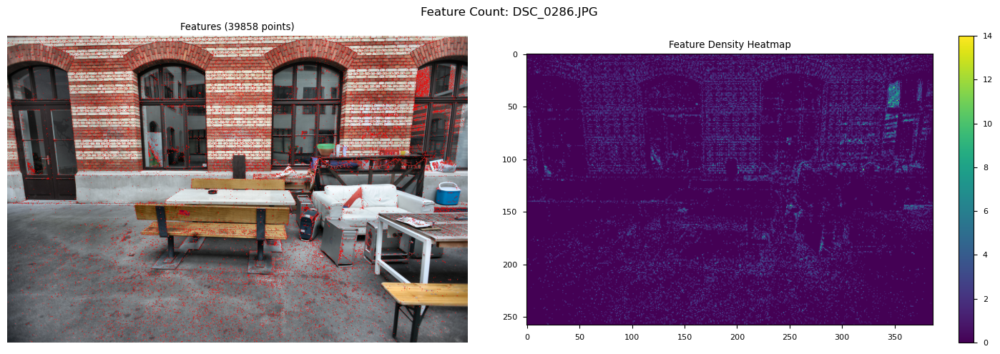

Coverage: 24.48% of grid cells contain features
Average density: 0.4 features per cell


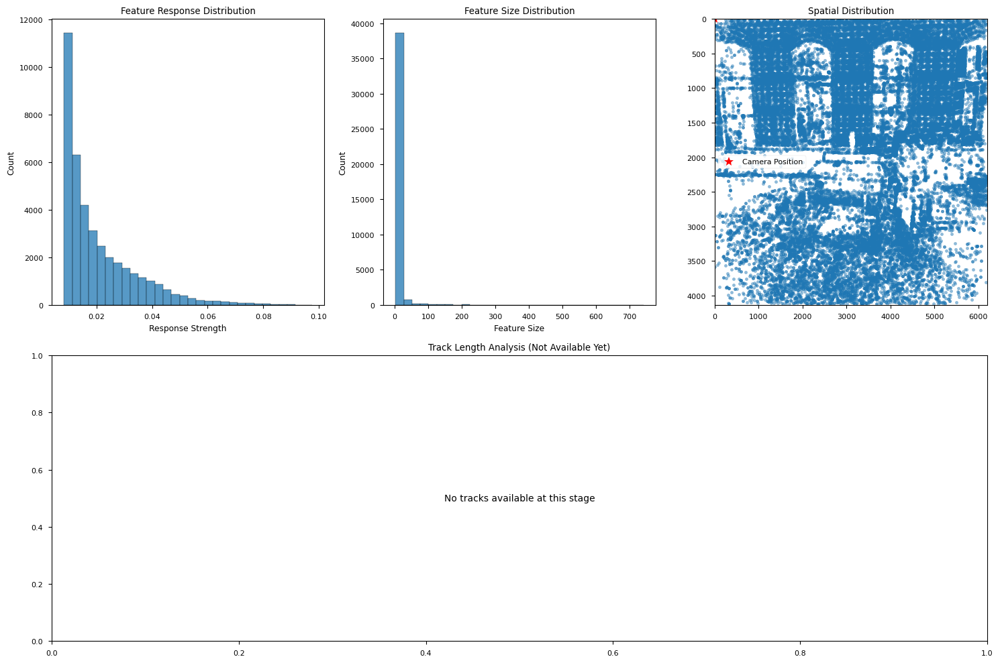


Feature Analysis Summary:
Total Features: 39858
Average Response: 0.02
Average Size: 8.62
Median Track Length: nan


C:\Users\joems\miniconda3\envs\eth3d_reconstruction\lib\site-packages\numpy\_core\fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\joems\miniconda3\envs\eth3d_reconstruction\lib\site-packages\numpy\_core\_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)

Processing images:  20%|████████████▊                                                   | 1/5 [04:39<18:36, 279.14s/it]C:\Users\joems\AppData\Local\Temp\ipykernel_12328\3117103993.py:95: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast() if self.cuda_available else nullcontext():


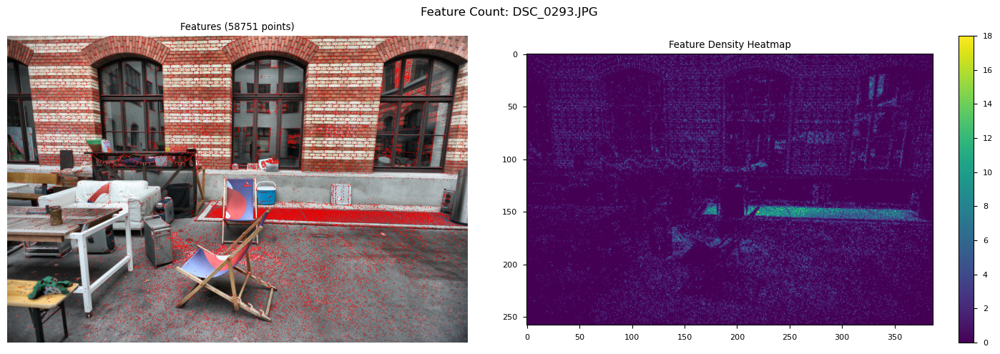

Coverage: 30.57% of grid cells contain features
Average density: 0.6 features per cell


Processing images:  40%|█████████████████████████▌                                      | 2/5 [10:26<15:57, 319.03s/it]2024-11-22 13:58:22,128 - PipelineOrchestrator - INFO - ProcessImgBatches Log Progress: Processed: 10 images, total features: 530693
INFO:PipelineOrchestrator:ProcessImgBatches Log Progress: Processed: 10 images, total features: 530693

Processing images:  60%|██████████████████████████████████████▍                         | 3/5 [11:33<06:48, 204.25s/it]

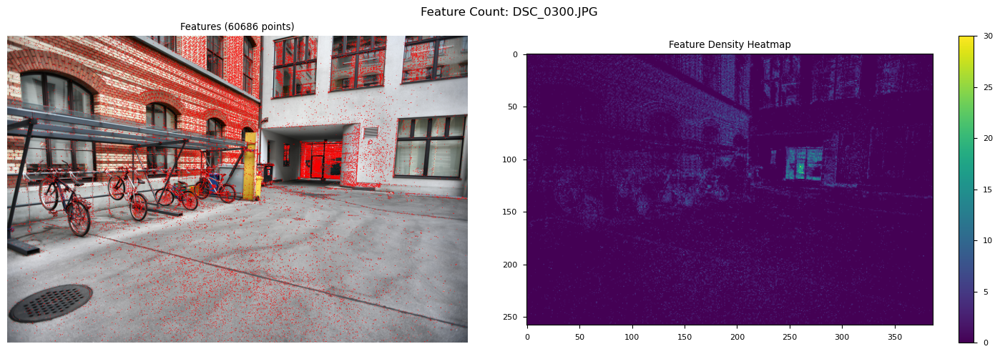

Coverage: 26.92% of grid cells contain features
Average density: 0.6 features per cell



Processing images: 100%|████████████████████████████████████████████████████████████████| 5/5 [18:55<00:00, 227.11s/it]
2024-11-22 14:05:58,555 - PipelineOrchestrator - INFO - Feature extraction complete: 18 images, 1013973 total features, average 56332 features per image
INFO:PipelineOrchestrator:Feature extraction complete: 18 images, 1013973 total features, average 56332 features per image
2024-11-22 14:05:58,653 - PipelineOrchestrator - INFO - Starting scene matches processing
INFO:PipelineOrchestrator:Starting scene matches processing
2024-11-22 14:05:58,656 - PipelineOrchestrator - INFO - Prepared data for 18 images
INFO:PipelineOrchestrator:Prepared data for 18 images
2024-11-22 14:05:58,657 - PipelineOrchestrator - INFO - Selected 17 pairs for matching (17 sequential, 0 non-sequential)
INFO:PipelineOrchestrator:Selected 17 pairs for matching (17 sequential, 0 non-sequential)
2024-11-22 14:05:58,659 - FeatureMatcher - DEBUG - === Method compute_view_overlap_matrix: View Overlap

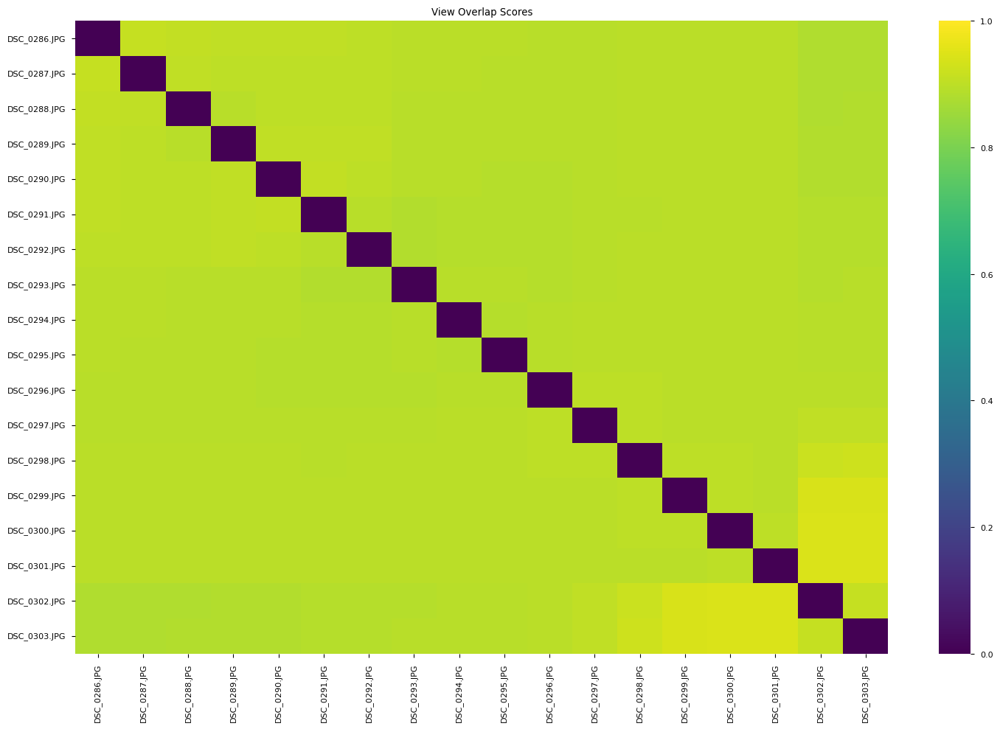

2024-11-22 14:06:02,961 - FeatureMatcher - DEBUG - Inlier ratio: 0.747 (9417/12607)
DEBUG:FeatureMatcher:Inlier ratio: 0.747 (9417/12607)
2024-11-22 14:06:02,993 - FeatureMatcher - DEBUG - Number of verified matches: 9417
DEBUG:FeatureMatcher:Number of verified matches: 9417
2024-11-22 14:06:02,997 - FeatureMatcher - DEBUG - Basic metrics: {'match_stats': {'num_matches': 9417, 'mean_distance': 104.1902303149825, 'std_distance': 57.497202010348744}, 'geometric_consistency': {'mean_epipolar_error': 0.7616717549513966, 'max_epipolar_error': 9.954960917714551, 'epipolar_std': 1.0152913331534983}, 'spatial_distribution': {'coverage': 0.90625, 'uniformity': np.float64(1.0), 'grid_stats': {'occupied_cells_img1': 58, 'occupied_cells_img2': 58, 'distribution_score': 0.90625}}}
DEBUG:FeatureMatcher:Basic metrics: {'match_stats': {'num_matches': 9417, 'mean_distance': 104.1902303149825, 'std_distance': 57.497202010348744}, 'geometric_consistency': {'mean_epipolar_error': 0.7616717549513966, 'max_

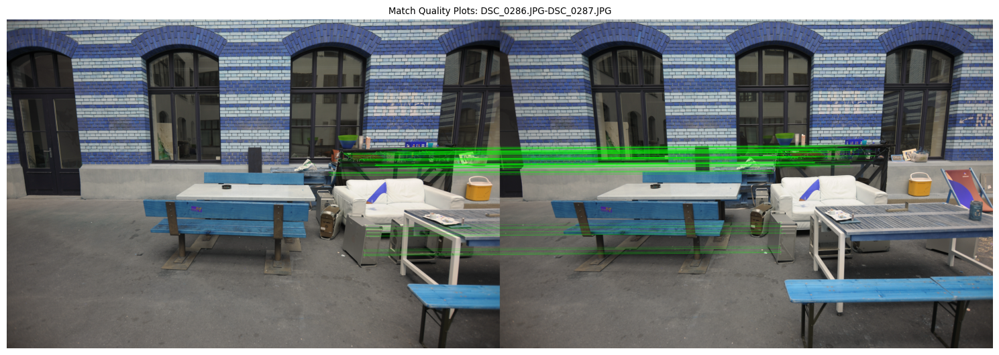

2024-11-22 14:06:11,944 - FeatureMatcher - DEBUG - Inlier ratio: 0.739 (10204/13807)
DEBUG:FeatureMatcher:Inlier ratio: 0.739 (10204/13807)
2024-11-22 14:06:11,975 - FeatureMatcher - DEBUG - Number of verified matches: 10204
DEBUG:FeatureMatcher:Number of verified matches: 10204
2024-11-22 14:06:11,980 - FeatureMatcher - DEBUG - Basic metrics: {'match_stats': {'num_matches': 10204, 'mean_distance': 111.88501507980783, 'std_distance': 55.84211044442859}, 'geometric_consistency': {'mean_epipolar_error': 0.8204641023395383, 'max_epipolar_error': 9.873970863138759, 'epipolar_std': 1.0796036462760266}, 'spatial_distribution': {'coverage': 0.953125, 'uniformity': np.float64(1.0), 'grid_stats': {'occupied_cells_img1': 61, 'occupied_cells_img2': 62, 'distribution_score': 0.9609375}}}
DEBUG:FeatureMatcher:Basic metrics: {'match_stats': {'num_matches': 10204, 'mean_distance': 111.88501507980783, 'std_distance': 55.84211044442859}, 'geometric_consistency': {'mean_epipolar_error': 0.82046410233953

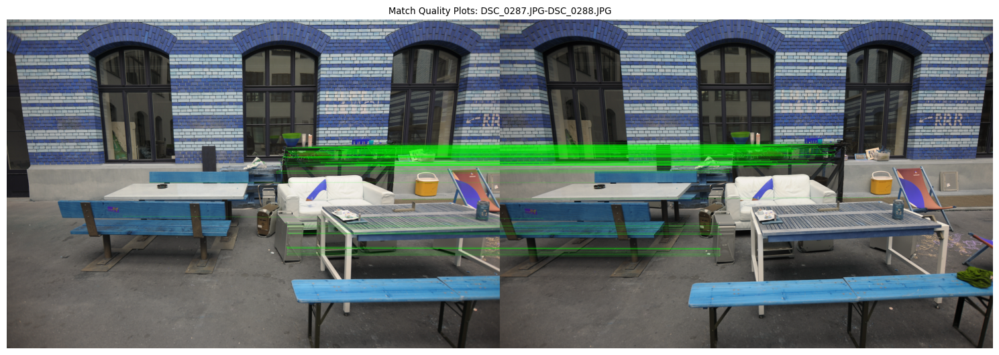

2024-11-22 14:06:21,296 - FeatureMatcher - DEBUG - Inlier ratio: 0.769 (13032/16944)
DEBUG:FeatureMatcher:Inlier ratio: 0.769 (13032/16944)
2024-11-22 14:06:21,342 - FeatureMatcher - DEBUG - Number of verified matches: 13032
DEBUG:FeatureMatcher:Number of verified matches: 13032
2024-11-22 14:06:21,347 - FeatureMatcher - DEBUG - Basic metrics: {'match_stats': {'num_matches': 13032, 'mean_distance': 106.08481826432428, 'std_distance': 54.154997211894866}, 'geometric_consistency': {'mean_epipolar_error': 1.439983780358154, 'max_epipolar_error': 9.956634548432183, 'epipolar_std': 1.6459091452913692}, 'spatial_distribution': {'coverage': 0.96875, 'uniformity': np.float64(1.0), 'grid_stats': {'occupied_cells_img1': 62, 'occupied_cells_img2': 62, 'distribution_score': 0.96875}}}
DEBUG:FeatureMatcher:Basic metrics: {'match_stats': {'num_matches': 13032, 'mean_distance': 106.08481826432428, 'std_distance': 54.154997211894866}, 'geometric_consistency': {'mean_epipolar_error': 1.439983780358154,

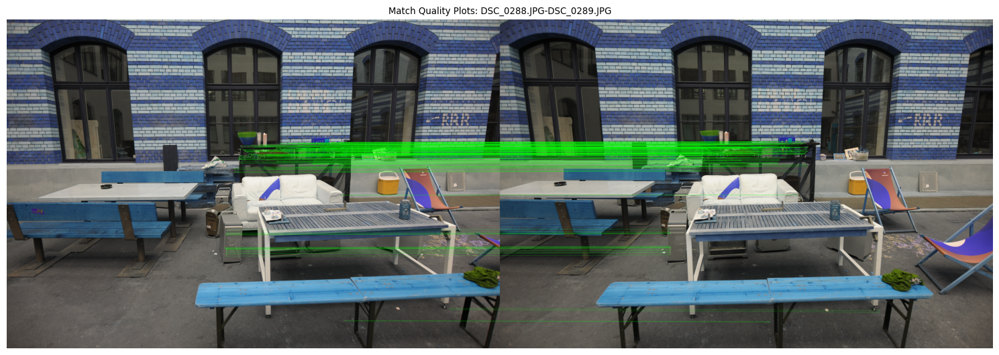

2024-11-22 14:06:30,870 - FeatureMatcher - DEBUG - Inlier ratio: 0.695 (10715/15418)
DEBUG:FeatureMatcher:Inlier ratio: 0.695 (10715/15418)
2024-11-22 14:06:30,903 - FeatureMatcher - DEBUG - Number of verified matches: 10715
DEBUG:FeatureMatcher:Number of verified matches: 10715
2024-11-22 14:06:30,906 - FeatureMatcher - DEBUG - Basic metrics: {'match_stats': {'num_matches': 10715, 'mean_distance': 102.13997599360991, 'std_distance': 51.421356057547115}, 'geometric_consistency': {'mean_epipolar_error': 1.2720110546136474, 'max_epipolar_error': 9.94002608964342, 'epipolar_std': 1.3570389285306337}, 'spatial_distribution': {'coverage': 0.90625, 'uniformity': np.float64(1.0), 'grid_stats': {'occupied_cells_img1': 58, 'occupied_cells_img2': 61, 'distribution_score': 0.9296875}}}
DEBUG:FeatureMatcher:Basic metrics: {'match_stats': {'num_matches': 10715, 'mean_distance': 102.13997599360991, 'std_distance': 51.421356057547115}, 'geometric_consistency': {'mean_epipolar_error': 1.27201105461364

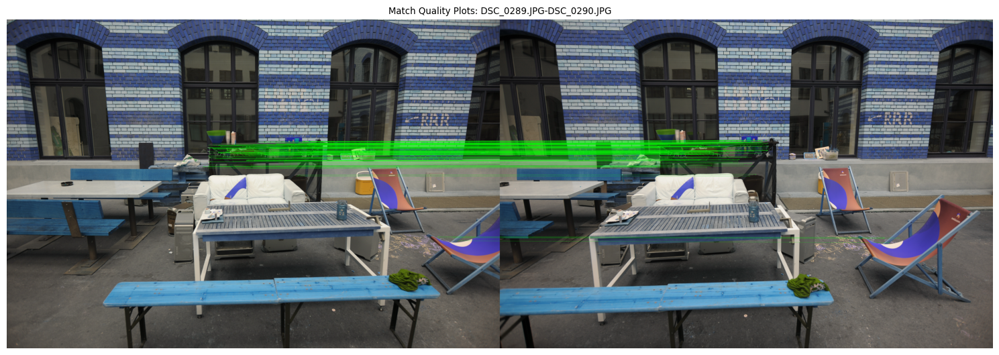

2024-11-22 14:06:40,469 - FeatureMatcher - DEBUG - Inlier ratio: 0.771 (14712/19078)
DEBUG:FeatureMatcher:Inlier ratio: 0.771 (14712/19078)
2024-11-22 14:06:40,511 - FeatureMatcher - DEBUG - Number of verified matches: 14712
DEBUG:FeatureMatcher:Number of verified matches: 14712
2024-11-22 14:06:40,514 - FeatureMatcher - DEBUG - Basic metrics: {'match_stats': {'num_matches': 14712, 'mean_distance': 110.88315530890289, 'std_distance': 56.65425570430084}, 'geometric_consistency': {'mean_epipolar_error': 2.213733140120061, 'max_epipolar_error': 9.774715605701068, 'epipolar_std': 2.1864206095609884}, 'spatial_distribution': {'coverage': 0.953125, 'uniformity': np.float64(1.0), 'grid_stats': {'occupied_cells_img1': 61, 'occupied_cells_img2': 62, 'distribution_score': 0.9609375}}}
DEBUG:FeatureMatcher:Basic metrics: {'match_stats': {'num_matches': 14712, 'mean_distance': 110.88315530890289, 'std_distance': 56.65425570430084}, 'geometric_consistency': {'mean_epipolar_error': 2.213733140120061

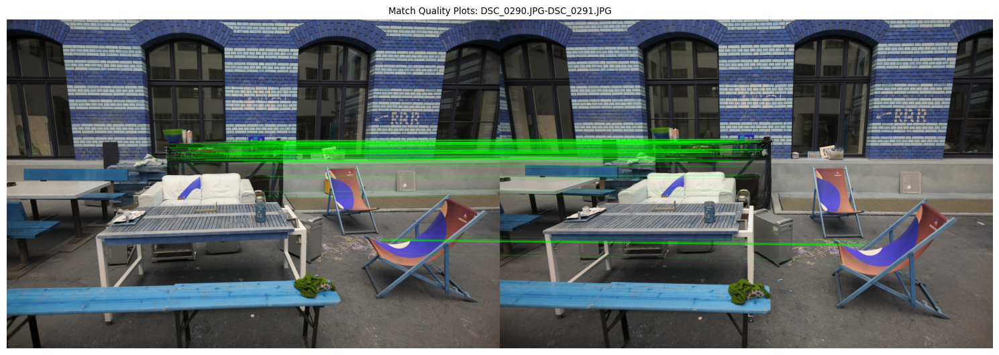

2024-11-22 14:06:49,945 - FeatureMatcher - DEBUG - Inlier ratio: 0.828 (16668/20130)
DEBUG:FeatureMatcher:Inlier ratio: 0.828 (16668/20130)
2024-11-22 14:06:50,001 - FeatureMatcher - DEBUG - Number of verified matches: 16668
DEBUG:FeatureMatcher:Number of verified matches: 16668
2024-11-22 14:06:50,004 - FeatureMatcher - DEBUG - Basic metrics: {'match_stats': {'num_matches': 16668, 'mean_distance': 112.2231106258623, 'std_distance': 59.410386520482824}, 'geometric_consistency': {'mean_epipolar_error': 1.2155321128189753, 'max_epipolar_error': 9.883637045637133, 'epipolar_std': 1.3688675922348852}, 'spatial_distribution': {'coverage': 1.0, 'uniformity': np.float64(1.0), 'grid_stats': {'occupied_cells_img1': 64, 'occupied_cells_img2': 64, 'distribution_score': 1.0}}}
DEBUG:FeatureMatcher:Basic metrics: {'match_stats': {'num_matches': 16668, 'mean_distance': 112.2231106258623, 'std_distance': 59.410386520482824}, 'geometric_consistency': {'mean_epipolar_error': 1.2155321128189753, 'max_ep

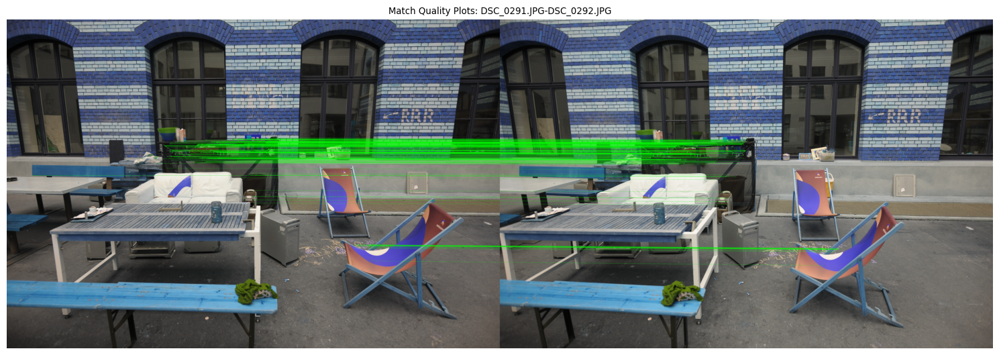

2024-11-22 14:06:59,765 - FeatureMatcher - DEBUG - Inlier ratio: 0.671 (8820/13138)
DEBUG:FeatureMatcher:Inlier ratio: 0.671 (8820/13138)
2024-11-22 14:06:59,793 - FeatureMatcher - DEBUG - Number of verified matches: 8820
DEBUG:FeatureMatcher:Number of verified matches: 8820
2024-11-22 14:06:59,797 - FeatureMatcher - DEBUG - Basic metrics: {'match_stats': {'num_matches': 8820, 'mean_distance': 103.5420938650767, 'std_distance': 53.08775411283416}, 'geometric_consistency': {'mean_epipolar_error': 1.1709393563152533, 'max_epipolar_error': 9.96086760175956, 'epipolar_std': 1.7011974579065654}, 'spatial_distribution': {'coverage': 0.875, 'uniformity': np.float64(1.0), 'grid_stats': {'occupied_cells_img1': 56, 'occupied_cells_img2': 58, 'distribution_score': 0.890625}}}
DEBUG:FeatureMatcher:Basic metrics: {'match_stats': {'num_matches': 8820, 'mean_distance': 103.5420938650767, 'std_distance': 53.08775411283416}, 'geometric_consistency': {'mean_epipolar_error': 1.1709393563152533, 'max_epip

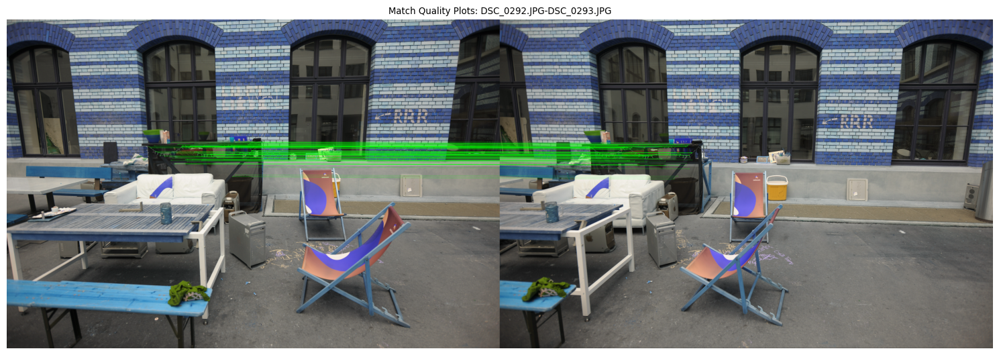

2024-11-22 14:07:09,912 - FeatureMatcher - DEBUG - Inlier ratio: 0.661 (8581/12989)
DEBUG:FeatureMatcher:Inlier ratio: 0.661 (8581/12989)
2024-11-22 14:07:09,939 - FeatureMatcher - DEBUG - Number of verified matches: 8581
DEBUG:FeatureMatcher:Number of verified matches: 8581
2024-11-22 14:07:09,943 - FeatureMatcher - DEBUG - Basic metrics: {'match_stats': {'num_matches': 8581, 'mean_distance': 130.86440332957517, 'std_distance': 60.2146973240318}, 'geometric_consistency': {'mean_epipolar_error': 0.9244733029858788, 'max_epipolar_error': 9.71955044297189, 'epipolar_std': 1.3308372230407302}, 'spatial_distribution': {'coverage': 0.921875, 'uniformity': np.float64(1.0), 'grid_stats': {'occupied_cells_img1': 59, 'occupied_cells_img2': 61, 'distribution_score': 0.9375}}}
DEBUG:FeatureMatcher:Basic metrics: {'match_stats': {'num_matches': 8581, 'mean_distance': 130.86440332957517, 'std_distance': 60.2146973240318}, 'geometric_consistency': {'mean_epipolar_error': 0.9244733029858788, 'max_epi

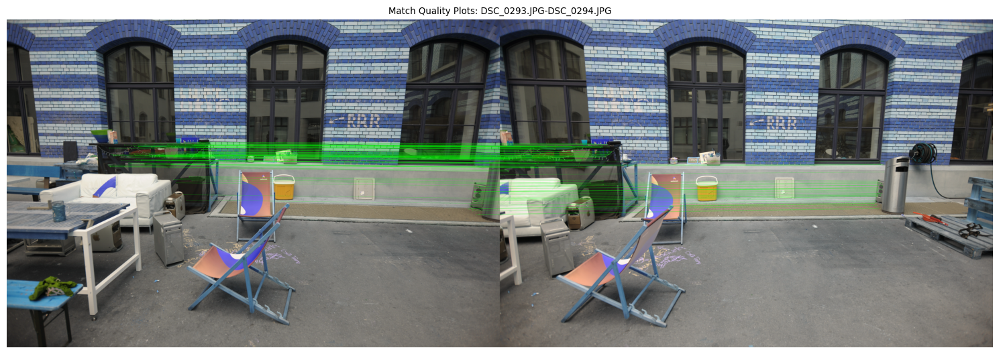

2024-11-22 14:07:20,306 - FeatureMatcher - DEBUG - Inlier ratio: 0.834 (18706/22416)
DEBUG:FeatureMatcher:Inlier ratio: 0.834 (18706/22416)
2024-11-22 14:07:20,360 - FeatureMatcher - DEBUG - Number of verified matches: 18706
DEBUG:FeatureMatcher:Number of verified matches: 18706
2024-11-22 14:07:20,363 - FeatureMatcher - DEBUG - Basic metrics: {'match_stats': {'num_matches': 18706, 'mean_distance': 120.20814136978038, 'std_distance': 61.96320610381883}, 'geometric_consistency': {'mean_epipolar_error': 0.9679488286743205, 'max_epipolar_error': 9.891728565986938, 'epipolar_std': 1.0714511889219647}, 'spatial_distribution': {'coverage': 0.96875, 'uniformity': np.float64(1.0), 'grid_stats': {'occupied_cells_img1': 62, 'occupied_cells_img2': 63, 'distribution_score': 0.9765625}}}
DEBUG:FeatureMatcher:Basic metrics: {'match_stats': {'num_matches': 18706, 'mean_distance': 120.20814136978038, 'std_distance': 61.96320610381883}, 'geometric_consistency': {'mean_epipolar_error': 0.967948828674320

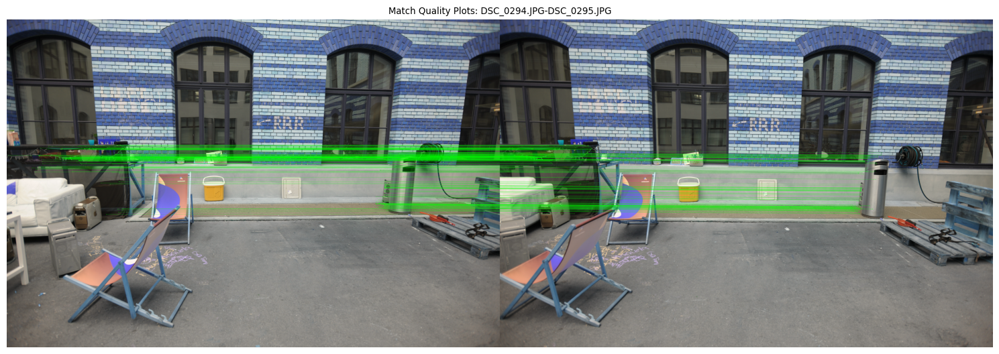

2024-11-22 14:07:31,035 - FeatureMatcher - DEBUG - Inlier ratio: 0.314 (2549/8122)
DEBUG:FeatureMatcher:Inlier ratio: 0.314 (2549/8122)
2024-11-22 14:07:31,047 - FeatureMatcher - DEBUG - Number of verified matches: 2549
DEBUG:FeatureMatcher:Number of verified matches: 2549
2024-11-22 14:07:31,051 - FeatureMatcher - DEBUG - Basic metrics: {'match_stats': {'num_matches': 2549, 'mean_distance': 140.1725461023749, 'std_distance': 53.892036935291216}, 'geometric_consistency': {'mean_epipolar_error': 3.1259021578525115, 'max_epipolar_error': 9.816812479676107, 'epipolar_std': 2.15581859571959}, 'spatial_distribution': {'coverage': 0.625, 'uniformity': np.float64(1.0), 'grid_stats': {'occupied_cells_img1': 40, 'occupied_cells_img2': 46, 'distribution_score': 0.671875}}}
DEBUG:FeatureMatcher:Basic metrics: {'match_stats': {'num_matches': 2549, 'mean_distance': 140.1725461023749, 'std_distance': 53.892036935291216}, 'geometric_consistency': {'mean_epipolar_error': 3.1259021578525115, 'max_epipo

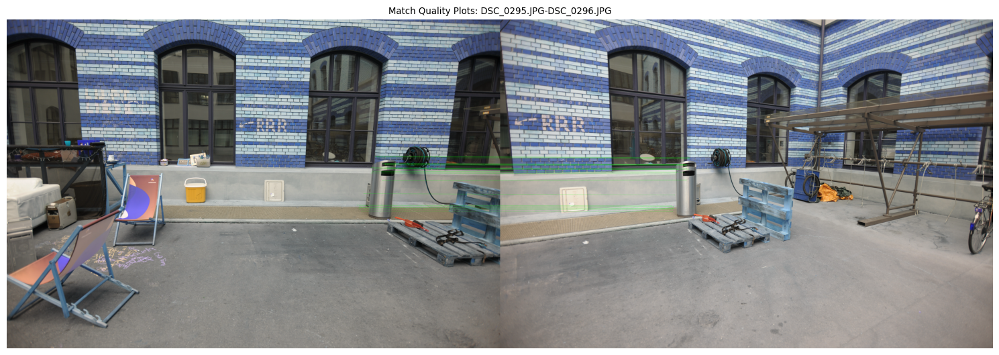

2024-11-22 14:07:36,544 - PipelineOrchestrator - INFO - Processed 10 pairs, total verified matches: 1995
INFO:PipelineOrchestrator:Processed 10 pairs, total verified matches: 1995
2024-11-22 14:07:40,504 - FeatureMatcher - DEBUG - Inlier ratio: 0.439 (3784/8613)
DEBUG:FeatureMatcher:Inlier ratio: 0.439 (3784/8613)
2024-11-22 14:07:40,521 - FeatureMatcher - DEBUG - Number of verified matches: 3784
DEBUG:FeatureMatcher:Number of verified matches: 3784
2024-11-22 14:07:40,525 - FeatureMatcher - DEBUG - Basic metrics: {'match_stats': {'num_matches': 3784, 'mean_distance': 142.65018332886646, 'std_distance': 48.96381631288571}, 'geometric_consistency': {'mean_epipolar_error': 2.7398531399053554, 'max_epipolar_error': 9.91690486819151, 'epipolar_std': 2.038468539178135}, 'spatial_distribution': {'coverage': 0.703125, 'uniformity': np.float64(1.0), 'grid_stats': {'occupied_cells_img1': 45, 'occupied_cells_img2': 49, 'distribution_score': 0.734375}}}
DEBUG:FeatureMatcher:Basic metrics: {'match

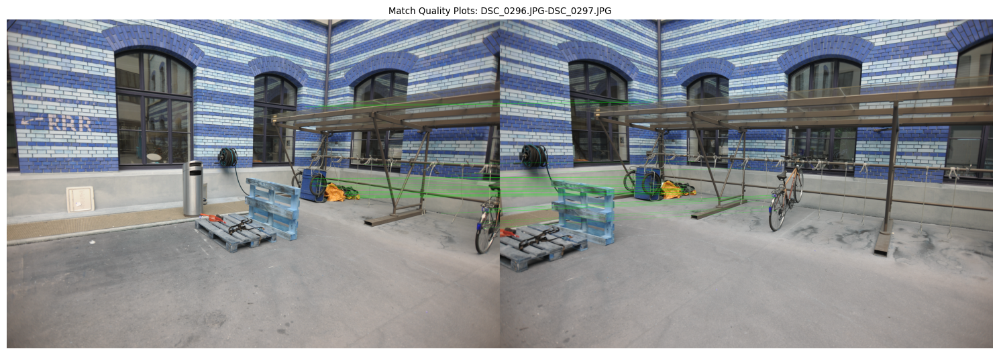

2024-11-22 14:07:49,186 - FeatureMatcher - DEBUG - Inlier ratio: 0.397 (2654/6680)
DEBUG:FeatureMatcher:Inlier ratio: 0.397 (2654/6680)
2024-11-22 14:07:49,194 - FeatureMatcher - DEBUG - Number of verified matches: 2654
DEBUG:FeatureMatcher:Number of verified matches: 2654
2024-11-22 14:07:49,197 - FeatureMatcher - DEBUG - Basic metrics: {'match_stats': {'num_matches': 2654, 'mean_distance': 144.81197657006615, 'std_distance': 50.986508673301216}, 'geometric_consistency': {'mean_epipolar_error': 1.6989942969683036, 'max_epipolar_error': 9.531614923232548, 'epipolar_std': 1.7514915181195163}, 'spatial_distribution': {'coverage': 0.75, 'uniformity': np.float64(1.0), 'grid_stats': {'occupied_cells_img1': 48, 'occupied_cells_img2': 55, 'distribution_score': 0.8046875}}}
DEBUG:FeatureMatcher:Basic metrics: {'match_stats': {'num_matches': 2654, 'mean_distance': 144.81197657006615, 'std_distance': 50.986508673301216}, 'geometric_consistency': {'mean_epipolar_error': 1.6989942969683036, 'max_e

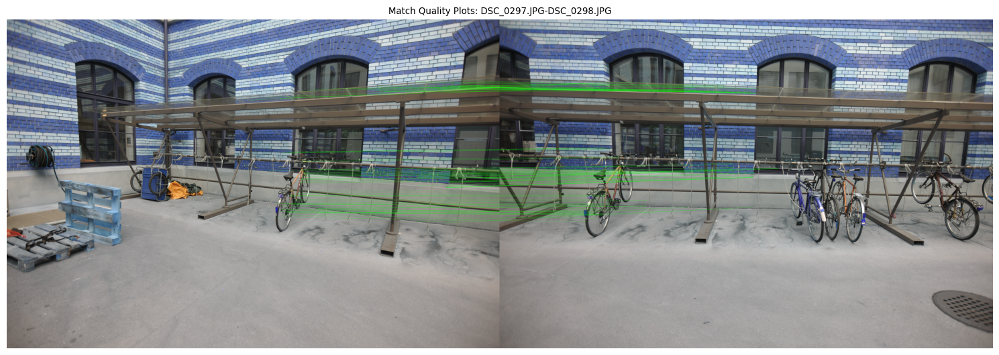

2024-11-22 14:07:58,078 - FeatureMatcher - DEBUG - Inlier ratio: 0.405 (2552/6299)
DEBUG:FeatureMatcher:Inlier ratio: 0.405 (2552/6299)
2024-11-22 14:07:58,086 - FeatureMatcher - DEBUG - Number of verified matches: 2552
DEBUG:FeatureMatcher:Number of verified matches: 2552
2024-11-22 14:07:58,087 - FeatureMatcher - DEBUG - Basic metrics: {'match_stats': {'num_matches': 2552, 'mean_distance': 145.99493197587591, 'std_distance': 52.407877791170236}, 'geometric_consistency': {'mean_epipolar_error': 2.0882953356998817, 'max_epipolar_error': 9.894840013307608, 'epipolar_std': 2.0831406560722843}, 'spatial_distribution': {'coverage': 0.859375, 'uniformity': np.float64(1.0), 'grid_stats': {'occupied_cells_img1': 61, 'occupied_cells_img2': 55, 'distribution_score': 0.90625}}}
DEBUG:FeatureMatcher:Basic metrics: {'match_stats': {'num_matches': 2552, 'mean_distance': 145.99493197587591, 'std_distance': 52.407877791170236}, 'geometric_consistency': {'mean_epipolar_error': 2.0882953356998817, 'max

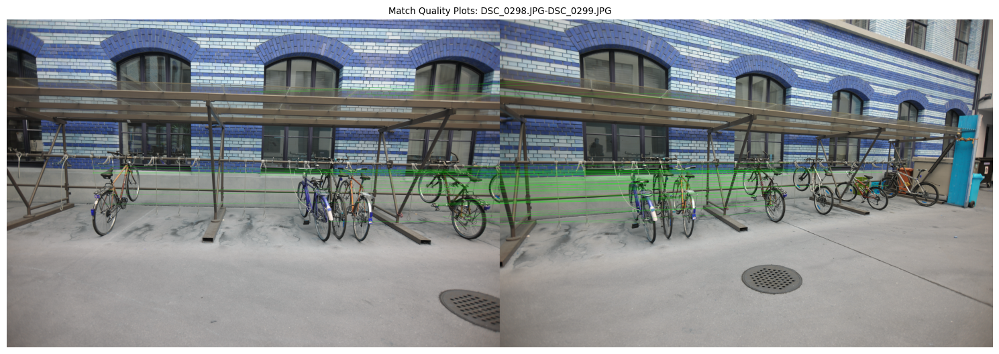

2024-11-22 14:08:07,423 - FeatureMatcher - DEBUG - Inlier ratio: 0.471 (4519/9586)
DEBUG:FeatureMatcher:Inlier ratio: 0.471 (4519/9586)
2024-11-22 14:08:07,440 - FeatureMatcher - DEBUG - Number of verified matches: 4519
DEBUG:FeatureMatcher:Number of verified matches: 4519
2024-11-22 14:08:07,443 - FeatureMatcher - DEBUG - Basic metrics: {'match_stats': {'num_matches': 4519, 'mean_distance': 136.40705045458225, 'std_distance': 50.26136979899272}, 'geometric_consistency': {'mean_epipolar_error': 3.046005922617261, 'max_epipolar_error': 9.479820055742353, 'epipolar_std': 2.104884599394379}, 'spatial_distribution': {'coverage': 0.75, 'uniformity': np.float64(1.0), 'grid_stats': {'occupied_cells_img1': 53, 'occupied_cells_img2': 48, 'distribution_score': 0.7890625}}}
DEBUG:FeatureMatcher:Basic metrics: {'match_stats': {'num_matches': 4519, 'mean_distance': 136.40705045458225, 'std_distance': 50.26136979899272}, 'geometric_consistency': {'mean_epipolar_error': 3.046005922617261, 'max_epipol

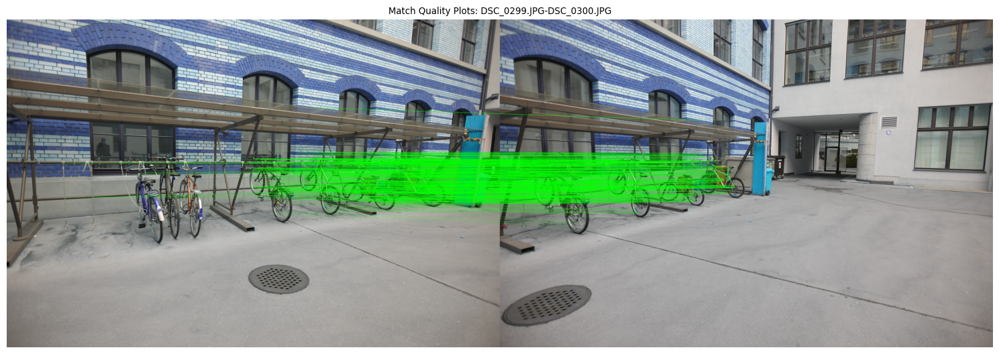

2024-11-22 14:08:17,660 - FeatureMatcher - DEBUG - Inlier ratio: 0.363 (3300/9099)
DEBUG:FeatureMatcher:Inlier ratio: 0.363 (3300/9099)
2024-11-22 14:08:17,673 - FeatureMatcher - DEBUG - Number of verified matches: 3300
DEBUG:FeatureMatcher:Number of verified matches: 3300
2024-11-22 14:08:17,674 - FeatureMatcher - DEBUG - Basic metrics: {'match_stats': {'num_matches': 3300, 'mean_distance': 141.546770399845, 'std_distance': 49.735990613270985}, 'geometric_consistency': {'mean_epipolar_error': 2.5038510881591085, 'max_epipolar_error': 9.925638122869671, 'epipolar_std': 2.458455919931041}, 'spatial_distribution': {'coverage': 0.609375, 'uniformity': np.float64(1.0), 'grid_stats': {'occupied_cells_img1': 39, 'occupied_cells_img2': 51, 'distribution_score': 0.703125}}}
DEBUG:FeatureMatcher:Basic metrics: {'match_stats': {'num_matches': 3300, 'mean_distance': 141.546770399845, 'std_distance': 49.735990613270985}, 'geometric_consistency': {'mean_epipolar_error': 2.5038510881591085, 'max_epi

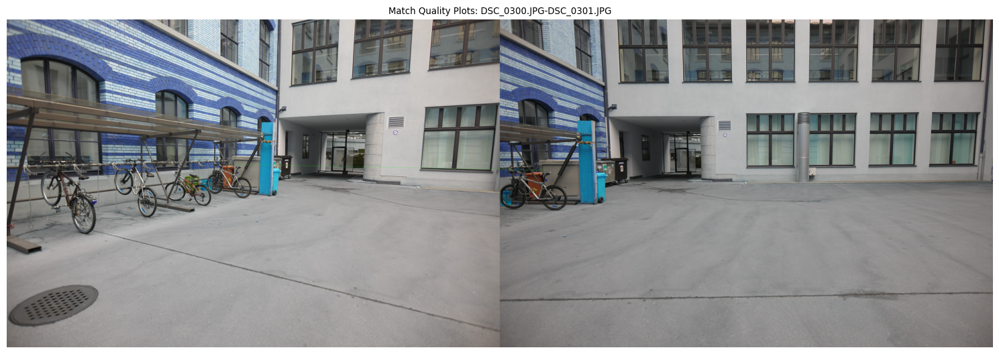

2024-11-22 14:08:27,726 - FeatureMatcher - DEBUG - Inlier ratio: 0.526 (4306/8184)
DEBUG:FeatureMatcher:Inlier ratio: 0.526 (4306/8184)
2024-11-22 14:08:27,741 - FeatureMatcher - DEBUG - Number of verified matches: 4306
DEBUG:FeatureMatcher:Number of verified matches: 4306
2024-11-22 14:08:27,744 - FeatureMatcher - DEBUG - Basic metrics: {'match_stats': {'num_matches': 4306, 'mean_distance': 134.65937963176538, 'std_distance': 51.912909848565384}, 'geometric_consistency': {'mean_epipolar_error': 1.773019301421315, 'max_epipolar_error': 9.884844202034856, 'epipolar_std': 1.9376596036973768}, 'spatial_distribution': {'coverage': 0.625, 'uniformity': np.float64(1.0), 'grid_stats': {'occupied_cells_img1': 62, 'occupied_cells_img2': 40, 'distribution_score': 0.796875}}}
DEBUG:FeatureMatcher:Basic metrics: {'match_stats': {'num_matches': 4306, 'mean_distance': 134.65937963176538, 'std_distance': 51.912909848565384}, 'geometric_consistency': {'mean_epipolar_error': 1.773019301421315, 'max_epi

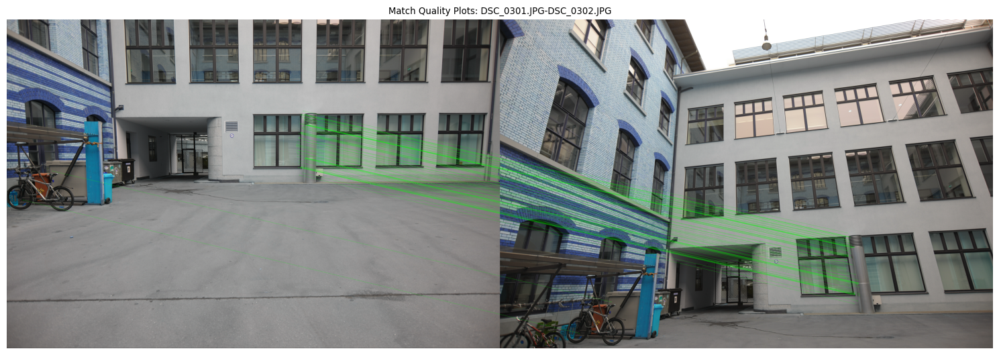

2024-11-22 14:08:39,495 - FeatureMatcher - DEBUG - Inlier ratio: 0.536 (11866/22121)
DEBUG:FeatureMatcher:Inlier ratio: 0.536 (11866/22121)
2024-11-22 14:08:39,532 - FeatureMatcher - DEBUG - Number of verified matches: 11866
DEBUG:FeatureMatcher:Number of verified matches: 11866
2024-11-22 14:08:39,534 - FeatureMatcher - DEBUG - Basic metrics: {'match_stats': {'num_matches': 11866, 'mean_distance': 117.11478785545854, 'std_distance': 46.304518231695255}, 'geometric_consistency': {'mean_epipolar_error': 0.986774261871842, 'max_epipolar_error': 9.853715523325313, 'epipolar_std': 1.374774267112651}, 'spatial_distribution': {'coverage': 0.921875, 'uniformity': np.float64(1.0), 'grid_stats': {'occupied_cells_img1': 62, 'occupied_cells_img2': 59, 'distribution_score': 0.9453125}}}
DEBUG:FeatureMatcher:Basic metrics: {'match_stats': {'num_matches': 11866, 'mean_distance': 117.11478785545854, 'std_distance': 46.304518231695255}, 'geometric_consistency': {'mean_epipolar_error': 0.98677426187184

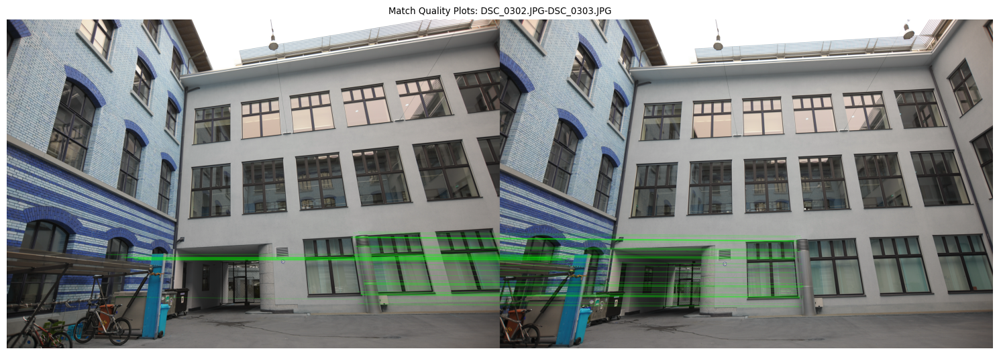

2024-11-22 14:08:45,112 - PipelineOrchestrator - INFO - Matching pairs complete:
  - Processed pairs: 17/17
  - Total matches found: 3281
  - Average matches per pair: 193.0
INFO:PipelineOrchestrator:Matching pairs complete:
  - Processed pairs: 17/17
  - Total matches found: 3281
  - Average matches per pair: 193.0
2024-11-22 14:08:45,118 - PipelineOrchestrator - INFO - Track Analysis:
INFO:PipelineOrchestrator:Track Analysis:
2024-11-22 14:08:45,120 - PipelineOrchestrator - INFO - Total tracks: 438
INFO:PipelineOrchestrator:Total tracks: 438
2024-11-22 14:08:45,122 - PipelineOrchestrator - INFO - Average length: 2.27
INFO:PipelineOrchestrator:Average length: 2.27
2024-11-22 14:08:45,123 - PipelineOrchestrator - INFO - Max length: 9
INFO:PipelineOrchestrator:Max length: 9


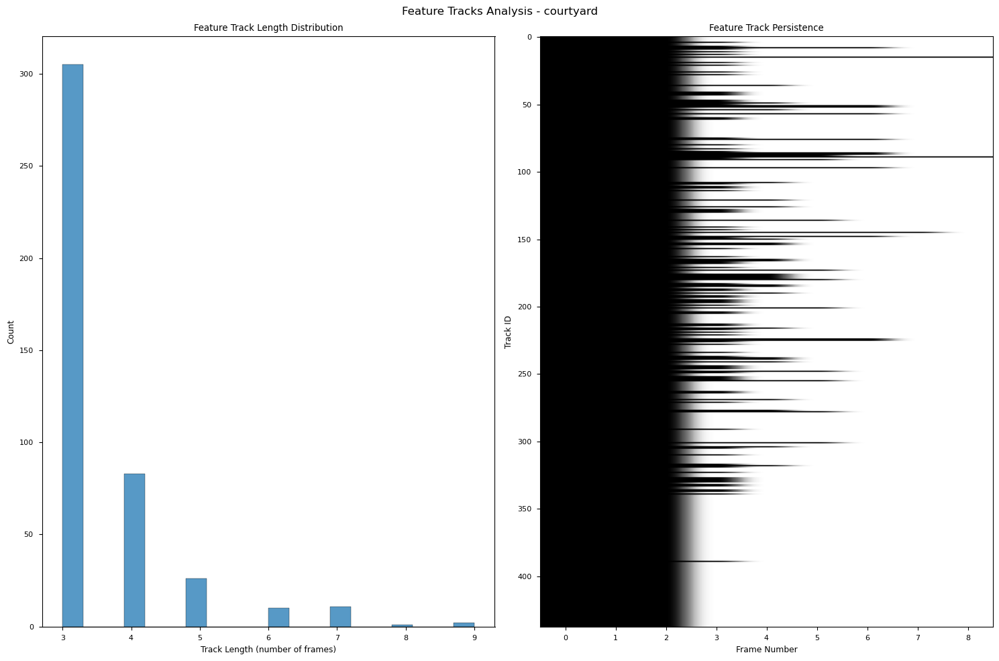

2024-11-22 14:08:45,933 - PipelineOrchestrator - INFO - Matching complete:
  - Total matches: 3281
  - Total tracks: 438
  - Sequential matches: 3281
  - Non-sequential matches: 0
  - Average matches per pair: 0.0
INFO:PipelineOrchestrator:Matching complete:
  - Total matches: 3281
  - Total tracks: 438
  - Sequential matches: 3281
  - Non-sequential matches: 0
  - Average matches per pair: 0.0



=== Feature Extraction Validation ===

Image: DSC_0286.JPG
Number of keypoints: 39858
Descriptor shape: (39858, 128)
Image statistics available: Yes

Image: DSC_0287.JPG
Number of keypoints: 43593
Descriptor shape: (43593, 128)
Image statistics available: Yes

Image: DSC_0288.JPG
Number of keypoints: 50224
Descriptor shape: (50224, 128)
Image statistics available: Yes

=== Matching Results Validation ===
Total image pairs: 17

Pair: DSC_0286.JPG - DSC_0287.JPG
Number of matches: 157
Inlier ratio: 0.02
Fundamental matrix computed: ✓

Pair: DSC_0287.JPG - DSC_0288.JPG
Number of matches: 241
Inlier ratio: 0.02
Fundamental matrix computed: ✓

Pair: DSC_0288.JPG - DSC_0289.JPG
Number of matches: 270
Inlier ratio: 0.02
Fundamental matrix computed: ✓

=== Correspondence Tracks Validation ===
Total number of tracks: 438
Average track length: 2.27
Max track length: 9

Track 2:
Length: 3
Images: ['DSC_0286.JPG', 'DSC_0287.JPG', 'DSC_0288.JPG']

Track 3:
Length: 3
Images: ['DSC_0286.JPG', 'DSC_0

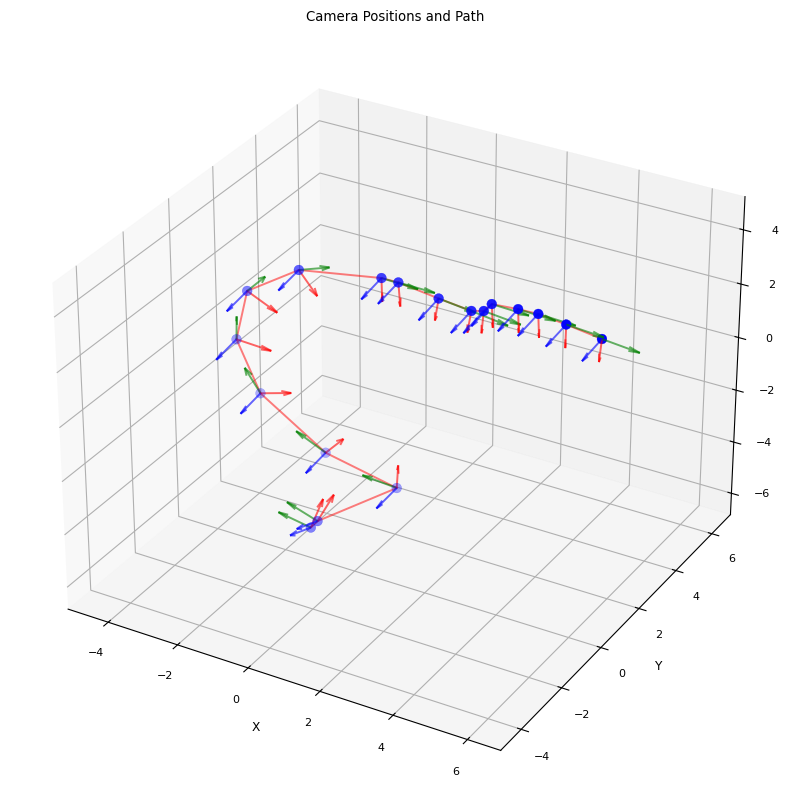

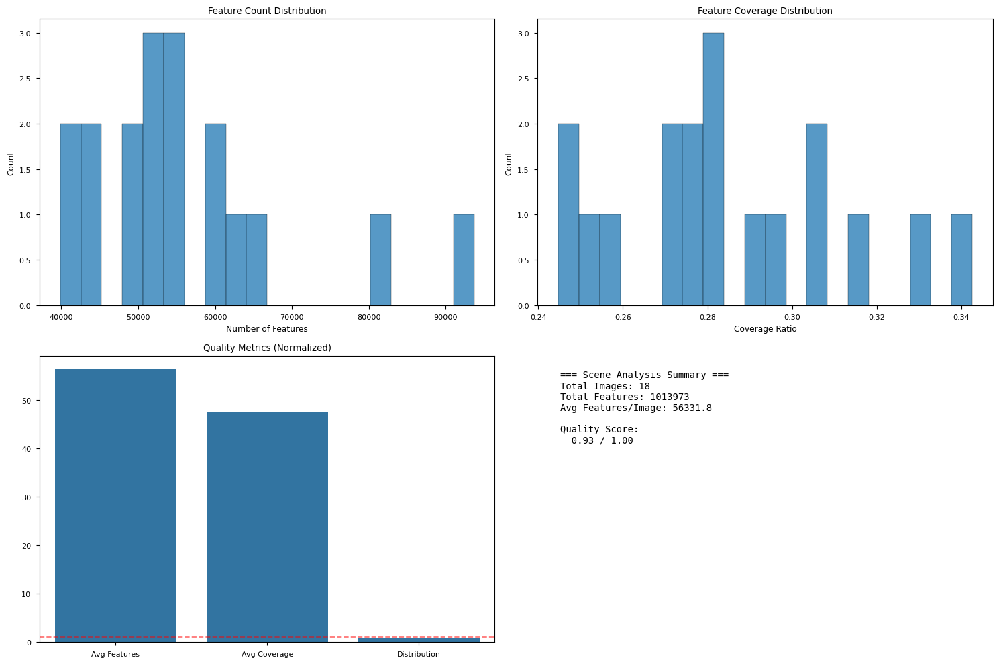

2024-11-22 14:08:47,784 - PipelineOrchestrator - INFO - Processed scene courtyard in 1310.58 seconds
INFO:PipelineOrchestrator:Processed scene courtyard in 1310.58 seconds
2024-11-22 14:08:47,786 - PipelineOrchestrator - INFO - Successfully processed scene: courtyard
INFO:PipelineOrchestrator:Successfully processed scene: courtyard
Processing scenes: 100%|███████████████████████████████████████████████████████████████| 1/1 [21:50<00:00, 1310.59s/it]
2024-11-22 14:21:09,707 - ResultsManager - INFO - Successfully saved all results to C:\Users\joems\OneDrive\Desktop\MLCV Project Items\Comp Vision CS 5330\CV Project Results\20241122_134614
INFO:ResultsManager:Successfully saved all results to C:\Users\joems\OneDrive\Desktop\MLCV Project Items\Comp Vision CS 5330\CV Project Results\20241122_134614
2024-11-22 14:21:09,709 - PipelineOrchestrator - INFO - Completed dataset processing in 2052.53 seconds
INFO:PipelineOrchestrator:Completed dataset processing in 2052.53 seconds
2024-11-22 14:21:0

In [14]:
#------------------------------------------------------------------------------------------------------------------------------------------------

"""Generate and log processing summary for all scenes.
Args: results: Dictionary mapping scene names to SceneData objects
      logger: Logger instance for output """
def generate_processing_summary(results: Dict[str, SceneData], logger: logging.Logger):
    logger.info("\n====================  Processing Summary ==================== ")
    
    for scene_name, scene_data in results.items():
        logger.info(f"\nScene: {scene_name}")
        logger.info(f"Type: {scene_data.metadata.get('scene_type', 'Unknown')}")
        logger.info(f"Images processed: {len(scene_data.features)}")
        
        # Feature statistics
        total_features = sum(len(feat.keypoints) for feat in scene_data.features.values())
        logger.info(f"Total features: {total_features}")
        logger.info(f"Average features per image: {total_features / len(scene_data.features):.1f}")
        
        # Match statistics
        if scene_data.matches:
            total_matches = sum(len(m['verified_matches']) for m in scene_data.matches.values())
            logger.info(f"Total matches: {total_matches}")
            logger.info(f"Image pairs matched: {len(scene_data.matches)}")
        
        # Track statistics
        if scene_data.correspondences and 'tracks' in scene_data.correspondences:
            logger.info(f"Feature tracks: {len(scene_data.correspondences['tracks'])}")
        
        # Scene statistics if available
        if scene_data.scene_stats:
            logger.info(f"Quality score: {scene_data.scene_stats.quality_score:.2f}")

        ## PROBLEM CODE RIGHT NOW.. 
        # # Generate visualizations if we have the data 0--- THESE FAILED. bcs of o3d issues.
        # try:
        #     # 1. Visualize occlusion data
        #     if scene_data.scene_occlusion:
        #         # Sample a few points for visualization
        #         if scene_data.points3D:
        #             sample_points = list(scene_data.points3D.values())[:3]  # First 3 points
        #             for i, point3d in enumerate(sample_points):
        #                 # Get a camera pose that sees this point
        #                 camera_poses = scene_data.metadata.get('camera_poses', {})
        #                 if camera_poses:
        #                     camera_pos = np.array(next(iter(camera_poses.values()))['position'])
                            
        #                     # Visualize occlusion check for this point
        #                     scene_data.scene_occlusion.visualize_occlusion(
        #                         point=point3d.position,
        #                         camera_pos=camera_pos
        #                     )
        #                     logger.info(f"Generated occlusion visualization for point {i+1}/3")

        #     # 2. Sample mask visualization
        #     if scene_data.occlusion_data:
        #         # Create a figure to show a few sample masks
        #         sample_masks = list(scene_data.occlusion_data.items())[:3]  # First 3 masks
        #         fig, axes = plt.subplots(1, len(sample_masks), figsize=(15, 5))
        #         fig.suptitle("Sample Occlusion Masks")
                
        #         for i, (img_name, occ_data) in enumerate(sample_masks):
        #             mask = occ_data.load_mask()
        #             if mask is not None:
        #                 axes[i].imshow(mask, cmap='gray')
        #                 axes[i].set_title(f"Mask: {img_name}")
        #                 axes[i].axis('off')
                
        #         plt.tight_layout()
        #         plt.show()

        #     # 3. Point Cloud and Camera Positions
        #     if scene_data.points3D and scene_data.metadata.get('camera_poses'):
        #         # Create Open3D visualization
        #         vis = o3d.visualization.Visualizer()
        #         vis.create_window()
                
        #         # Add points
        #         point_cloud = o3d.geometry.PointCloud()
        #         points = np.array([p.position for p in scene_data.points3D.values()])
        #         colors = np.array([p.color/255.0 for p in scene_data.points3D.values()])
        #         point_cloud.points = o3d.utility.Vector3dVector(points)
        #         point_cloud.colors = o3d.utility.Vector3dVector(colors)
        #         vis.add_geometry(point_cloud)
                
        #         # Add camera positions
        #         camera_positions = np.array([pose['position'] for pose in scene_data.metadata['camera_poses'].values()])
        #         camera_cloud = o3d.geometry.PointCloud()
        #         camera_cloud.points = o3d.utility.Vector3dVector(camera_positions)
        #         camera_cloud.paint_uniform_color([1, 0, 0])  # Red for cameras
        #         vis.add_geometry(camera_cloud)
                
        #         # Render
        #         vis.run()
        #         vis.destroy_window()
        #         logger.info("Generated 3D visualization of points and cameras")

        # except Exception as e:
        #     logger.warning(f"Error generating visualizations: {str(e)}")




def validate_initial_setup(config: ProcessingConfig) -> bool:
    """
    Validate initial setup including scene metadata, paths, and critical components.
    Returns True if validation passes, raises detailed exceptions if issues found.
    """
    logger = logging.getLogger("Setup Validation")
    logger.info("\n=== Initial Setup Validation ===")

    try:
        # 1. Base Path Validation
        logger.info("Checking base path...")
        dataset_path = config.base_path / 'mv_undistorted' / 'multi_view_training_dslr_undistorted'
        if not dataset_path.exists():
            raise ValueError(f"Dataset path not found: {dataset_path}")
        
        # 2. Scene Manager Test
        logger.info("Initializing SceneManager...")
        scene_manager = SceneManager(config.base_path)
        available_scenes = scene_manager.scenes
        logger.info(f"Found {len(available_scenes)} scenes: {', '.join(available_scenes)}")

        # 3. Selected Scenes Validation
        if config.selected_scenes:
            logger.info("Validating selected scenes...")
            for scene in config.selected_scenes:
                if scene not in available_scenes:
                    raise ValueError(f"Selected scene '{scene}' not found in dataset")
                
                # Get and validate scene metadata
                scene_meta = scene_manager.scene_metadata.get(scene)
                if not scene_meta:
                    raise ValueError(f"No metadata found for scene: {scene}")
                
                # Check image paths
                image_paths = scene_meta.get('image_paths', [])
                if not image_paths:
                    raise ValueError(f"No image paths found for scene: {scene}")
    
                # Check if image_to_camera_map exists in metadata
                if 'image_to_camera_map' not in scene_meta:
                    logger.warning(f"No image-to-camera mapping found for scene: {scene}")

                # Validate first few images (as a sample)
                for path in image_paths[:3]:  # Check first 3 images
                    if not Path(path).exists():
                        raise FileNotFoundError(f"Image not found: {path}")
                
                logger.info(f"Scene '{scene}' validation:")
                logger.info(f"  - Number of images: {len(image_paths)}")
                logger.info(f"  - Has poses: {scene_meta.get('has_poses', False)}")
                logger.info(f"  - Has calibration: {scene_meta.get('has_calibration', False)}")
                logger.info(f"  - Has camera mapping: {'image_to_camera_map' in scene_meta}")

        # 4. Resource Validation
        logger.info("Checking system resources...")
        gpu_info = torch.cuda.get_device_properties(0) if torch.cuda.is_available() else None
        if gpu_info:
            gpu_memory = gpu_info.total_memory / (1024**3)  # Convert to GB
            logger.info(f"GPU: {gpu_info.name}")
            logger.info(f"GPU Memory: {gpu_memory:.2f} GB")
            
            # Validate batch size based on GPU memory
            if gpu_memory < 4 and config.preprocessing.batch_size > 2:
                logger.warning("Reducing batch size due to limited GPU memory")
                config.preprocessing.batch_size = 2

        # 5. Output Directory Validation
        logger.info("Validating output directory...")
        config.save_dir.mkdir(parents=True, exist_ok=True)
        
        # Test write permission
        test_file = config.save_dir / '.test_write'
        try:
            test_file.touch()
            test_file.unlink()
        except Exception as e:
            raise PermissionError(f"Cannot write to output directory: {str(e)}")

        logger.info("✅ All validations passed successfully!")
        return True

    except Exception as e:
        logger.error(f"❌ Validation failed: {str(e)}")
        raise



""" > Limit the number of images in a scene metadata.
Args:   scene_meta: Original scene metadata dictionary
        max_images: Maximum number of images to keep
Returns:    Dict: Limited scene metadata
"""
def limit_scene_images(scene_meta: Dict, max_images: int = 8) -> Dict:
    
    if not scene_meta: return scene_meta
        
    # Create shallow copy of metadata
    limited_meta = dict(scene_meta)
    
    # Limit image paths
    if 'image_paths' in limited_meta:
        limited_meta['image_paths'] = limited_meta['image_paths'][:max_images]
        
    # Limit camera poses if they exist
    if 'camera_poses' in limited_meta:
        poses = limited_meta['camera_poses']
        limited_poses = {}
        for img_path in limited_meta['image_paths']:
            img_name = Path(img_path).name
            if img_name in poses:
                limited_poses[img_name] = poses[img_name]
        limited_meta['camera_poses'] = limited_poses
    
    # Update image count
    limited_meta['num_images'] = len(limited_meta['image_paths'])
    
    return limited_meta


def setup_logging(debug_mode: bool = False):
    """Configure logging levels for different components"""

    base_level = logging.DEBUG if debug_mode else logging.INFO

    logging.basicConfig(
        level=base_level, format='%(asctime)s - %(name)s - %(levelname)s - %(message)s' )

    loggers = {
        'PipelineOrchestrator': base_level,
        'FeatureMatcher': base_level,
        'ResultsManager': base_level,
        'ValidationHelper': base_level,
        'ImageStatsManager': base_level,
        'SceneManager': base_level
    }

    # Apply configuration to each logger
    for logger_name, level in loggers.items():
        logger = logging.getLogger(logger_name)
        logger.setLevel(level)
        
        # ensuring logger has at least one handler
        if not logger.handlers:
            ch = logging.StreamHandler() ## this is a console handler.
            ch.setLevel(level)
            # Create formatter
            formatter = logging.Formatter( '%(asctime)s - %(name)s - %(levelname)s - %(message)s' )
            ch.setFormatter(formatter)
            # Add handler to logger
            logger.addHandler(ch)

    # Reduce verbosity for third-party libraries
    if not debug_mode:
        logging.getLogger('matplotlib').setLevel(logging.WARNING)
        logging.getLogger('PIL').setLevel(logging.WARNING)



#------------------------------------------------------------------------------------------------------------------------------------------------


def main():
    """ Main function to execute the 3D Image Reconstruction pipeline. Processes a predefined set of scenes and saves the results.
    ceil(38/4) ≈ 10 batches // Batch 0: images 0-3 / Batch 1: images 4-7 ...
    """
    
    # Setup logging
    ## logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(name)s - %(levelname)s - %(message)s')

    DEBUG_MODE = True  
    setup_logging(debug_mode=DEBUG_MODE)
    logger = logging.getLogger("Main")


    
    # Scene Characteristics:
    # - Mean camera movement: 1457.06 units # - Angular changes: 95.73° mean # - High movement variance (std: 4031.27)
    # Current mean+2*std ≈ 9500 units .. Current 8.0 gives 2.9% inlier ratio

    # explicitly optimizing for SfM/MVS requirements - particularly non-sequential matches and triangulation angles

    try:
        # Initialize configuration
        config = ProcessingConfig(
            base_path=Path(r"C:\Users\joems\OneDrive\Desktop\MLCV Project Items\Comp Vision CS 5330\CV Project Dataset"),
            save_dir=Path(r"C:\Users\joems\OneDrive\Desktop\MLCV Project Items\Comp Vision CS 5330\CV Project Results"),

            num_scenes=1,
            selected_scenes=['courtyard'],          ## ['courtyard', 'facade', 'office'],

            gpu_config=GPUConfig(use_gpu=False),
            preprocessing=PreprocessingSettings(batch_size=4, num_workers=0, enhance_contrast=True, denoise=True),
            feature_detection=FeatureDetectionSettings( min_features=1000, max_features=60000, 
                                                        feature_density_threshold=0.006, contrastThreshold = 0.025,
                                                       edgeThreshold=10, sigma=1.6 ),
            # increasing constrast? stronger features. reducing max features = no noise. edge threwshold, increase slightly.
            # max dist was 50 before, now 2000. increased based on scale.
            # Given mean+std is around 5488 units, we should keep max_distance_threshold higher.. !

                                            ## increasing max dist, lowering overlap quite a bit for widebaseline matches. 
            matching_config=MatchingConfig(max_distance_threshold=10000.0, min_overlap_threshold=0.15, 
                                           similarity_threshold=0.25, max_neighbors=20, #increasing, a lot. 
                                           ratio_test_threshold=0.85, ransac_threshold=10.0, 
                                           
                                           min_inlier_ratio = 0.15, # Relaxed to allow more matches while maintaining quality
                                           visibility_threshold_2d=0.35, visibility_threshold_3d=0.35),
            
            visualization_config=VisualizationConfig(save_visualizations=True, figsize=(15, 10), dpi=100, show_interactive=True, 
                    force_all_plots=False, feature_threshold=100, match_threshold=30, track_threshold=10,  
                    show_feature_density=True, show_matches=True, show_tracks=True) ,

            enable_multiprocessing=True)

        # timestamp ONCE at the start
        timestamp = datetime.now().strftime('%Y%m%d_%H%M%S')

        # Testing/Debug mode with limited images
        # picture count limiting, for faster work.
        DEBUG_MODE = True
        MAX_IMAGES = 18

        if DEBUG_MODE:
            logger.info(f"Running in DEBUG mode with max {MAX_IMAGES} images per scene")

        # Validate configuration
        config.validate()

        #: Validate initial setup including scene metadata
        if not validate_initial_setup(config):
            raise ValueError("Initial setup validation failed")

        # Validate configuration.. new.
        validator = ValidationHelper()
        if not validator.validate_processing_config(config):
            raise ValueError("Configuration validation failed")
        
        # Initialize pipeline
        logger.info("Initializing pipeline...")
        start_time = time.time()

        pipeline = PipelineOrchestrator(config)
        
        # Process dataset
        logger.info(f"Starting processing of scenes: {config.selected_scenes}")
        try:

            if DEBUG_MODE:
                for scene_name in config.selected_scenes:         # Modify SceneManager's scene metadata before processing
                    scene_meta = pipeline.scene_manager.scene_metadata[scene_name]
                    pipeline.scene_manager.scene_metadata[scene_name] = limit_scene_images(scene_meta, MAX_IMAGES)
                    logger.info(f"Limited scene {scene_name} to {MAX_IMAGES} images")

                    # Add debug summary
                    limited_meta = pipeline.scene_manager.scene_metadata[scene_name]
                    logger.debug(f"Debug Mode Scene Summary:")
                    logger.debug(f"- Images: {len(limited_meta['image_paths'])}")
                    logger.debug(f"- Poses: {len(limited_meta.get('camera_poses', {}))}")


            # Process with limited data .. if debug is true.
            ## .. outdated: results = pipeline.process_dataset(scenes=config.selected_scenes)

            scene_results = pipeline.process_dataset(scenes=config.selected_scenes, timestamp=timestamp)
            # time it ! :)
            processing_time = time.time() - start_time

            # Create results container
            reconstruction_results = ReconstructionResults( scene_data=scene_results, 
                                                           timestamp=timestamp, processing_time=processing_time, config=config )
            # Store in registry
            ResultsRegistry.store(reconstruction_results)
            
            # Perform post-processing
            pipeline.generate_post_processing(scene_results)
            logger.info("Processing completed successfully")

            # scene related -  call to generate summary.
            generate_processing_summary(scene_results, logger)

            # Validate final scene_results ..  - use the latest save path from results_manager
            save_path = config.save_dir / timestamp
            validator.validate_result_storage(save_path)

        except Exception as e:
            logger.error(f"Error during processing: {str(e)}")  # Fixed line
            raise

    except Exception as e:
        logger.error(f"Pipeline initialization error: {str(e)}")
        raise
    
    finally:
        # Clean up any temporary resources if needed
        logger.info("Pipeline execution finished")

if __name__ == "__main__":
    main()


## Simple Test Script & DATA AVAILABILITY.



---

### **Code Analysis**

   -  After running a large reconstruction pipeline in `main()`, this code retrieves results from the `ResultsRegistry` and performs an extensive analysis to evaluate the quality of the reconstruction process.
   -  Checks if important elements (e.g., feature extraction, matches, 2D/3D points, camera data) were successfully processed and provides a detailed breakdown.
   -  Logs any errors or issues in processing specific scenes, datasets, or matches.

---

#### (a) **Results Retrieval**
   - **`ResultsRegistry.get_latest()`**: This fetches the latest results from a hypothetical results registry. This ensures the most recent pipeline run is analyzed.
   - If no results are found, the program logs an error and exits gracefully.

#### (b) **Reconstruction Results Summary (`test_reconstruction_results`)**
   - **Purpose:** This summarizes the overall results, such as processing time, timestamp, number of scenes processed, and other high-level metrics.
   - **Scene-Specific Analysis:**
     - Retrieves specific scene results (e.g., "courtyard").
     - Logs key metrics, such as total features, matches, tracks, and triangulation angle for a sample image pair.
     - Provides insights into match quality using pose metrics (e.g., triangulation angles, baseline ratios, view overlap).

#### (c) **Data Availability Analysis (`analyze_data_availability`)**
   - **Purpose:** Verifies the availability and quality of key data components used in reconstruction:
     - **Basic Scene Information:** Scene type and number of images.
     - **Feature Analysis:** Total and average keypoints/features per image.
     - **Match Analysis:** Total matches, number of image pairs matched, and detailed statistics for a sample pair.
     - **Camera and Pose Analysis:** Checks if camera intrinsics (focal length, resolution) and poses are available, along with the number of calibrated cameras.
     - **2D Points Analysis:** Verifies the presence of 2D keypoints, the total number of points, and the ratio of 3D-referenced points to 2D points.
     - **3D Points Analysis:** Provides the total number of 3D points and samples one 3D point for additional verification (e.g., position, color, reprojection error, track length).
     - **Track Analysis:** Evaluates the total number of tracks, average track length, and track length distribution.

#### (d) **Occlusion Analysis**
   - **Purpose:** Checks for occlusion-related data, such as binary occlusion masks and scene-level occlusion information (e.g., splats and meshes).
   - Provides details about the availability of occlusion masks and their sample dimensions, along with whether splats or surface meshes were loaded successfully.

---
---

- Verify that all results (features, matches, tracks, etc.) are generated correctly.
- Analyze the quality of reconstruction at both high-level (e.g., processing time, matches) and granular levels (e.g., triangulation angles, 2D/3D point correspondences).
- Debug any issues in the pipeline (e.g., missing camera intrinsics, low-quality matches).

---


## Important Result Analysis

In [15]:
def test_reconstruction_results():
    logging.basicConfig(level=logging.INFO, format='%(levelname)s: %(message)s')  # Simplified format
    logger = logging.getLogger("ResultsTest")

    try:
        results = ResultsRegistry.get_latest()
        if not results:
            logger.error("No results found in registry")
            return

        logger.info("=== Reconstruction Results Summary ===")
        logger.info(f"Processing Time: {results.processing_time:.2f}s | "
                   f"Timestamp: {results.timestamp} | "
                   f"Scenes: {len(results.scene_data)}")

        scene_name = "courtyard"
        scene = results.get_scene(scene_name)
        if scene:
            logger.info(f"=== Scene '{scene_name}' Analysis ===")
            logger.info(f"Features: {sum(len(f.keypoints) for f in scene.features.values())} | "
                       f"Pairs: {len(scene.matches)} | "
                       f"Tracks: {len(scene.correspondences.get('tracks', {}))}")

            if scene.matches:
                sample_pair = next(iter(scene.matches.items()))
                logger.info(f"Sample Pair Quality ({sample_pair[0][0]}-{sample_pair[0][1]}): "
                          f"Matches: {len(sample_pair[1]['verified_matches'])} | "
                          f"Angle: {sample_pair[1]['pose_metrics']['mean_triangulation_angle']:.2f}°")

            logger.info("Test completed successfully!")
        else:
            logger.error(f"Scene '{scene_name}' not found")

    except Exception as e:
        logger.error(f"Test failed: {str(e)}")

        
if __name__ == "__main__":
    test_reconstruction_results()

## ------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
## ------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


import logging
from datetime import datetime
import statistics  # Ensure this is added
from typing import Dict




def analyze_data_availability(scene_data: SceneData) -> Dict:
    """Enhanced comprehensive analysis of reconstruction data and quality metrics."""
    try:
        analysis = {
            "1. Scene Configuration": {
                "scene_type": scene_data.metadata.get('scene_type', 'unknown'),
                "num_images": len(scene_data.features),
                "processing_timestamp": datetime.now().isoformat(),
                "scene_name": scene_data.metadata.get('scene_name', 'unknown'),
            },

            "2. Feature Analysis": {
                "total_features": sum(len(f.keypoints) for f in scene_data.features.values()),
                "avg_features_per_image": sum(len(f.keypoints) for f in scene_data.features.values()) / len(scene_data.features),
                "feature_distribution": {
                    "min": min(len(f.keypoints) for f in scene_data.features.values()),
                    "max": max(len(f.keypoints) for f in scene_data.features.values()),
                    "std": float(np.std([len(f.keypoints) for f in scene_data.features.values()])),
                    "variation_coef": float(np.std([len(f.keypoints) for f in scene_data.features.values()]) / 
                                         np.mean([len(f.keypoints) for f in scene_data.features.values()]))
                },
                "coverage_stats": {
                    "mean": np.mean([f.image_stats.feature_coverage for f in scene_data.features.values() if f.image_stats]),
                    "std": np.std([f.image_stats.feature_coverage for f in scene_data.features.values() if f.image_stats]),
                    "min": min(f.image_stats.feature_coverage for f in scene_data.features.values() if f.image_stats),
                    "max": max(f.image_stats.feature_coverage for f in scene_data.features.values() if f.image_stats)
                }
            },

            "3. Match Analysis": {
                "total_matches": sum(len(m['verified_matches']) for m in scene_data.matches.values()),
                "image_pairs": len(scene_data.matches),
                "sample_match_quality": {},  # Will be filled for first pair
                "match_stages": {
                    "sequential_matches": scene_data.matching_stats.get('sequential_matches', 0),
                    "non_sequential_matches": scene_data.matching_stats.get('non_sequential_matches', 0),
                    "pose_guided_matches": scene_data.matching_stats.get('pose_guided_matches', 0),
                },
                "inlier_ratios": {
                    "mean": np.mean(scene_data.matching_stats.get('descriptor_metrics', {}).get('inlier_ratios', [])),
                    "max": max(scene_data.matching_stats.get('descriptor_metrics', {}).get('inlier_ratios', [0])),
                    "min": min(scene_data.matching_stats.get('descriptor_metrics', {}).get('inlier_ratios', [1]))
                }
            },

            "4. Camera and Pose Analysis": {
                "camera_intrinsics_available": bool(scene_data.camera_intrinsics),
                "num_calibrated_cameras": len(scene_data.camera_intrinsics),
                "camera_resolution": next(iter(scene_data.camera_intrinsics.values())).resolution if scene_data.camera_intrinsics else None,
                "camera_poses_available": bool(scene_data.metadata.get('camera_poses')),
                "num_camera_poses": len(scene_data.metadata.get('camera_poses', {}))
            },

            "5. 2D Points Analysis": {
                "images_with_2d_points": len(scene_data.points2D),
                "total_2d_points": sum(len(points) for points in scene_data.points2D.values()),
                "points_with_3d_refs": sum(
                    sum(1 for p in points if p.point3d_id != -1)
                    for points in scene_data.points2D.values()
                ),
                "3d_reference_ratio": sum(
                    sum(1 for p in points if p.point3d_id != -1)
                    for points in scene_data.points2D.values()
                ) / sum(len(points) for points in scene_data.points2D.values()) if scene_data.points2D else 0
            },

            "6. 3D Points Analysis": {
                "total_3d_points": len(scene_data.points3D),
                "2d_3d_correspondence_ratio": (
                    sum(sum(1 for p in points if p.point3d_id != -1)
                        for points in scene_data.points2D.values()) * 100.0 / 
                    len(scene_data.points3D) if scene_data.points3D else 0
                ),
                "sample_point": None  # Will be filled with first point
            },

            "7. Track Analysis": {
                "total_tracks": len(scene_data.correspondences.get('tracks', {})),
                "track_stats": {
                    "avg_length": np.mean([len(track) for track in scene_data.correspondences.get('tracks', {}).values()]),
                    "length_range": (
                        min(len(track) for track in scene_data.correspondences.get('tracks', {}).values()),
                        max(len(track) for track in scene_data.correspondences.get('tracks', {}).values())
                    ) if scene_data.correspondences.get('tracks') else (0, 0)
                }
            },

            "8. Occlusion Analysis": {
                "occlusion_masks": len(scene_data.occlusion_data),
                "sample_mask_shape": None,  # Will be filled if masks exist
                "scene_occlusion_data": {
                    "splats_available": scene_data.scene_occlusion is not None,
                    "surface_mesh_available": scene_data.scene_occlusion is not None
                }
            }
        }

        # Fill sample match quality for first pair if available
        if scene_data.matches:
            first_pair = next(iter(scene_data.matches.items()))
            if 'pose_metrics' in first_pair[1]:
                analysis["3. Match Analysis"]["sample_match_quality"] = {
                    "pair": f"{first_pair[0][0]} - {first_pair[0][1]}",
                    "verified_matches": len(first_pair[1]['verified_matches']),
                    "mean_triangulation_angle": first_pair[1]['pose_metrics'].get('mean_triangulation_angle', 0),
                    "baseline_ratio": first_pair[1]['pose_metrics'].get('baseline_ratio', 0),
                    "view_overlap_score": first_pair[1]['pose_metrics'].get('view_overlap_score', 0)
                }

        # Fill sample 3D point if available
        if scene_data.points3D:
            first_point = next(iter(scene_data.points3D.items()))[1]
            analysis["6. 3D Points Analysis"]["sample_point"] = {
                "position": first_point.position.tolist(),
                "color": first_point.color.tolist(),
                "error": first_point.error,
                "track_length": len(first_point.track)
            }

        # Fill sample mask shape if available
        if scene_data.occlusion_data:
            first_mask = next(iter(scene_data.occlusion_data.values()))
            if first_mask.mask is not None:
                analysis["8. Occlusion Analysis"]["sample_mask_shape"] = first_mask.mask.shape

        return analysis

    except Exception as e:
        logger.error(f"Error in analyze_data_availability: {str(e)}")
        logger.error(traceback.format_exc())
        return {}



def test_reconstruction_analytics():
    """Comprehensive test and display of reconstruction results"""
    logging.basicConfig(level=logging.INFO, format='%(levelname)s: %(message)s')
    logger = logging.getLogger("ResultsTest")

    try:
        # Get latest results
        results = ResultsRegistry.get_latest()
        if not results:
            logger.error("No results found in registry")
            return

        # Basic summary
        logger.info("=== Reconstruction Results Summary ===")
        logger.info(f"Processing Time: {results.processing_time:.2f}s | "
                   f"Timestamp: {results.timestamp} | "
                   f"Scenes: {len(results.scene_data)}")

        # Process each scene
        for scene_name, scene_data in results.scene_data.items():
            logger.info(f"\n=== Scene '{scene_name}' Analysis ===")
            
            # Print basic stats
            logger.info(f"Features: {sum(len(f.keypoints) for f in scene_data.features.values())} | "
                       f"Pairs: {len(scene_data.matches)} | "
                       f"Tracks: {len(scene_data.correspondences.get('tracks', {}))}")

            if scene_data.matches:
                first_pair = next(iter(scene_data.matches.items()))
                logger.info(f"Sample Pair Quality ({first_pair[0][0]}-{first_pair[0][1]}): "
                          f"Matches: {len(first_pair[1]['verified_matches'])} | "
                          f"Angle: {first_pair[1]['pose_metrics']['mean_triangulation_angle']:.2f}°")

            # Detailed analysis
            logger.info("\n=== Detailed Reconstruction Summary ===")
            
            # Get comprehensive analysis
            analysis = analyze_data_availability(scene_data)
            
            # Print analysis sections
            logger.info("\n=== Comprehensive Data Availability Analysis ===")
            for section, content in analysis.items():
                logger.info(f"\n{section}:")
                if isinstance(content, dict):
                    for key, value in content.items():
                        if isinstance(value, dict):
                            logger.info(f"  {key}:")
                            for k, v in value.items():
                                logger.info(f"    {k}: {v}")
                        else:
                            logger.info(f"  {key}: {value}")
                else:
                    logger.info(f"  {content}")

            # Print detailed scene statistics
            stats = results.get_stats(scene_name)
            if stats:
                logger.info("\n=== Detailed Scene Statistics ===")
                for category, value in stats.items():
                    logger.info(f"{category}: {value}")

        logger.info("\nTest and analysis completed successfully!")

    except Exception as e:
        logger.error(f"Test failed: {str(e)}")

if __name__ == "__main__":
    test_reconstruction_analytics()



INFO:ResultsTest:=== Reconstruction Results Summary ===
INFO:ResultsTest:Processing Time: 2075.16s | Timestamp: 20241122_134614 | Scenes: 1
INFO:ResultsTest:=== Scene 'courtyard' Analysis ===
INFO:ResultsTest:Features: 1013973 | Pairs: 17 | Tracks: 438
INFO:ResultsTest:Sample Pair Quality (DSC_0286.JPG-DSC_0287.JPG): Matches: 157 | Angle: 10.86°
INFO:ResultsTest:Test completed successfully!
INFO:ResultsTest:=== Reconstruction Results Summary ===
INFO:ResultsTest:Processing Time: 2075.16s | Timestamp: 20241122_134614 | Scenes: 1
INFO:ResultsTest:
=== Scene 'courtyard' Analysis ===
INFO:ResultsTest:Features: 1013973 | Pairs: 17 | Tracks: 438
INFO:ResultsTest:Sample Pair Quality (DSC_0286.JPG-DSC_0287.JPG): Matches: 157 | Angle: 10.86°
INFO:ResultsTest:
=== Detailed Reconstruction Summary ===
INFO:ResultsTest:
=== Comprehensive Data Availability Analysis ===
INFO:ResultsTest:
1. Scene Configuration:
INFO:ResultsTest:  scene_type: confined
INFO:ResultsTest:  num_images: 18
INFO:ResultsTest

## INSPECTING SCENE DATA:

In [16]:
def inspect_scene_data():
    """Inspect and display complete structure of SceneData from ResultsRegistry."""
    # Get latest results
    results = ResultsRegistry.get_latest()
    if not results:
        print("No results found in registry")
        return

    # Get courtyard scene
    scene_data = results.get_scene("courtyard")
    if not scene_data:
        print("Could not find courtyard scene data")
        return

    print("\n=== SceneData Structure Analysis ===")
    
    # Main attributes
    print("\nMain Attributes:")
    main_attrs = [attr for attr in dir(scene_data) if not attr.startswith('_')]
    for attr in main_attrs:
        print(f"- {attr}")

    # Metadata structure
    print("\nMetadata Keys:")
    for key, value in scene_data.metadata.items():
        if isinstance(value, dict):
            print(f"- {key}:")
            if len(value) > 20:  # Threshold for displaying full contents
                print(f"  └─ {len(value)} items")
            else:
                for subkey in value.keys():
                    print(f"  └─ {subkey}")
        else:
            print(f"- {key}")

    
    # Features structure
    print("\nFeatures:")
    if scene_data.features:
        sample_feature = next(iter(scene_data.features.items()))
        print(f"Total images with features: {len(scene_data.features)}")
        print(f"Sample image features ({sample_feature[0]}):")
        print(f"- Keypoints: {len(sample_feature[1].keypoints)}")
        print(f"- Descriptor shape: {sample_feature[1].descriptors.shape}")
        if sample_feature[1].image_stats:
            print("- Image stats keys:")
            for key in sample_feature[1].image_stats.__dict__.keys():
                print(f"  └─ {key}")

    # Camera information
    print("\nCamera Information:")
    print(f"Camera intrinsics count: {len(scene_data.camera_intrinsics)}")
    if scene_data.camera_intrinsics:
        sample_camera = next(iter(scene_data.camera_intrinsics.values()))
        print("Sample camera attributes:")
        for attr in dir(sample_camera):
            if not attr.startswith('_'):
                print(f"- {attr}")

    # Matches structure
    print("\nMatches Information:")
    print(f"Total match pairs: {len(scene_data.matches)}")
    if scene_data.matches:
        sample_match = next(iter(scene_data.matches.items()))
        print(f"Sample match keys ({sample_match[0]}):")
        for key in sample_match[1].keys():
            print(f"- {key}")

    # Correspondences structure
    print("\nCorrespondences Information:")
    if scene_data.correspondences:
        print("Correspondence keys:")
        for key, value in scene_data.correspondences.items():
            if isinstance(value, dict):
                print(f"- {key}: {len(value)} items")
            else:
                print(f"- {key}")

    # Additional data
    print("\nPoints Information:")
    print(f"2D Points count: {len(scene_data.points2D)}")
    print(f"3D Points count: {len(scene_data.points3D)}")

    # Occlusion data
    print("\nOcclusion Information:")
    print(f"Occlusion masks: {len(scene_data.occlusion_data)}")
    print(f"Scene occlusion available: {scene_data.scene_occlusion is not None}")

    # Try to find image_to_camera_map
    print("\nSearching for image_to_camera_map:")
    if 'image_to_camera_map' in scene_data.metadata:
        print("Found in metadata!")
        sample_mapping = list(scene_data.metadata['image_to_camera_map'].items())[:2]
        print(f"Sample mapping: {sample_mapping}")
    else:
        print("Not found in metadata")
        # Search in other possible locations
        possible_locations = [
            scene_data.metadata.get('camera_info', {}),
            scene_data.metadata.get('calibration', {}),
            getattr(scene_data, 'camera_mapping', {})
        ]
        for loc in possible_locations:
            if isinstance(loc, dict) and any('camera' in str(k).lower() for k in loc.keys()):
                print(f"Possible related data found in: {list(loc.keys())}")

if __name__ == "__main__":
    inspect_scene_data()


=== SceneData Structure Analysis ===

Main Attributes:
- camera_intrinsics
- check_point_visibility
- correspondences
- create_empty
- features
- get_camera
- get_point3d
- matches
- matching_stats
- metadata
- name
- num_cameras
- num_points
- occlusion_data
- points2D
- points3D
- scene_name
- scene_occlusion
- scene_stats

Metadata Keys:
- name
- num_images
- image_paths
- camera_poses:
  └─ DSC_0286.JPG
  └─ DSC_0287.JPG
  └─ DSC_0288.JPG
  └─ DSC_0289.JPG
  └─ DSC_0290.JPG
  └─ DSC_0291.JPG
  └─ DSC_0292.JPG
  └─ DSC_0293.JPG
  └─ DSC_0294.JPG
  └─ DSC_0295.JPG
  └─ DSC_0296.JPG
  └─ DSC_0297.JPG
  └─ DSC_0298.JPG
  └─ DSC_0299.JPG
  └─ DSC_0300.JPG
  └─ DSC_0301.JPG
  └─ DSC_0302.JPG
  └─ DSC_0303.JPG
- has_poses
- has_calibration
- calibration:
  └─ camera
- complexity
- image_to_camera_map:
  └─ 76 items
- camera_intrinsics:
  └─ 3
  └─ 2
  └─ 1
  └─ 0
- has_camera_intrinsics
- points3d:
  └─ 33487 items
- has_points3d
- points2d:
  └─ 38 items
- has_points2d
- occlusion_data:

## SCENE DATA AFTER PHASE 1:

```
SceneData/
├── metadata/
│   ├── name: str
│   ├── num_images: int
│   ├── image_paths: List[Path]
│   ├── camera_poses: Dict[str, Dict]  # 18 camera poses
│   │   └── {image_name}.JPG: {"quaternion": [...], "position": [...]}
│   ├── has_poses: bool
│   ├── has_calibration: bool
│   ├── calibration: Dict
│   │   └── camera: Dict
│   ├── complexity: str
│   ├── image_to_camera_map: Dict[str, int]  # 76 mappings
│   │   └── {image_name}.JPG -> camera_id
│   ├── camera_intrinsics: Dict  # 4 cameras (0,1,2,3)
│   ├── has_camera_intrinsics: bool
│   ├── points3d: Dict  # 33487 points
│   ├── has_points3d: bool
│   ├── points2d: Dict  # 38 images
│   ├── has_points2d: bool
│   ├── scene_type: str
│   └── scene_name: str
│
├── features: Dict[str, ImageFeatures]  # 18 images
│   └── {image_name}.JPG: ImageFeatures
│       ├── keypoints: List[cv2.KeyPoint]  # ~40K per image
│       ├── descriptors: np.ndarray  # (N, 128)
│       └── image_stats: ImageStats
│           ├── num_features: int
│           ├── sharpness: float
│           ├── brightness_mean: float
│           ├── brightness_std: float
│           ├── feature_coverage: float
│           ├── feature_strength_mean: float
│           └── feature_strength_std: float
│
├── matches: Dict[Tuple[str, str], Dict]  # 17 pairs
│   └── (img1, img2): MatchData
│       ├── verified_matches: List[cv2.DMatch]
│       ├── fundamental_matrix: np.ndarray
│       ├── num_inliers: int
│       ├── inlier_ratio: float
│       ├── match_quality_basic_metrics: Dict
│       ├── visibility_stats: Dict
│       └── pose_metrics: Dict
│
├── correspondences/
│   ├── tracks: Dict  # 438 tracks
│   └── statistics: Dict  # 4 items
│
├── camera_intrinsics: Dict[int, CameraIntrinsics]  # 4 cameras
│   └── camera_id: CameraIntrinsics
│       ├── fx, fy: float
│       ├── cx, cy: float
│       ├── width, height: int
│       └── matrix: np.ndarray
│
├── points2D: Dict[str, List]  # 38 images
├── points3D: Dict[int, Point3D]  # 33487 points
├── occlusion_data: Dict[str, OcclusionData]  # 38 masks
└── scene_occlusion: Optional[SceneOcclusion]
```


## Small Scene Recon Visz with OPEN3D.

## For our Phase 2 - Recon Pipeline from SFM.

## PHASE 2 start; SFM MVS. WITH COLMAP.


Here is a concise summary of the working or flow of your provided code:

   - The `COLMAPWrapper` class initializes with a configurable dictionary (e.g., `use_gpu`, `run_dense`) and prepares for database creation, scene processing, and reconstruction workflows.
   - Progress tracking is supported via a callback mechanism (`set_progress_callback`).


   - `_create_database` creates a SQLite database containing essential elements such as camera intrinsics, image features, descriptors, and matches from the `SceneData` object.
   - This mimics the COLMAP database structure for use in COLMAP's reconstruction pipeline.

   - `process_scene` manages the reconstruction workflow:
     - Creates necessary directories for the database, sparse model, and dense model.
     - Runs COLMAP commands like `mapper`, `image_undistorter`, `patch_match_stereo`, and `stereo_fusion` via `subprocess.Popen`, handling progress updates dynamically.
   - Outputs include sparse and dense reconstruction results.


   - `_compute_reconstruction_stats` reads COLMAP output files (`points3D.txt` and `images.txt`) to compute statistics such as the number of 3D points, registered images, average track length, and reprojection error.


   - `visualize_results` parses sparse reconstruction data (e.g., 3D points and camera positions) and generates 2D top and side view visualizations using Matplotlib.

   - The main `run_colmap_pipeline` function integrates the entire flow:
     - Fetches the latest scene data from the `ResultsRegistry`.
     - Calls `COLMAPWrapper.process_scene` to run the pipeline.
     - Logs the results (processing time, paths, and reconstruction statistics) or handles errors gracefully.

Let me know how you'd like to proceed—whether to debug specific portions or enhance functionality further.

In [37]:
import pycolmap
import numpy as np
from pathlib import Path
from typing import Dict, List, Optional, Tuple, Union
from dataclasses import dataclass, field
from datetime import datetime
import logging
import shutil
import time
import torch



@dataclass
class PyColmapConfig:
    """Configuration for PyColmap processing"""
    use_gpu: bool = True
    min_track_length: int = 2
    max_model_overlap: int = 20
    min_num_matches: int = 15
    max_num_matches: int = 32768  # Changed to match pycolmap default
    ba_refine_focal_length: bool = True
    ba_refine_extra_params: bool = True
    ba_min_num_residuals_for_multi_threading: int = 50000
    max_num_iterations: int = 100
    init_min_num_inliers: int = 100
    abs_pose_min_num_inliers: int = 30
    min_focal_length_ratio: float = 0.1
    max_focal_length_ratio: float = 10.0
    max_extra_param: float = 1.0
    ba_global_images_ratio: float = 1.1  # Trigger global BA when image count increases by this ratio
    ba_global_points_ratio: float = 1.1   # Similar for point count
    ba_global_max_refinements: int = 5    # Maximum global BA refinement iterations
    ba_local_max_refinements: int = 2     # Maximum local BA refinement iterations

@dataclass
class PyColmapResult:
    """Container for reconstruction results"""
    reconstruction: pycolmap.Reconstruction
    sparse_path: Path
    dense_path: Optional[Path]
    processing_time: float
    stats: Dict
    camera_poses: Dict[str, Dict[str, np.ndarray]] = field(default_factory=dict)  # Added to store final camera poses
    points3D: Dict[int, Tuple[np.ndarray, np.ndarray]] = field(default_factory=dict)  # Added to store points and colors
    timestamp: str = field(default_factory=lambda: datetime.now().strftime('%Y%m%d_%H%M%S'))



    
class PyColmapProcessor:
    def __init__(self, config: Optional[Union[Dict, PyColmapConfig]] = None):
        self.config = PyColmapConfig(**config) if isinstance(config, dict) else config or PyColmapConfig()
        self.logger = logging.getLogger(self.__class__.__name__)
        self.logger.setLevel(logging.INFO); self._setup_logging();
        self.mapper_options = self._create_mapper_options()
        self.ba_options = self._create_ba_options()

    def _setup_logging(self) -> None:
        """Initialize logging with formatting"""
        if not self.logger.handlers: self.logger.addHandler(logging.StreamHandler()).setFormatter(logging.Formatter('%(asctime)s - %(name)s - %(levelname)s - %(message)s'))
    
    def _create_mapper_options(self) -> pycolmap.IncrementalMapperOptions:
        """Create COLMAP mapper options with correct syntax"""
        options = pycolmap.IncrementalMapperOptions()
        
        # Correct attributes according to pycolmap docs
        options.init_min_num_inliers = self.config.init_min_num_inliers
        options.abs_pose_min_num_inliers = self.config.abs_pose_min_num_inliers
        options.abs_pose_min_inlier_ratio = 0.25  # Fixed value as per COLMAP defaults
        options.abs_pose_refine_focal_length = self.config.ba_refine_focal_length
        options.abs_pose_refine_extra_params = self.config.ba_refine_extra_params
        options.min_focal_length_ratio = self.config.min_focal_length_ratio
        options.max_focal_length_ratio = self.config.max_focal_length_ratio
        options.max_extra_param = self.config.max_extra_param
        # These options don't exist in IncrementalMapperOptions, so we remove them:
        # options.min_num_matches = self.config.min_num_matches  
        # options.max_num_matches = self.config.max_num_matches
    
        return options
    
            
    def _create_ba_options(self) -> pycolmap.BundleAdjustmentOptions:
        """Create bundle adjustment options with correct syntax"""
        options = pycolmap.BundleAdjustmentOptions()
        
        # Only use documented attributes from pycolmap
        options.loss_function_type = pycolmap.LossFunctionType.CAUCHY
        options.loss_function_scale = 1.0
        options.refine_focal_length = self.config.ba_refine_focal_length
        options.refine_extra_params = self.config.ba_refine_extra_params
        
        # No GPU option in BundleAdjustmentOptions
        # GPU usage is handled at a different level in COLMAP
        
        return options

    
    def set_progress_callback(self, callback_fn) -> None:
        """Set progress callback function for COLMAP reconstruction"""
        self.progress_callback = callback_fn
        def wrapped_callback(progress: float, message: str):
            if self.progress_callback:
                self.progress_callback(progress, message)
                self.logger.info(f"{message} - {progress*100:.1f}% complete")
            
        # Remove pycolmap.set_option since it's not supported
        # Instead, track progress through file monitoring and log updates
        self._monitor_progress = wrapped_callback

        

    def _log_stage_metrics(self, progress: float, stage: str) -> None:
        """Log metrics for current reconstruction stage"""
        if not self.current_scene_data or not self.current_output_dir: return
        
        try:
            if "Matching" in stage:
                db_path = self.current_output_dir / "database.db"
                if db_path.exists():
                    db = pycolmap.Database.connect(str(db_path))
                    self.logger.info(f"Matching progress: {len(db.matches())} pairs processed")
            elif "Triangulating" in stage:
                sparse_path = self.current_output_dir / "sparse/0"
                if sparse_path.exists():
                    recon = pycolmap.Reconstruction(str(sparse_path))
                    self.logger.info(f"Points triangulated: {len(recon.points3D)}")
        except Exception as e:
            self.logger.debug(f"Metric logging error: {str(e)}")

    def _init_logging(self) -> None:
        """Initialize logging with formatting"""
        formatter = logging.Formatter('%(asctime)s - %(name)s - %(levelname)s - %(message)s')
        if not self.logger.handlers:
            handler = logging.StreamHandler()
            handler.setFormatter(formatter)
            self.logger.addHandler(handler)

    
        
    def _setup_reconstruction(self, output_dir: Path) -> Tuple[Path, Path, Path]:
        """Setup COLMAP workspace directories with proper structure"""
        try:
            output_dir.mkdir(parents=True, exist_ok=True)
            paths = {'database': output_dir / "database.db", 'sparse': output_dir / "sparse/0", 'images': output_dir / "images"}  # Changed to match COLMAP structure
            if paths['database'].exists(): paths['database'].unlink()
            paths['sparse'].mkdir(parents=True, exist_ok=True); paths['images'].mkdir(parents=True, exist_ok=True)
            return paths['database'], paths['sparse'], paths['images']
        except Exception as e:
            self.logger.error(f"Setup failed: {str(e)}"); raise

    

    
    def _create_database(self, scene_data: SceneData, database_path: Path) -> pycolmap.Database:
        """Create COLMAP database with correct camera and image addition"""
        try:
            # Create database directly
            if database_path.exists():
                database_path.unlink()
            db = pycolmap.Database(str(database_path))
            
            # Add cameras
            camera_ids = {}
            for camera_id, camera in scene_data.camera_intrinsics.items():
                params = [float(camera.fx), float(camera.fy), float(camera.cx), float(camera.cy)]
                # Create camera parameters array for PINHOLE model
                # Format: [fx, fy, cx, cy]
                
                # Write camera with correct method
                camera_id = db.write_camera(
                    pycolmap.Camera(
                        model=pycolmap.CameraModelId.PINHOLE,
                        width=camera.width,
                        height=camera.height,
                        params=params,
                        camera_id=camera_id,
                    )
                )
                camera_ids[camera_id] = camera_id
                
            self.logger.debug(f"Added {len(camera_ids)} cameras to database")
            
            # Add images and features
            image_ids = {}
            for img_name, features in scene_data.features.items():
                camera_id = scene_data.metadata['image_to_camera_map'].get(img_name)
                if camera_id is None:
                    continue
                    
                # Convert keypoints to correct format for COLMAP
                keypoints = np.array([
                    [kp.pt[0], kp.pt[1], kp.size, kp.angle]
                    for kp in features.keypoints
                ], dtype=np.float32)
                
                # Write keypoints
                image = pycolmap.Image(
                    name=img_name,
                    camera_id=camera_ids[camera_id]
                )
                image_id = db.write_image(image)
                db.write_keypoints(image_id, keypoints)
                
                if features.descriptors is not None:
                    # Ensure descriptors are uint8
                    descriptors = features.descriptors.astype(np.uint8)
                    db.write_descriptors(image_id, descriptors)
                    
                image_ids[img_name] = image_id
            
            # Add matches
            for (img1, img2), match_data in scene_data.matches.items():
                if img1 not in image_ids or img2 not in image_ids:
                    continue
                    
                # Convert matches to correct format
                matches = np.array([
                    (m.queryIdx, m.trainIdx) 
                    for m in match_data['verified_matches']
                ], dtype=np.uint32)
                
                db.write_matches(image_ids[img1], image_ids[img2], matches)
                
                # Add two-view geometry if available
                if 'fundamental_matrix' in match_data:
                    F = match_data['fundamental_matrix']
                    two_view_geom = pycolmap.TwoViewGeometry()
                    two_view_geom.F = F
                    two_view_geom.inlier_matches = matches
                    db.write_two_view_geometry(
                        image_ids[img1], 
                        image_ids[img2],
                        two_view_geom
                    )
            
            return db
            
        except Exception as e:
            self.logger.error(f"Database creation failed: {str(e)}", exc_info=True)
            raise

    

    
    def _create_limited_image_directory(self, scene_data: SceneData, limited_dir: Path) -> None:
        """Create directory with only the images present in scene_data"""
        try:
            image_paths_map = {p.name: p for p in scene_data.metadata['image_paths']}
            self.logger.info(f"Processing {len(scene_data.features)} images for limited directory")

            for img_name in scene_data.features.keys():
                if img_name not in image_paths_map: raise ValueError(f"Image {img_name} not found in dataset")
                shutil.copy2(image_paths_map[img_name], limited_dir / img_name)
            
            self.logger.info(f"Created limited image directory with {len(scene_data.features)} images at {limited_dir}")
        except Exception as e:
            self.logger.error(f"Failed to create limited directory: {str(e)}")
            raise
    
    
    def _validate_database(self, db: pycolmap.Database) -> None:
        """Validate database contents"""
        try:
            # Check basic database statistics using correct pycolmap methods
            stats = {
                'num_cameras': db.num_cameras,
                'num_images': db.num_images,
                'num_keypoints': db.num_keypoints,
                'num_descriptors': db.num_descriptors,
                'num_matches': db.num_matches,
                'num_verified_matches': db.num_verified_image_pairs
            }
            self.logger.info(f"Database validation passed. Stats: {stats}")
        except Exception as e:
            self.logger.warning(f"Database validation warning: {str(e)}")
    
    def _cleanup_paths(self, paths: List[Path]) -> None:
        """Clean up temporary directories and files"""
        try:
            for path in paths:
                if path.is_file():
                    path.unlink()
                elif path.is_dir():
                    shutil.rmtree(path)
            self.logger.debug("Cleaned up temporary paths")
        except Exception as e:
            self.logger.warning(f"Cleanup warning: {str(e)}")

    
                
    def process_scene(self, scene_data: SceneData, output_dir: Path) -> PyColmapResult:
        """Process scene using pycolmap with correct reconstruction flow"""
        start_time = time.time(); created_paths = []
        try:
            # Setup directories and copy images
            database_path, sparse_path, image_dir = self._setup_reconstruction(output_dir)
            created_paths.extend([sparse_path, image_dir])
            self._copy_images(scene_data, image_dir)
        
            # Create and validate database
            db = self._create_database(scene_data, database_path)
            self._validate_database(db)
            
            # Create database cache with our options
            database_cache = pycolmap.DatabaseCache.create(
                database=db,
                min_num_matches=self.config.min_num_matches,
                ignore_watermarks=False,
                image_names=set()
            )
            
            # Setup reconstruction with database cache
            reconstruction = pycolmap.Reconstruction()
            mapper = pycolmap.IncrementalMapper(database_cache)  # Changed: only pass database_cache
            
            # Initialize reconstruction
            mapper.BeginReconstruction(reconstruction)
            
            # Find and register initial pair
            init_pair = self._find_init_pair(mapper, database_cache)
            if not init_pair: 
                raise RuntimeError("Could not find good initial pair")
            
            image_id1, image_id2 = init_pair
            if not self._register_initial_pair(mapper, database_cache, image_id1, image_id2):
                raise RuntimeError("Failed to register initial pair")
        
            # Incremental reconstruction
            while True:
                next_images = mapper.find_next_images(self.mapper_options)
                if not next_images: break
                
                for image_id in next_images:
                    if mapper.register_next_image(self.mapper_options, image_id):
                        self._run_local_bundle_adjustment(mapper, image_id)
        
            # Final bundle adjustment and cleanup
            self._run_final_ba(mapper)
            mapper.EndReconstruction(reconstruction)
            db.close()
        
            # Extract results
            stats = self._compute_reconstruction_stats(reconstruction)
            processing_time = time.time() - start_time
            camera_poses = self._extract_camera_poses(reconstruction)
            points3D = self._extract_points3D(reconstruction)
        
            return PyColmapResult(reconstruction=reconstruction, sparse_path=sparse_path, dense_path=None, processing_time=processing_time, 
                                stats=stats, camera_poses=camera_poses, points3D=points3D)
        
        except Exception as e:
            self.logger.error(f"Processing failed: {str(e)}", exc_info=True)
            self._cleanup_paths(created_paths)
            raise

    
    def _copy_images(self, scene_data: SceneData, image_dir: Path) -> None:
        """Copy images with COLMAP-compatible naming"""
        image_paths_map = {p.name: p for p in scene_data.metadata['image_paths']}
        for img_name, features in scene_data.features.items():
            if img_name not in image_paths_map: raise ValueError(f"Image {img_name} not found")
            shutil.copy2(image_paths_map[img_name], image_dir / img_name)
    
    def _run_local_bundle_adjustment(self, mapper: pycolmap.IncrementalMapper, image_id: int) -> None:
        """Run local bundle adjustment after registering new images"""
        report = mapper.adjust_local_bundle(self.mapper_options, self.ba_options, image_id)
        self.logger.debug(f"Local BA - Adjusted: {report.num_adjusted_observations}, Completed: {report.num_completed_observations}, Filtered: {report.num_filtered_observations}")
    
    def _run_final_ba(self, mapper: pycolmap.IncrementalMapper) -> None:
        """Run final global bundle adjustment"""
        mapper.adjust_global_bundle(self.mapper_options, self.ba_options)
    
    def _extract_camera_poses(self, reconstruction: pycolmap.Reconstruction) -> Dict[str, Dict[str, np.ndarray]]:
        """Extract camera poses from reconstruction"""
        poses = {}
        for image_id, image in reconstruction.images.items():
            if image.registered:
                poses[image.name] = {'rotation': image.cam_from_world.rotation.matrix(), 'position': image.cam_from_world.translation}
        return poses
    
    def _extract_points3D(self, reconstruction: pycolmap.Reconstruction) -> Dict[int, Tuple[np.ndarray, np.ndarray]]:
        """Extract 3D points and colors from reconstruction"""
        points = {}
        for point3D_id, point3D in reconstruction.points3D.items():
            points[point3D_id] = (point3D.xyz, point3D.color)
        return points
    
    def _find_init_pair(self, mapper: pycolmap.IncrementalMapper, database_cache: pycolmap.DatabaseCache) -> Optional[Tuple[int, int]]:
        """Find suitable initial image pair using COLMAP criteria"""
        options = self.mapper_options
        best_pair = None; max_inliers = 0
        
        for image_id1 in database_cache.images:
            if not self._verify_image_data(database_cache, image_id1): continue
            for image_id2 in database_cache.images:
                if image_id1 >= image_id2 or not self._verify_image_data(database_cache, image_id2): continue
                
                # Get two-view geometry for pair
                two_view_geom = mapper.estimate_initial_two_view_geometry(options, image_id1, image_id2)
                if two_view_geom is None or two_view_geom.config == pycolmap.TwoViewGeometryConfiguration.DEGENERATE: continue
                
                num_inliers = len(two_view_geom.inlier_matches)
                if num_inliers > max_inliers and num_inliers >= options.init_min_num_inliers:
                    best_pair = (image_id1, image_id2); max_inliers = num_inliers
                    
        return best_pair
    
    def _verify_image_data(self, database_cache: pycolmap.DatabaseCache, image_id: int) -> bool:
        """Verify image has required data for reconstruction"""
        return database_cache.exists_keypoints(image_id) and database_cache.exists_descriptors(image_id)
    
    def _register_initial_pair(self, mapper: pycolmap.IncrementalMapper, database_cache: pycolmap.DatabaseCache, image_id1: int, image_id2: int) -> bool:
        """Register initial image pair with proper initialization"""
        options = self.mapper_options; two_view_geom = mapper.estimate_initial_two_view_geometry(options, image_id1, image_id2)
        if two_view_geom is None: return False
        
        # Register first image
        image1 = database_cache.images[image_id1]; mapper.register_image(image_id1)
        if not mapper.get_reconstruction().is_image_registered(image_id1): return False
        
        # Register second image using relative pose from two-view geometry
        mapper.register_image_with_known_pose(image_id2, two_view_geom.cam2_from_cam1)
        return mapper.get_reconstruction().is_image_registered(image_id2)
    
    def _estimate_triangulation(self, points2D: np.ndarray, cameras: List[pycolmap.Camera], poses: List[pycolmap.Rigid3d]) -> Optional[Dict]:
        """Estimate 3D point from multiple views using proper triangulation options"""
        tri_options = pycolmap.EstimateTriangulationOptions()
        tri_options.min_tri_angle = np.deg2rad(3.0); tri_options.residual_type = pycolmap.TriangulationResidualType.ANGULAR_ERROR
        tri_options.ransac.max_error = 0.03490658503988659  # 2 degrees
        return pycolmap.estimate_triangulation(points2D, poses, cameras, tri_options)
    
    def _compute_pose_metrics(self, pose1: pycolmap.Rigid3d, pose2: pycolmap.Rigid3d) -> Dict[str, float]:
        """Compute relative pose metrics between two cameras"""
        rel_pose = pose2.inverse() @ pose1  # Get relative transformation
        translation = np.linalg.norm(rel_pose.translation)
        angle = np.rad2deg(rel_pose.rotation.angle())  # Get rotation angle in degrees
        return {'translation': translation, 'rotation_angle': angle}
    
    def _extract_reconstruction_results(self, reconstruction: pycolmap.Reconstruction) -> Dict:
        """Extract comprehensive reconstruction statistics"""
        stats = {
            'num_reg_images': reconstruction.num_reg_images(), 'num_points': len(reconstruction.points3D),
            'num_observations': sum(len(point.track.elements) for point in reconstruction.points3D.values()),
            'mean_track_length': np.mean([len(point.track.elements) for point in reconstruction.points3D.values()]),
            'mean_observations': reconstruction.compute_mean_observations_per_reg_image(),
            'mean_reproj_error': reconstruction.compute_mean_reprojection_error(),
            'points_per_image': len(reconstruction.points3D) / max(reconstruction.num_reg_images(), 1)
        }
        
        # Add camera pose statistics
        camera_positions = np.array([img.projection_center() for img in reconstruction.images.values() if img.registered])
        if len(camera_positions) > 0:
            stats.update({
                'camera_position_mean': camera_positions.mean(axis=0).tolist(),
                'camera_position_std': camera_positions.std(axis=0).tolist(),
                'camera_path_length': np.sum(np.linalg.norm(camera_positions[1:] - camera_positions[:-1], axis=1))
            })
            
        return stats
    
    def _validate_reconstruction(self, reconstruction: pycolmap.Reconstruction) -> None:
        """Validate reconstruction results"""
        if reconstruction.num_reg_images() < 2: raise RuntimeError("Failed to register minimum number of images")
        if len(reconstruction.points3D) < 100: raise RuntimeError("Insufficient points triangulated")
        track_lengths = [len(point.track.elements) for point in reconstruction.points3D.values()]
        if np.mean(track_lengths) < 2.5: raise RuntimeError("Average track length too low")
        if reconstruction.compute_mean_reprojection_error() > 5.0: raise RuntimeError("Mean reprojection error too high")
    
    def _update_scene_data(self, scene_data: SceneData, reconstruction: pycolmap.Reconstruction) -> None:
        """Update scene data with reconstruction results"""
        # Update camera poses
        for image_id, image in reconstruction.images.items():
            if image.registered and image.name in scene_data.metadata['camera_poses']:
                pose = {'position': image.projection_center(), 'quaternion': image.cam_from_world.rotation.quat}
                scene_data.metadata['camera_poses'][image.name] = pose
        
        # Update 3D points
        scene_data.points3D.clear()
        for point3D_id, point3D in reconstruction.points3D.items():
            scene_data.points3D[point3D_id] = pycolmap.Point3D(point_id=point3D_id, position=point3D.xyz, color=point3D.color, 
                                                              error=point3D.error, track=point3D.track.elements)
    
            
    def _save_results(self, result: PyColmapResult, scene_name: str) -> None:
        """Save reconstruction results in COLMAP format"""
        try:
            result.reconstruction.write_text(str(result.sparse_path))  # Save in text format for readability
            meta_file = result.sparse_path.parent / f"{scene_name}_reconstruction_meta.json"
            meta = {'timestamp': result.timestamp, 'processing_time': result.processing_time, 'stats': result.stats}
            with open(meta_file, 'w') as f: json.dump(meta, f, indent=2)
        except Exception as e: self.logger.error(f"Failed to save results: {str(e)}")
    
    def _export_pointcloud(self, reconstruction: pycolmap.Reconstruction, output_path: Path) -> None:
        """Export reconstruction as PLY pointcloud"""
        try: reconstruction.export_PLY(str(output_path / "reconstruction.ply"))
        except Exception as e: self.logger.error(f"Failed to export pointcloud: {str(e)}")
    
    


def run_reconstruction_pipeline(base_path: Path, output_base: Path, scene_names: Optional[List[str]] = None) -> Dict[str, PyColmapResult]:
    """Main function to run the complete COLMAP reconstruction pipeline"""
    try:
        logger = logging.getLogger(); logger.setLevel(logging.INFO)
        logger.info("Starting COLMAP reconstruction pipeline")
        
        # Get latest Phase 1 results
        results = ResultsRegistry.get_latest()
        if results is None: raise ValueError("No Phase 1 results found in ResultsRegistry")
        
        # Setup COLMAP processor
        config = {'use_gpu': torch.cuda.is_available(), 'min_track_length': 2, 'max_model_overlap': 20, 'min_num_matches': 15, 'max_num_matches': 32768,
                 'ba_refine_focal_length': True, 'ba_refine_extra_params': True, 'min_focal_length_ratio': 0.1, 'max_focal_length_ratio': 10.0}
        colmap = PyColmapProcessor(config)
        
        # Progress callback for monitoring
        def show_progress(progress: float, message: str): logger.info(f"Progress: {progress*100:.1f}% - {message}")
        colmap.set_progress_callback(show_progress)
        
        # Process each scene
        reconstruction_results = {}
        scenes_to_process = scene_names or ['courtyard']  # Default to courtyard if no scenes specified
        
        for scene_name in scenes_to_process:
            logger.info(f"\nProcessing scene: {scene_name}")
            scene_data = results.get_scene(scene_name)
            if scene_data is None: 
                logger.warning(f"Scene {scene_name} not found in Phase 1 results, skipping...")
                continue
                
            # Log scene info
            logger.info(f"Scene data loaded: {len(scene_data.features)} images, {len(scene_data.matches)} pairs, {len(scene_data.camera_intrinsics)} cameras")
            
            # Process scene
            timestamp = datetime.now().strftime('%Y%m%d_%H%M%S')
            output_dir = output_base / f"colmap_reconstruction_{scene_name}_{timestamp}"
            
            try:
                result = colmap.process_scene(scene_data, output_dir)
                reconstruction_results[scene_name] = result
                
                # Save results and export pointcloud
                colmap._save_results(result, scene_name)
                colmap._export_pointcloud(result.reconstruction, output_dir)
                
                # Log results
                logger.info(f"\nReconstruction Results for {scene_name}:")
                logger.info(f"Processing time: {result.processing_time:.2f} seconds")
                logger.info(f"Images registered: {result.stats['num_images']}")
                logger.info(f"Points triangulated: {result.stats['num_points']}")
                logger.info(f"Mean track length: {result.stats['mean_track_length']:.2f}")
                logger.info(f"Points per image: {result.stats['points_per_image']:.1f}")
                
            except Exception as e:
                logger.error(f"Failed to process scene {scene_name}: {str(e)}", exc_info=True)
                continue
        
        return reconstruction_results
        
    except Exception as e:
        logger.error(f"Pipeline error: {str(e)}", exc_info=True)
        raise

if __name__ == "__main__":
    # Setup paths
    base_path = Path(r"C:\Users\joems\OneDrive\Desktop\MLCV Project Items\Comp Vision CS 5330\CV Project Dataset")
    output_base = Path(r"C:\Users\joems\OneDrive\Desktop\MLCV Project Items\Comp Vision CS 5330\CV Project Results")
    
    # Run pipeline with default scene (courtyard)
    try:
        reconstruction_results = run_reconstruction_pipeline(base_path, output_base)
        
        # Print final summary
        print("\nReconstruction Pipeline Complete")
        for scene_name, result in reconstruction_results.items():
            print(f"\n{scene_name} Summary:")
            print(f"- Processing Time: {result.processing_time:.2f}s")
            print(f"- Images Registered: {result.stats['num_images']}")
            print(f"- Points: {result.stats['num_points']}")
            print(f"- Average Track Length: {result.stats['mean_track_length']:.2f}")
            print(f"- Output Path: {result.sparse_path}")
            
    except Exception as e:
        print(f"\nPipeline failed: {str(e)}")
        raise


INFO:root:Starting COLMAP reconstruction pipeline
INFO:root:
Processing scene: courtyard
INFO:root:Scene data loaded: 18 images, 17 pairs, 4 cameras
2024-11-23 02:31:44,785 - PyColmapProcessor - INFO - Database validation passed. Stats: {'num_cameras': 4, 'num_images': 18, 'num_keypoints': 1013973, 'num_descriptors': 1013973, 'num_matches': 3281, 'num_verified_matches': 17}
INFO:PyColmapProcessor:Database validation passed. Stats: {'num_cameras': 4, 'num_images': 18, 'num_keypoints': 1013973, 'num_descriptors': 1013973, 'num_matches': 3281, 'num_verified_matches': 17}
2024-11-23 02:31:44,986 - PyColmapProcessor - ERROR - Processing failed: 'pycolmap.IncrementalMapper' object has no attribute 'BeginReconstruction'
Traceback (most recent call last):
  File "C:\Users\joems\AppData\Local\Temp\ipykernel_12328\648259211.py", line 318, in process_scene
    mapper.BeginReconstruction(reconstruction)
AttributeError: 'pycolmap.IncrementalMapper' object has no attribute 'BeginReconstruction'. Did


Reconstruction Pipeline Complete
